# Example workflow in dockerHDDM

Author: 

- Wanke Pan (panwanke2023@gmail.com) @Nanjing Normal University
- Hu Chuan-Peng (corresponding author, hcp4715@hotmail.com) @Nanjing Normal University
- Ru-Yuan Zhang (corresponding author, ruyuanzhang@sjtu.edu.cn) @Shanghai Jiao Tong University

This is a supplementary notebook for the introductary paper *A Hitchhiker’s Guide to Bayesian Hierarchical Drift-Diffusion Modeling with dockerHDDM*. 

This notebook was tested in docker image [`hcp4715/hddm:0.8.0-amd64`](https://hub.docker.com/r/hcp4715/hddm/tags), where the packages `kabuki` were rectfied to RC version as below code box.

Preprint of this manuscript: https://psyarxiv.com/6uzga/

Github repository at: https://github.com/hcp4715/dockerHDDM

## Loading modules/packages

In [1]:
%matplotlib inline

# General packages for system, time, etc
import os, time, csv, sys
import datetime
from datetime import date
import glob

# scitnific computing and plotting
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns

# HDDM related packages
import pymc as pm
import hddm
import kabuki
import arviz as az
print("The current HDDM version is: ", hddm.__version__)
print("The current kabuki version is: ", kabuki.__version__)
print("The current PyMC version is: ", pm.__version__)
print("The current ArviZ version is: ", az.__version__)

The current HDDM version is:  0.8.0
The current kabuki version is:  0.6.5RC4
The current PyMC version is:  2.3.8
The current ArviZ version is:  0.15.1


## Load the example data Cavanaght et al. (2011)

The data file is included in HDDM, so we directly load it.

In [68]:
data_cavanagh = hddm.load_csv(hddm.__path__[0] + '/examples/cavanagh_theta_nn.csv')
data_cavanagh.tail()

,subj_idx,stim,rt,response,theta,dbs,conf
3983,13,LL,1.450,0.0,-1.237166,0,HC
3984,13,WL,0.711,1.0,-0.377450,0,LC
3985,13,WL,0.784,1.0,-0.694194,0,LC
3986,13,LL,2.350,0.0,-0.546536,0,HC
3987,13,WW,1.250,1.0,0.752388,0,HC


In [69]:
print("The number of trials: ", data_cavanagh.shape[0])
print("The number of variables: ", data_cavanagh.shape[1])
print("The number of participants: ", data_cavanagh.subj_idx.unique().shape[0])

The number of trials:  3988
The number of variables:  7
The number of participants:  14


## Model specification and fitting

We define 5 models as below table (Table 2 in main text) from the simplest DDM to full DDM to regression models. Explanation for these five models can be found in **Section "Data and Example Models"** in the main text. 

| Models | HDDM functions for defining a model (`df` is the data from Cavanagh et al., 2011) | # param |
|-|-|-|  
| m0 | hddm.HDDM(df, include=\['a', 'v', 't'\]) | 48 |
| m1 | hddm.HDDM(df, include=\'a', 'v', 't', **'z', 'sv', 'sz', 'st'**\]) | 67 |
| m2 | hddm.HDDM(df, include=\['a', 'v', 't','z', 'sv', 'st', 'sz'\], **depends\_on={'v': 'conf'}**) | 82 |
| m3 | hddm.**HDDMRegressor**(df, **"v ~ C(conf, Treatment('LC'))", keep\_regressor\_trace=True,** include=\['a', 'v', 't', 'z', 'sv', 'st', 'sz'\]) | 68 |  
| m4 | hddm.HDDMRegressor(df, "v ~ C(conf, Treatment('LC'))", **group\_only\_regressors=False**, keep\_regressor\_trace=True, include=\['a', 'v', 't', 'z', 'sv', 'st', 'sz'\]) | 83 |

In [4]:
df = data_cavanagh.copy()

# M0_0: base model: simplified
m0 = hddm.HDDM(df, include=['a', 'v', 't'])

# M1: base model: full model
m1 = hddm.HDDM(df, include=['a', 'v', 't', 'z', 'sv', 'sz', 'st'])

# M2: treat within-subj as between-subj: full model
m2 = hddm.HDDM(df, include=['a', 'v', 't','z', 'sv', 'st', 'sz'], depends_on={'v': 'conf'})

# M3: regression model (varying intercept)
m3 = hddm.HDDMRegressor(
  df, "v ~ C(conf, Treatment('LC'))", 
  include=['a', 'v', 't', 'z', 'sv', 'st', 'sz'], 
  keep_regressor_trace=True)

# M4: regression model (varying intercept and slope)
m4 = hddm.HDDMRegressor(
  df, "v ~ C(conf, Treatment('LC'))", 
  include=['a', 'v', 't', 'z', 'sv', 'st', 'sz'], 
  group_only_regressors=False, 
  keep_regressor_trace=True)

Adding these covariates:
['v_Intercept', "v_C(conf, Treatment('LC'))[T.HC]"]
Adding these covariates:
['v_Intercept', "v_C(conf, Treatment('LC'))[T.HC]"]


Fitting model with new features (parallel sampling and return inferenceData, see [dockerHDDM primer](./dockerHDDM_primer.ipynb) and **Section New features in dockerHDDM**). 

We set up 4 MCMC chains with 10,000 samples with 5,000 burn-ins with parallel fitting process and return inferred data for by the code `model.sample(10000, burn = 5000, return_infdata = True)`.

In [5]:
n_samples = 10000
n_burn = 5000
n_chains = 4

**Note: Fitting all these six model with settings above (10000 samples) takes about 8-9 hours on a PC with Intel® Core™ i7-10700 CPU @ 2.90GHz. Also, the memory of should be large enough, ~ 64 G memory is recommended. Otherwise,  recommend few samples**

In [6]:
%%time
m0_infdata = m0.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m0")

[                  0%                  ] 14 of 10000 complete in 0.5 sec
[                  0%                  ] 30 of 10000 complete in 1.0 sec
[                  0%                  ] 46 of 10000 complete in 1.5 sec
[                  0%                  ] 63 of 10000 complete in 2.1 sec
[                  0%                  ] 79 of 10000 complete in 2.6 sec
[                  0%                  ] 95 of 10000 complete in 3.1 sec
[                  1%                  ] 112 of 10000 complete in 3.6 sec
[                  1%                  ] 129 of 10000 complete in 4.1 sec
[                  1%                  ] 146 of 10000 complete in 4.6 sec
[                  1%                  ] 163 of 10000 complete in 5.2 sec
[                  1%                  ] 180 of 10000 complete in 5.7 sec
[                  1%                  ] 196 of 10000 complete in 6.2 sec
[                  2%                  ] 212 of 10000 complete in 6.7 sec
[                  2%                  ] 228

[                  0%                  ] 11 of 10000 complete in 0.5 sec
[                  0%                  ] 26 of 10000 complete in 1.0 sec
[                  0%                  ] 41 of 10000 complete in 1.5 sec
[                  0%                  ] 57 of 10000 complete in 2.0 sec
[                  0%                  ] 73 of 10000 complete in 2.5 sec
[                  0%                  ] 89 of 10000 complete in 3.1 sec
[                  1%                  ] 106 of 10000 complete in 3.6 sec
[                  1%                  ] 122 of 10000 complete in 4.1 sec
[                  1%                  ] 138 of 10000 complete in 4.6 sec
[                  1%                  ] 155 of 10000 complete in 5.1 sec
[                  1%                  ] 172 of 10000 complete in 5.6 sec
[                  1%                  ] 188 of 10000 complete in 6.1 sec
[                  2%                  ] 204 of 10000 complete in 6.6 sec
[                  2%                  ] 219

[------           17%                  ] 1760 of 10000 complete in 56.0 sec
[------           17%                  ] 1776 of 10000 complete in 56.5 sec
[------           17%                  ] 1792 of 10000 complete in 57.0 sec
[------           18%                  ] 1808 of 10000 complete in 57.5 sec
[------           18%                  ] 1824 of 10000 complete in 58.0 sec
[------           18%                  ] 1840 of 10000 complete in 58.5 sec
[-------          18%                  ] 1856 of 10000 complete in 59.0 sec
[-------          18%                  ] 1872 of 10000 complete in 59.5 sec
[-------          18%                  ] 1888 of 10000 complete in 60.0 sec
[-------          19%                  ] 1905 of 10000 complete in 60.6 sec
[-------          19%                  ] 1921 of 10000 complete in 61.1 sec
[-------          19%                  ] 1936 of 10000 complete in 61.6 sec
[-------          19%                  ] 1952 of 10000 complete in 62.1 sec
[-------    

[------           17%                  ] 1726 of 10000 complete in 56.2 sec
[------           17%                  ] 1741 of 10000 complete in 56.7 sec
[------           17%                  ] 1757 of 10000 complete in 57.3 sec
[------           17%                  ] 1773 of 10000 complete in 57.8 sec
[------           17%                  ] 1789 of 10000 complete in 58.3 sec
[------           18%                  ] 1805 of 10000 complete in 58.8 sec
[------           18%                  ] 1821 of 10000 complete in 59.3 sec
[------           18%                  ] 1837 of 10000 complete in 59.9 sec
[-------          18%                  ] 1853 of 10000 complete in 60.4 sec
[-------          18%                  ] 1869 of 10000 complete in 60.9 sec
[-------          18%                  ] 1885 of 10000 complete in 61.5 sec
[-------          19%                  ] 1900 of 10000 complete in 62.0 sec
[-------          19%                  ] 1916 of 10000 complete in 62.5 sec
[-------    

[-------------    34%                  ] 3471 of 10000 complete in 110.8 sec
[-------------    34%                  ] 3487 of 10000 complete in 111.3 sec
[-------------    35%                  ] 3503 of 10000 complete in 111.8 sec
[-------------    35%                  ] 3519 of 10000 complete in 112.3 sec
[-------------    35%                  ] 3535 of 10000 complete in 112.9 sec
[-------------    35%                  ] 3552 of 10000 complete in 113.4 sec
[-------------    35%                  ] 3568 of 10000 complete in 113.9 sec
[-------------    35%                  ] 3583 of 10000 complete in 114.4 sec
[-------------    35%                  ] 3598 of 10000 complete in 114.9 sec
[-------------    36%                  ] 3614 of 10000 complete in 115.4 sec
[-------------    36%                  ] 3630 of 10000 complete in 115.9 sec
[-------------    36%                  ] 3646 of 10000 complete in 116.4 sec
[-------------    36%                  ] 3662 of 10000 complete in 117.0 sec

[-------------    34%                  ] 3423 of 10000 complete in 111.6 sec
[-------------    34%                  ] 3439 of 10000 complete in 112.1 sec
[-------------    34%                  ] 3455 of 10000 complete in 112.6 sec
[-------------    34%                  ] 3471 of 10000 complete in 113.2 sec
[-------------    34%                  ] 3487 of 10000 complete in 113.7 sec
[-------------    35%                  ] 3503 of 10000 complete in 114.2 sec
[-------------    35%                  ] 3518 of 10000 complete in 114.7 sec
[-------------    35%                  ] 3534 of 10000 complete in 115.2 sec
[-------------    35%                  ] 3550 of 10000 complete in 115.8 sec
[-------------    35%                  ] 3566 of 10000 complete in 116.3 sec
[-------------    35%                  ] 3582 of 10000 complete in 116.8 sec
[-------------    35%                  ] 3598 of 10000 complete in 117.3 sec
[-------------    36%                  ] 3614 of 10000 complete in 117.8 sec

[-----------------51%                  ] 5186 of 10000 complete in 165.4 sec
[-----------------52%                  ] 5202 of 10000 complete in 165.9 sec
[-----------------52%                  ] 5218 of 10000 complete in 166.5 sec
[-----------------52%                  ] 5234 of 10000 complete in 167.0 sec
[-----------------52%                  ] 5249 of 10000 complete in 167.5 sec
[-----------------52%                  ] 5265 of 10000 complete in 168.0 sec
[-----------------52%                  ] 5281 of 10000 complete in 168.5 sec
[-----------------52%                  ] 5297 of 10000 complete in 169.0 sec
[-----------------53%                  ] 5313 of 10000 complete in 169.5 sec
[-----------------53%                  ] 5329 of 10000 complete in 170.0 sec
[-----------------53%                  ] 5345 of 10000 complete in 170.5 sec
[-----------------53%                  ] 5361 of 10000 complete in 171.1 sec
[-----------------53%                  ] 5377 of 10000 complete in 171.6 sec

[-----------------51%                  ] 5102 of 10000 complete in 166.3 sec
[-----------------51%                  ] 5118 of 10000 complete in 166.8 sec
[-----------------51%                  ] 5133 of 10000 complete in 167.3 sec
[-----------------51%                  ] 5149 of 10000 complete in 167.9 sec
[-----------------51%                  ] 5165 of 10000 complete in 168.4 sec
[-----------------51%                  ] 5181 of 10000 complete in 168.9 sec
[-----------------51%                  ] 5197 of 10000 complete in 169.4 sec
[-----------------52%                  ] 5213 of 10000 complete in 170.0 sec
[-----------------52%                  ] 5229 of 10000 complete in 170.5 sec
[-----------------52%                  ] 5245 of 10000 complete in 171.0 sec
[-----------------52%                  ] 5261 of 10000 complete in 171.5 sec
[-----------------52%                  ] 5277 of 10000 complete in 172.0 sec
[-----------------52%                  ] 5292 of 10000 complete in 172.5 sec

[-----------------68%------            ] 6882 of 10000 complete in 219.9 sec
[-----------------68%------            ] 6898 of 10000 complete in 220.5 sec
[-----------------69%------            ] 6914 of 10000 complete in 221.0 sec
[-----------------69%------            ] 6930 of 10000 complete in 221.5 sec
[-----------------69%------            ] 6946 of 10000 complete in 222.0 sec
[-----------------69%------            ] 6962 of 10000 complete in 222.5 sec
[-----------------69%------            ] 6978 of 10000 complete in 223.0 sec
[-----------------69%------            ] 6994 of 10000 complete in 223.5 sec
[-----------------70%------            ] 7010 of 10000 complete in 224.0 sec
[-----------------70%------            ] 7026 of 10000 complete in 224.6 sec
[-----------------70%------            ] 7042 of 10000 complete in 225.1 sec
[-----------------70%------            ] 7058 of 10000 complete in 225.6 sec
[-----------------70%------            ] 7074 of 10000 complete in 226.1 sec

[-----------------67%-----             ] 6788 of 10000 complete in 220.8 sec
[-----------------68%-----             ] 6804 of 10000 complete in 221.4 sec
[-----------------68%-----             ] 6821 of 10000 complete in 221.9 sec
[-----------------68%-----             ] 6838 of 10000 complete in 222.4 sec
[-----------------68%------            ] 6854 of 10000 complete in 222.9 sec
[-----------------68%------            ] 6871 of 10000 complete in 223.4 sec
[-----------------68%------            ] 6887 of 10000 complete in 224.0 sec
[-----------------69%------            ] 6903 of 10000 complete in 224.5 sec
[-----------------69%------            ] 6918 of 10000 complete in 225.0 sec
[-----------------69%------            ] 6935 of 10000 complete in 225.5 sec
[-----------------69%------            ] 6951 of 10000 complete in 226.0 sec
[-----------------69%------            ] 6967 of 10000 complete in 226.5 sec
[-----------------69%------            ] 6983 of 10000 complete in 227.0 sec

hddm sampling elpased time:  332.766 s
Start converting to InferenceData...
CPU times: user 4.12 s, sys: 69.3 ms, total: 4.19 s
Wall time: 5min 33s


In [7]:
%%time
m1_infdata = m1.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m1")

[-----------------84%-----------       ] 8403 of 10000 complete in 276.9 sec
[-----------------84%-----------       ] 8419 of 10000 complete in 277.4 sec
[-----------------84%------------      ] 8434 of 10000 complete in 277.9 sec
[-----------------84%------------      ] 8449 of 10000 complete in 278.4 sec
[-----------------84%------------      ] 8465 of 10000 complete in 278.9 sec
[-----------------84%------------      ] 8481 of 10000 complete in 279.5 sec
[-----------------84%------------      ] 8497 of 10000 complete in 280.0 sec
[-----------------85%------------      ] 8512 of 10000 complete in 280.5 sec
[-----------------85%------------      ] 8528 of 10000 complete in 281.0 sec
[-----------------85%------------      ] 8544 of 10000 complete in 281.6 sec
[-----------------85%------------      ] 8560 of 10000 complete in 282.1 sec
[-----------------85%------------      ] 8576 of 10000 complete in 282.6 sec
[-----------------85%------------      ] 8591 of 10000 complete in 283.1 sec

[-----------------85%------------      ] 8576 of 10000 complete in 274.4 sec
[-----------------85%------------      ] 8591 of 10000 complete in 274.9 sec
[-----------------86%------------      ] 8607 of 10000 complete in 275.4 sec
[-----------------86%------------      ] 8623 of 10000 complete in 275.9 sec
[-----------------86%------------      ] 8639 of 10000 complete in 276.4 sec
[-----------------86%------------      ] 8655 of 10000 complete in 276.9 sec
[-----------------86%------------      ] 8671 of 10000 complete in 277.4 sec
[-----------------86%-------------     ] 8687 of 10000 complete in 277.9 sec
[-----------------87%-------------     ] 8703 of 10000 complete in 278.4 sec
[-----------------87%-------------     ] 8720 of 10000 complete in 279.0 sec
[-----------------87%-------------     ] 8736 of 10000 complete in 279.5 sec
[-----------------87%-------------     ] 8752 of 10000 complete in 280.0 sec
[-----------------87%-------------     ] 8768 of 10000 complete in 280.5 sec

[                  0%                  ] 22 of 10000 complete in 12.4 sec
[                  0%                  ] 23 of 10000 complete in 13.4 sec
[                  0%                  ] 24 of 10000 complete in 14.7 sec
[                  0%                  ] 25 of 10000 complete in 15.7 sec
[                  0%                  ] 26 of 10000 complete in 16.7 sec
[                  0%                  ] 27 of 10000 complete in 18.1 sec
[                  0%                  ] 28 of 10000 complete in 19.1 sec
[                  0%                  ] 29 of 10000 complete in 20.3 sec
[                  0%                  ] 30 of 10000 complete in 21.3 sec
[                  0%                  ] 31 of 10000 complete in 22.2 sec
[                  0%                  ] 32 of 10000 complete in 23.2 sec
[                  0%                  ] 33 of 10000 complete in 24.2 sec
[                  0%                  ] 34 of 10000 complete in 25.4 sec
[                  0%                 

[                  0%                  ] 17 of 10000 complete in 15.1 sec
[                  0%                  ] 18 of 10000 complete in 16.2 sec
[                  0%                  ] 19 of 10000 complete in 17.3 sec
[                  0%                  ] 20 of 10000 complete in 18.7 sec
[                  0%                  ] 21 of 10000 complete in 20.2 sec
[                  0%                  ] 22 of 10000 complete in 21.5 sec
[                  0%                  ] 23 of 10000 complete in 23.1 sec
[                  0%                  ] 24 of 10000 complete in 24.3 sec
[                  0%                  ] 25 of 10000 complete in 25.8 sec
[                  0%                  ] 26 of 10000 complete in 27.2 sec
[                  0%                  ] 27 of 10000 complete in 28.2 sec
[                  0%                  ] 28 of 10000 complete in 29.3 sec
[                  0%                  ] 29 of 10000 complete in 30.6 sec
[                  0%                 

[                  1%                  ] 132 of 10000 complete in 104.7 sec
[                  1%                  ] 133 of 10000 complete in 105.7 sec
[                  1%                  ] 134 of 10000 complete in 106.5 sec
[                  1%                  ] 135 of 10000 complete in 107.4 sec
[                  1%                  ] 136 of 10000 complete in 108.3 sec
[                  1%                  ] 137 of 10000 complete in 109.1 sec
[                  1%                  ] 138 of 10000 complete in 110.0 sec
[                  1%                  ] 139 of 10000 complete in 110.8 sec
[                  1%                  ] 140 of 10000 complete in 111.7 sec
[                  1%                  ] 141 of 10000 complete in 112.4 sec
[                  1%                  ] 142 of 10000 complete in 113.0 sec
[                  1%                  ] 143 of 10000 complete in 113.7 sec
[                  1%                  ] 144 of 10000 complete in 114.4 sec
[           

[                  1%                  ] 126 of 10000 complete in 123.9 sec
[                  1%                  ] 127 of 10000 complete in 124.4 sec
[                  1%                  ] 128 of 10000 complete in 125.1 sec
[                  1%                  ] 129 of 10000 complete in 125.8 sec
[                  1%                  ] 130 of 10000 complete in 126.5 sec
[                  1%                  ] 131 of 10000 complete in 127.1 sec
[                  1%                  ] 132 of 10000 complete in 127.7 sec
[                  1%                  ] 133 of 10000 complete in 128.3 sec
[                  1%                  ] 134 of 10000 complete in 128.9 sec
[                  1%                  ] 135 of 10000 complete in 129.5 sec
[                  1%                  ] 136 of 10000 complete in 130.3 sec
[                  1%                  ] 137 of 10000 complete in 130.9 sec
[                  1%                  ] 138 of 10000 complete in 131.5 sec
[           

[                  2%                  ] 224 of 10000 complete in 182.6 sec
[                  2%                  ] 225 of 10000 complete in 183.2 sec
[                  2%                  ] 226 of 10000 complete in 183.9 sec
[                  2%                  ] 227 of 10000 complete in 184.6 sec
[                  2%                  ] 228 of 10000 complete in 185.2 sec
[                  2%                  ] 229 of 10000 complete in 185.9 sec
[                  2%                  ] 230 of 10000 complete in 186.4 sec
[                  2%                  ] 231 of 10000 complete in 187.1 sec
[                  2%                  ] 232 of 10000 complete in 187.7 sec
[                  2%                  ] 233 of 10000 complete in 188.4 sec
[                  2%                  ] 234 of 10000 complete in 189.1 sec
[                  2%                  ] 235 of 10000 complete in 189.7 sec
[                  2%                  ] 236 of 10000 complete in 190.3 sec
[           

[                  2%                  ] 233 of 10000 complete in 197.8 sec
[                  2%                  ] 234 of 10000 complete in 198.5 sec
[                  2%                  ] 235 of 10000 complete in 199.1 sec
[                  2%                  ] 236 of 10000 complete in 199.7 sec
[                  2%                  ] 237 of 10000 complete in 200.4 sec
[                  2%                  ] 238 of 10000 complete in 201.0 sec
[                  2%                  ] 239 of 10000 complete in 201.7 sec
[                  2%                  ] 240 of 10000 complete in 202.4 sec
[                  2%                  ] 241 of 10000 complete in 203.0 sec
[                  2%                  ] 242 of 10000 complete in 203.6 sec
[                  2%                  ] 243 of 10000 complete in 204.3 sec
[                  2%                  ] 244 of 10000 complete in 205.0 sec
[                  2%                  ] 245 of 10000 complete in 205.9 sec
[           

[-                 3%                  ] 333 of 10000 complete in 254.5 sec
[-                 3%                  ] 334 of 10000 complete in 255.2 sec
[-                 3%                  ] 335 of 10000 complete in 255.8 sec
[-                 3%                  ] 336 of 10000 complete in 256.4 sec
[-                 3%                  ] 337 of 10000 complete in 257.0 sec
[-                 3%                  ] 338 of 10000 complete in 257.7 sec
[-                 3%                  ] 339 of 10000 complete in 258.4 sec
[-                 3%                  ] 340 of 10000 complete in 259.1 sec
[-                 3%                  ] 341 of 10000 complete in 259.8 sec
[-                 3%                  ] 342 of 10000 complete in 260.5 sec
[-                 3%                  ] 343 of 10000 complete in 261.3 sec
[-                 3%                  ] 344 of 10000 complete in 261.9 sec
[-                 3%                  ] 345 of 10000 complete in 262.6 sec
[-          

[-                 3%                  ] 340 of 10000 complete in 270.1 sec
[-                 3%                  ] 341 of 10000 complete in 270.8 sec
[-                 3%                  ] 342 of 10000 complete in 271.5 sec
[-                 3%                  ] 343 of 10000 complete in 272.1 sec
[-                 3%                  ] 344 of 10000 complete in 272.7 sec
[-                 3%                  ] 345 of 10000 complete in 273.3 sec
[-                 3%                  ] 346 of 10000 complete in 274.0 sec
[-                 3%                  ] 347 of 10000 complete in 274.7 sec
[-                 3%                  ] 348 of 10000 complete in 275.4 sec
[-                 3%                  ] 349 of 10000 complete in 276.0 sec
[-                 3%                  ] 350 of 10000 complete in 276.7 sec
[-                 3%                  ] 351 of 10000 complete in 277.3 sec
[-                 3%                  ] 352 of 10000 complete in 278.1 sec
[-          

[-                 4%                  ] 440 of 10000 complete in 326.1 sec
[-                 4%                  ] 441 of 10000 complete in 326.8 sec
[-                 4%                  ] 442 of 10000 complete in 327.6 sec
[-                 4%                  ] 443 of 10000 complete in 328.2 sec
[-                 4%                  ] 444 of 10000 complete in 328.9 sec
[-                 4%                  ] 445 of 10000 complete in 329.5 sec
[-                 4%                  ] 446 of 10000 complete in 330.1 sec
[-                 4%                  ] 447 of 10000 complete in 330.8 sec
[-                 4%                  ] 448 of 10000 complete in 331.4 sec
[-                 4%                  ] 449 of 10000 complete in 332.2 sec
[-                 4%                  ] 450 of 10000 complete in 332.8 sec
[-                 4%                  ] 451 of 10000 complete in 333.7 sec
[-                 4%                  ] 452 of 10000 complete in 334.5 sec
[-          

[-                 4%                  ] 447 of 10000 complete in 347.4 sec
[-                 4%                  ] 448 of 10000 complete in 347.9 sec
[-                 4%                  ] 449 of 10000 complete in 348.5 sec
[-                 4%                  ] 450 of 10000 complete in 349.3 sec
[-                 4%                  ] 451 of 10000 complete in 349.9 sec
[-                 4%                  ] 452 of 10000 complete in 350.5 sec
[-                 4%                  ] 453 of 10000 complete in 351.2 sec
[-                 4%                  ] 454 of 10000 complete in 351.8 sec
[-                 4%                  ] 455 of 10000 complete in 352.6 sec
[-                 4%                  ] 456 of 10000 complete in 353.2 sec
[-                 4%                  ] 457 of 10000 complete in 353.9 sec
[-                 4%                  ] 458 of 10000 complete in 354.6 sec
[-                 4%                  ] 459 of 10000 complete in 355.3 sec
[-          

[--                5%                  ] 549 of 10000 complete in 399.1 sec
[--                5%                  ] 550 of 10000 complete in 399.9 sec
[--                5%                  ] 551 of 10000 complete in 400.6 sec
[--                5%                  ] 552 of 10000 complete in 401.4 sec
[--                5%                  ] 553 of 10000 complete in 402.0 sec
[--                5%                  ] 554 of 10000 complete in 402.8 sec
[--                5%                  ] 555 of 10000 complete in 403.5 sec
[--                5%                  ] 556 of 10000 complete in 404.2 sec
[--                5%                  ] 557 of 10000 complete in 404.8 sec
[--                5%                  ] 558 of 10000 complete in 405.5 sec
[--                5%                  ] 559 of 10000 complete in 406.2 sec
[--                5%                  ] 560 of 10000 complete in 406.8 sec
[--                5%                  ] 561 of 10000 complete in 407.4 sec
[--         

[--                5%                  ] 554 of 10000 complete in 424.6 sec
[--                5%                  ] 555 of 10000 complete in 425.6 sec
[--                5%                  ] 556 of 10000 complete in 426.4 sec
[--                5%                  ] 557 of 10000 complete in 427.2 sec
[--                5%                  ] 558 of 10000 complete in 428.1 sec
[--                5%                  ] 559 of 10000 complete in 428.9 sec
[--                5%                  ] 560 of 10000 complete in 429.8 sec
[--                5%                  ] 561 of 10000 complete in 430.6 sec
[--                5%                  ] 562 of 10000 complete in 431.5 sec
[--                5%                  ] 563 of 10000 complete in 432.4 sec
[--                5%                  ] 564 of 10000 complete in 433.2 sec
[--                5%                  ] 565 of 10000 complete in 434.0 sec
[--                5%                  ] 566 of 10000 complete in 434.6 sec
[--         

[--                6%                  ] 656 of 10000 complete in 471.5 sec
[--                6%                  ] 657 of 10000 complete in 472.1 sec
[--                6%                  ] 658 of 10000 complete in 472.8 sec
[--                6%                  ] 659 of 10000 complete in 473.5 sec
[--                6%                  ] 660 of 10000 complete in 474.2 sec
[--                6%                  ] 661 of 10000 complete in 474.9 sec
[--                6%                  ] 662 of 10000 complete in 475.5 sec
[--                6%                  ] 663 of 10000 complete in 476.3 sec
[--                6%                  ] 664 of 10000 complete in 476.9 sec
[--                6%                  ] 665 of 10000 complete in 477.7 sec
[--                6%                  ] 666 of 10000 complete in 478.3 sec
[--                6%                  ] 667 of 10000 complete in 479.0 sec
[--                6%                  ] 668 of 10000 complete in 479.6 sec
[--         

[--                6%                  ] 661 of 10000 complete in 501.5 sec
[--                6%                  ] 662 of 10000 complete in 502.2 sec
[--                6%                  ] 663 of 10000 complete in 503.0 sec
[--                6%                  ] 664 of 10000 complete in 503.6 sec
[--                6%                  ] 665 of 10000 complete in 504.2 sec
[--                6%                  ] 666 of 10000 complete in 504.9 sec
[--                6%                  ] 667 of 10000 complete in 505.6 sec
[--                6%                  ] 668 of 10000 complete in 506.3 sec
[--                6%                  ] 669 of 10000 complete in 507.1 sec
[--                6%                  ] 670 of 10000 complete in 507.7 sec
[--                6%                  ] 671 of 10000 complete in 508.4 sec
[--                6%                  ] 672 of 10000 complete in 509.0 sec
[--                6%                  ] 673 of 10000 complete in 509.6 sec
[--         

[--                7%                  ] 763 of 10000 complete in 544.6 sec
[--                7%                  ] 764 of 10000 complete in 545.3 sec
[--                7%                  ] 765 of 10000 complete in 545.9 sec
[--                7%                  ] 766 of 10000 complete in 546.6 sec
[--                7%                  ] 767 of 10000 complete in 547.2 sec
[--                7%                  ] 768 of 10000 complete in 547.8 sec
[--                7%                  ] 769 of 10000 complete in 548.4 sec
[--                7%                  ] 770 of 10000 complete in 549.1 sec
[--                7%                  ] 771 of 10000 complete in 549.8 sec
[--                7%                  ] 772 of 10000 complete in 550.4 sec
[--                7%                  ] 773 of 10000 complete in 551.2 sec
[--                7%                  ] 774 of 10000 complete in 551.9 sec
[--                7%                  ] 775 of 10000 complete in 552.5 sec
[--         

[--                7%                  ] 768 of 10000 complete in 578.8 sec
[--                7%                  ] 769 of 10000 complete in 579.4 sec
[--                7%                  ] 770 of 10000 complete in 580.4 sec
[--                7%                  ] 771 of 10000 complete in 581.2 sec
[--                7%                  ] 772 of 10000 complete in 581.9 sec
[--                7%                  ] 773 of 10000 complete in 582.5 sec
[--                7%                  ] 774 of 10000 complete in 583.3 sec
[--                7%                  ] 775 of 10000 complete in 584.3 sec
[--                7%                  ] 776 of 10000 complete in 585.0 sec
[--                7%                  ] 777 of 10000 complete in 585.7 sec
[--                7%                  ] 778 of 10000 complete in 586.5 sec
[--                7%                  ] 779 of 10000 complete in 587.2 sec
[--                7%                  ] 780 of 10000 complete in 588.0 sec
[--         

[---               8%                  ] 870 of 10000 complete in 622.7 sec
[---               8%                  ] 871 of 10000 complete in 623.3 sec
[---               8%                  ] 872 of 10000 complete in 624.0 sec
[---               8%                  ] 873 of 10000 complete in 624.5 sec
[---               8%                  ] 874 of 10000 complete in 625.1 sec
[---               8%                  ] 875 of 10000 complete in 625.7 sec
[---               8%                  ] 876 of 10000 complete in 626.4 sec
[---               8%                  ] 877 of 10000 complete in 627.0 sec
[---               8%                  ] 878 of 10000 complete in 627.6 sec
[---               8%                  ] 879 of 10000 complete in 628.2 sec
[---               8%                  ] 880 of 10000 complete in 628.8 sec
[---               8%                  ] 881 of 10000 complete in 629.5 sec
[---               8%                  ] 882 of 10000 complete in 630.2 sec
[---        

[---               8%                  ] 876 of 10000 complete in 653.1 sec
[---               8%                  ] 877 of 10000 complete in 653.7 sec
[---               8%                  ] 878 of 10000 complete in 654.5 sec
[---               8%                  ] 879 of 10000 complete in 655.1 sec
[---               8%                  ] 880 of 10000 complete in 655.7 sec
[---               8%                  ] 881 of 10000 complete in 656.6 sec
[---               8%                  ] 882 of 10000 complete in 657.3 sec
[---               8%                  ] 883 of 10000 complete in 658.0 sec
[---               8%                  ] 884 of 10000 complete in 658.8 sec
[---               8%                  ] 885 of 10000 complete in 659.4 sec
[---               8%                  ] 886 of 10000 complete in 660.0 sec
[---               8%                  ] 887 of 10000 complete in 660.6 sec
[---               8%                  ] 888 of 10000 complete in 661.3 sec
[---        

[---               9%                  ] 978 of 10000 complete in 695.1 sec
[---               9%                  ] 979 of 10000 complete in 695.9 sec
[---               9%                  ] 980 of 10000 complete in 696.4 sec
[---               9%                  ] 981 of 10000 complete in 697.1 sec
[---               9%                  ] 982 of 10000 complete in 697.7 sec
[---               9%                  ] 983 of 10000 complete in 698.3 sec
[---               9%                  ] 984 of 10000 complete in 699.0 sec
[---               9%                  ] 985 of 10000 complete in 699.7 sec
[---               9%                  ] 986 of 10000 complete in 700.4 sec
[---               9%                  ] 987 of 10000 complete in 701.0 sec
[---               9%                  ] 988 of 10000 complete in 701.7 sec
[---               9%                  ] 989 of 10000 complete in 702.4 sec
[---               9%                  ] 990 of 10000 complete in 703.0 sec
[---        

[---               9%                  ] 983 of 10000 complete in 727.1 sec
[---               9%                  ] 984 of 10000 complete in 727.7 sec
[---               9%                  ] 985 of 10000 complete in 728.4 sec
[---               9%                  ] 986 of 10000 complete in 729.2 sec
[---               9%                  ] 987 of 10000 complete in 729.8 sec
[---               9%                  ] 988 of 10000 complete in 730.6 sec
[---               9%                  ] 989 of 10000 complete in 731.2 sec
[---               9%                  ] 991 of 10000 complete in 732.2 sec
[---               9%                  ] 992 of 10000 complete in 732.8 sec
[---               9%                  ] 993 of 10000 complete in 733.4 sec
[---               9%                  ] 994 of 10000 complete in 734.1 sec
[---               9%                  ] 995 of 10000 complete in 734.8 sec
[---               9%                  ] 996 of 10000 complete in 735.4 sec
[---        

[----             10%                  ] 1084 of 10000 complete in 762.0 sec
[----             10%                  ] 1085 of 10000 complete in 762.7 sec
[----             10%                  ] 1086 of 10000 complete in 763.4 sec
[----             10%                  ] 1087 of 10000 complete in 764.1 sec
[----             10%                  ] 1088 of 10000 complete in 764.8 sec
[----             10%                  ] 1089 of 10000 complete in 765.3 sec
[----             10%                  ] 1090 of 10000 complete in 766.0 sec
[----             10%                  ] 1091 of 10000 complete in 766.6 sec
[----             10%                  ] 1092 of 10000 complete in 767.1 sec
[----             10%                  ] 1093 of 10000 complete in 767.9 sec
[----             10%                  ] 1094 of 10000 complete in 768.5 sec
[----             10%                  ] 1095 of 10000 complete in 769.1 sec
[----             10%                  ] 1096 of 10000 complete in 769.8 sec

[----             10%                  ] 1090 of 10000 complete in 801.1 sec
[----             10%                  ] 1091 of 10000 complete in 801.8 sec
[----             10%                  ] 1092 of 10000 complete in 802.4 sec
[----             10%                  ] 1093 of 10000 complete in 803.0 sec
[----             10%                  ] 1094 of 10000 complete in 803.8 sec
[----             10%                  ] 1095 of 10000 complete in 804.4 sec
[----             10%                  ] 1096 of 10000 complete in 805.0 sec
[----             10%                  ] 1097 of 10000 complete in 805.6 sec
[----             10%                  ] 1098 of 10000 complete in 806.3 sec
[----             10%                  ] 1099 of 10000 complete in 807.1 sec
[----             11%                  ] 1100 of 10000 complete in 807.8 sec
[----             11%                  ] 1101 of 10000 complete in 808.4 sec
[----             11%                  ] 1102 of 10000 complete in 809.1 sec

[----             11%                  ] 1190 of 10000 complete in 832.5 sec
[----             11%                  ] 1191 of 10000 complete in 833.1 sec
[----             11%                  ] 1192 of 10000 complete in 833.7 sec
[----             11%                  ] 1193 of 10000 complete in 834.5 sec
[----             11%                  ] 1194 of 10000 complete in 835.2 sec
[----             11%                  ] 1195 of 10000 complete in 836.0 sec
[----             11%                  ] 1196 of 10000 complete in 836.9 sec
[----             11%                  ] 1197 of 10000 complete in 837.7 sec
[----             11%                  ] 1198 of 10000 complete in 838.5 sec
[----             11%                  ] 1199 of 10000 complete in 839.1 sec
[----             12%                  ] 1200 of 10000 complete in 839.9 sec
[----             12%                  ] 1201 of 10000 complete in 840.6 sec
[----             12%                  ] 1202 of 10000 complete in 841.3 sec

[----             11%                  ] 1197 of 10000 complete in 875.9 sec
[----             11%                  ] 1198 of 10000 complete in 876.6 sec
[----             11%                  ] 1199 of 10000 complete in 877.3 sec
[----             12%                  ] 1200 of 10000 complete in 877.9 sec
[----             12%                  ] 1201 of 10000 complete in 878.4 sec
[----             12%                  ] 1202 of 10000 complete in 879.1 sec
[----             12%                  ] 1203 of 10000 complete in 879.8 sec
[----             12%                  ] 1204 of 10000 complete in 880.5 sec
[----             12%                  ] 1205 of 10000 complete in 881.2 sec
[----             12%                  ] 1206 of 10000 complete in 882.1 sec
[----             12%                  ] 1207 of 10000 complete in 882.9 sec
[----             12%                  ] 1208 of 10000 complete in 883.5 sec
[----             12%                  ] 1209 of 10000 complete in 884.4 sec

[----             12%                  ] 1296 of 10000 complete in 911.3 sec
[----             12%                  ] 1297 of 10000 complete in 912.3 sec
[----             12%                  ] 1298 of 10000 complete in 913.1 sec
[----             12%                  ] 1299 of 10000 complete in 913.9 sec
[----             13%                  ] 1300 of 10000 complete in 914.8 sec
[----             13%                  ] 1301 of 10000 complete in 915.6 sec
[----             13%                  ] 1302 of 10000 complete in 916.5 sec
[----             13%                  ] 1303 of 10000 complete in 917.3 sec
[----             13%                  ] 1304 of 10000 complete in 918.2 sec
[----             13%                  ] 1305 of 10000 complete in 918.9 sec
[----             13%                  ] 1306 of 10000 complete in 919.6 sec
[----             13%                  ] 1307 of 10000 complete in 920.5 sec
[----             13%                  ] 1308 of 10000 complete in 921.8 sec

[----             13%                  ] 1303 of 10000 complete in 956.6 sec
[----             13%                  ] 1304 of 10000 complete in 957.4 sec
[----             13%                  ] 1305 of 10000 complete in 958.1 sec
[----             13%                  ] 1306 of 10000 complete in 958.9 sec
[----             13%                  ] 1307 of 10000 complete in 959.7 sec
[----             13%                  ] 1308 of 10000 complete in 960.5 sec
[----             13%                  ] 1309 of 10000 complete in 961.3 sec
[----             13%                  ] 1310 of 10000 complete in 962.2 sec
[----             13%                  ] 1311 of 10000 complete in 963.8 sec
[----             13%                  ] 1312 of 10000 complete in 964.9 sec
[----             13%                  ] 1313 of 10000 complete in 965.6 sec
[----             13%                  ] 1314 of 10000 complete in 966.4 sec
[----             13%                  ] 1315 of 10000 complete in 967.1 sec

[-----            14%                  ] 1404 of 10000 complete in 1001.1 sec
[-----            14%                  ] 1405 of 10000 complete in 1002.0 sec
[-----            14%                  ] 1406 of 10000 complete in 1002.9 sec
[-----            14%                  ] 1407 of 10000 complete in 1003.7 sec
[-----            14%                  ] 1408 of 10000 complete in 1004.5 sec
[-----            14%                  ] 1409 of 10000 complete in 1005.2 sec
[-----            14%                  ] 1410 of 10000 complete in 1005.9 sec
[-----            14%                  ] 1411 of 10000 complete in 1006.4 sec
[-----            14%                  ] 1412 of 10000 complete in 1007.2 sec
[-----            14%                  ] 1413 of 10000 complete in 1007.8 sec
[-----            14%                  ] 1414 of 10000 complete in 1008.5 sec
[-----            14%                  ] 1415 of 10000 complete in 1009.2 sec
[-----            14%                  ] 1416 of 10000 complete 

[-----            14%                  ] 1410 of 10000 complete in 1038.4 sec
[-----            14%                  ] 1411 of 10000 complete in 1039.4 sec
[-----            14%                  ] 1412 of 10000 complete in 1040.0 sec
[-----            14%                  ] 1413 of 10000 complete in 1040.7 sec
[-----            14%                  ] 1414 of 10000 complete in 1041.5 sec
[-----            14%                  ] 1415 of 10000 complete in 1042.4 sec
[-----            14%                  ] 1416 of 10000 complete in 1043.2 sec
[-----            14%                  ] 1417 of 10000 complete in 1044.0 sec
[-----            14%                  ] 1418 of 10000 complete in 1044.7 sec
[-----            14%                  ] 1419 of 10000 complete in 1045.5 sec
[-----            14%                  ] 1420 of 10000 complete in 1046.5 sec
[-----            14%                  ] 1421 of 10000 complete in 1047.6 sec
[-----            14%                  ] 1422 of 10000 complete 

[-----            15%                  ] 1510 of 10000 complete in 1095.1 sec
[-----            15%                  ] 1511 of 10000 complete in 1095.9 sec
[-----            15%                  ] 1512 of 10000 complete in 1096.6 sec
[-----            15%                  ] 1513 of 10000 complete in 1097.2 sec
[-----            15%                  ] 1514 of 10000 complete in 1097.9 sec
[-----            15%                  ] 1515 of 10000 complete in 1098.6 sec
[-----            15%                  ] 1516 of 10000 complete in 1099.3 sec
[-----            15%                  ] 1517 of 10000 complete in 1100.2 sec
[-----            15%                  ] 1518 of 10000 complete in 1100.8 sec
[-----            15%                  ] 1519 of 10000 complete in 1101.5 sec
[-----            15%                  ] 1520 of 10000 complete in 1102.2 sec
[-----            15%                  ] 1521 of 10000 complete in 1102.8 sec
[-----            15%                  ] 1522 of 10000 complete 

[-----            15%                  ] 1515 of 10000 complete in 1122.8 sec
[-----            15%                  ] 1516 of 10000 complete in 1123.5 sec
[-----            15%                  ] 1517 of 10000 complete in 1124.3 sec
[-----            15%                  ] 1518 of 10000 complete in 1125.0 sec
[-----            15%                  ] 1519 of 10000 complete in 1125.8 sec
[-----            15%                  ] 1520 of 10000 complete in 1126.4 sec
[-----            15%                  ] 1521 of 10000 complete in 1127.1 sec
[-----            15%                  ] 1522 of 10000 complete in 1127.8 sec
[-----            15%                  ] 1523 of 10000 complete in 1128.5 sec
[-----            15%                  ] 1524 of 10000 complete in 1129.3 sec
[-----            15%                  ] 1525 of 10000 complete in 1130.0 sec
[-----            15%                  ] 1526 of 10000 complete in 1130.8 sec
[-----            15%                  ] 1527 of 10000 complete 

[------           16%                  ] 1616 of 10000 complete in 1170.7 sec
[------           16%                  ] 1617 of 10000 complete in 1171.4 sec
[------           16%                  ] 1618 of 10000 complete in 1172.0 sec
[------           16%                  ] 1619 of 10000 complete in 1172.7 sec
[------           16%                  ] 1620 of 10000 complete in 1173.5 sec
[------           16%                  ] 1621 of 10000 complete in 1174.1 sec
[------           16%                  ] 1622 of 10000 complete in 1175.1 sec
[------           16%                  ] 1623 of 10000 complete in 1175.7 sec
[------           16%                  ] 1624 of 10000 complete in 1176.4 sec
[------           16%                  ] 1625 of 10000 complete in 1177.1 sec
[------           16%                  ] 1626 of 10000 complete in 1177.8 sec
[------           16%                  ] 1627 of 10000 complete in 1178.5 sec
[------           16%                  ] 1628 of 10000 complete 

[------           16%                  ] 1623 of 10000 complete in 1196.3 sec
[------           16%                  ] 1624 of 10000 complete in 1196.8 sec
[------           16%                  ] 1625 of 10000 complete in 1197.5 sec
[------           16%                  ] 1626 of 10000 complete in 1198.1 sec
[------           16%                  ] 1627 of 10000 complete in 1198.8 sec
[------           16%                  ] 1628 of 10000 complete in 1199.4 sec
[------           16%                  ] 1629 of 10000 complete in 1200.1 sec
[------           16%                  ] 1630 of 10000 complete in 1200.8 sec
[------           16%                  ] 1631 of 10000 complete in 1201.5 sec
[------           16%                  ] 1632 of 10000 complete in 1202.1 sec
[------           16%                  ] 1634 of 10000 complete in 1202.9 sec
[------           16%                  ] 1635 of 10000 complete in 1203.5 sec
[------           16%                  ] 1636 of 10000 complete 

[------           17%                  ] 1722 of 10000 complete in 1241.5 sec
[------           17%                  ] 1723 of 10000 complete in 1242.2 sec
[------           17%                  ] 1724 of 10000 complete in 1242.8 sec
[------           17%                  ] 1725 of 10000 complete in 1243.4 sec
[------           17%                  ] 1726 of 10000 complete in 1244.1 sec
[------           17%                  ] 1727 of 10000 complete in 1244.9 sec
[------           17%                  ] 1728 of 10000 complete in 1245.7 sec
[------           17%                  ] 1729 of 10000 complete in 1246.5 sec
[------           17%                  ] 1730 of 10000 complete in 1247.1 sec
[------           17%                  ] 1731 of 10000 complete in 1247.7 sec
[------           17%                  ] 1732 of 10000 complete in 1248.4 sec
[------           17%                  ] 1733 of 10000 complete in 1249.1 sec
[------           17%                  ] 1734 of 10000 complete 

[------           17%                  ] 1729 of 10000 complete in 1268.3 sec
[------           17%                  ] 1730 of 10000 complete in 1268.9 sec
[------           17%                  ] 1731 of 10000 complete in 1269.6 sec
[------           17%                  ] 1732 of 10000 complete in 1270.3 sec
[------           17%                  ] 1733 of 10000 complete in 1271.0 sec
[------           17%                  ] 1734 of 10000 complete in 1271.6 sec
[------           17%                  ] 1735 of 10000 complete in 1272.3 sec
[------           17%                  ] 1736 of 10000 complete in 1273.0 sec
[------           17%                  ] 1737 of 10000 complete in 1273.7 sec
[------           17%                  ] 1738 of 10000 complete in 1274.4 sec
[------           17%                  ] 1739 of 10000 complete in 1275.1 sec
[------           17%                  ] 1740 of 10000 complete in 1275.8 sec
[------           17%                  ] 1741 of 10000 complete 

[------           18%                  ] 1827 of 10000 complete in 1314.6 sec
[------           18%                  ] 1828 of 10000 complete in 1315.3 sec
[------           18%                  ] 1829 of 10000 complete in 1316.0 sec
[------           18%                  ] 1830 of 10000 complete in 1316.7 sec
[------           18%                  ] 1831 of 10000 complete in 1317.4 sec
[------           18%                  ] 1832 of 10000 complete in 1318.1 sec
[------           18%                  ] 1833 of 10000 complete in 1318.6 sec
[------           18%                  ] 1834 of 10000 complete in 1319.3 sec
[------           18%                  ] 1835 of 10000 complete in 1320.0 sec
[------           18%                  ] 1836 of 10000 complete in 1320.6 sec
[------           18%                  ] 1837 of 10000 complete in 1321.2 sec
[------           18%                  ] 1838 of 10000 complete in 1321.8 sec
[------           18%                  ] 1839 of 10000 complete 

[------           18%                  ] 1834 of 10000 complete in 1341.5 sec
[------           18%                  ] 1835 of 10000 complete in 1342.2 sec
[------           18%                  ] 1836 of 10000 complete in 1343.1 sec
[------           18%                  ] 1837 of 10000 complete in 1343.8 sec
[------           18%                  ] 1838 of 10000 complete in 1344.4 sec
[------           18%                  ] 1839 of 10000 complete in 1345.2 sec
[------           18%                  ] 1840 of 10000 complete in 1345.9 sec
[------           18%                  ] 1841 of 10000 complete in 1346.7 sec
[------           18%                  ] 1842 of 10000 complete in 1347.4 sec
[-------          18%                  ] 1843 of 10000 complete in 1348.1 sec
[-------          18%                  ] 1844 of 10000 complete in 1348.8 sec
[-------          18%                  ] 1845 of 10000 complete in 1349.7 sec
[-------          18%                  ] 1846 of 10000 complete 

[-------          19%                  ] 1932 of 10000 complete in 1387.4 sec
[-------          19%                  ] 1933 of 10000 complete in 1388.1 sec
[-------          19%                  ] 1934 of 10000 complete in 1388.8 sec
[-------          19%                  ] 1935 of 10000 complete in 1389.4 sec
[-------          19%                  ] 1936 of 10000 complete in 1390.1 sec
[-------          19%                  ] 1937 of 10000 complete in 1390.8 sec
[-------          19%                  ] 1938 of 10000 complete in 1391.8 sec
[-------          19%                  ] 1939 of 10000 complete in 1392.6 sec
[-------          19%                  ] 1940 of 10000 complete in 1393.3 sec
[-------          19%                  ] 1941 of 10000 complete in 1393.9 sec
[-------          19%                  ] 1942 of 10000 complete in 1394.6 sec
[-------          19%                  ] 1943 of 10000 complete in 1395.3 sec
[-------          19%                  ] 1944 of 10000 complete 

[-------          19%                  ] 1939 of 10000 complete in 1416.3 sec
[-------          19%                  ] 1940 of 10000 complete in 1417.0 sec
[-------          19%                  ] 1941 of 10000 complete in 1417.6 sec
[-------          19%                  ] 1942 of 10000 complete in 1418.4 sec
[-------          19%                  ] 1943 of 10000 complete in 1419.3 sec
[-------          19%                  ] 1944 of 10000 complete in 1419.9 sec
[-------          19%                  ] 1945 of 10000 complete in 1420.7 sec
[-------          19%                  ] 1946 of 10000 complete in 1421.4 sec
[-------          19%                  ] 1947 of 10000 complete in 1422.2 sec
[-------          19%                  ] 1948 of 10000 complete in 1422.9 sec
[-------          19%                  ] 1949 of 10000 complete in 1423.5 sec
[-------          19%                  ] 1950 of 10000 complete in 1424.1 sec
[-------          19%                  ] 1951 of 10000 complete 

[-------          20%                  ] 2037 of 10000 complete in 1463.6 sec
[-------          20%                  ] 2038 of 10000 complete in 1464.3 sec
[-------          20%                  ] 2039 of 10000 complete in 1464.9 sec
[-------          20%                  ] 2040 of 10000 complete in 1465.7 sec
[-------          20%                  ] 2041 of 10000 complete in 1466.4 sec
[-------          20%                  ] 2042 of 10000 complete in 1467.2 sec
[-------          20%                  ] 2043 of 10000 complete in 1467.8 sec
[-------          20%                  ] 2044 of 10000 complete in 1468.6 sec
[-------          20%                  ] 2045 of 10000 complete in 1469.3 sec
[-------          20%                  ] 2046 of 10000 complete in 1470.0 sec
[-------          20%                  ] 2047 of 10000 complete in 1470.6 sec
[-------          20%                  ] 2048 of 10000 complete in 1471.5 sec
[-------          20%                  ] 2049 of 10000 complete 

[-------          20%                  ] 2045 of 10000 complete in 1489.7 sec
[-------          20%                  ] 2046 of 10000 complete in 1490.4 sec
[-------          20%                  ] 2047 of 10000 complete in 1491.2 sec
[-------          20%                  ] 2048 of 10000 complete in 1492.1 sec
[-------          20%                  ] 2049 of 10000 complete in 1492.8 sec
[-------          20%                  ] 2050 of 10000 complete in 1493.4 sec
[-------          20%                  ] 2051 of 10000 complete in 1494.2 sec
[-------          20%                  ] 2052 of 10000 complete in 1494.9 sec
[-------          20%                  ] 2053 of 10000 complete in 1495.6 sec
[-------          20%                  ] 2054 of 10000 complete in 1496.2 sec
[-------          20%                  ] 2055 of 10000 complete in 1497.0 sec
[-------          20%                  ] 2056 of 10000 complete in 1497.7 sec
[-------          20%                  ] 2057 of 10000 complete 

[--------         21%                  ] 2142 of 10000 complete in 1537.2 sec
[--------         21%                  ] 2143 of 10000 complete in 1538.0 sec
[--------         21%                  ] 2144 of 10000 complete in 1538.7 sec
[--------         21%                  ] 2145 of 10000 complete in 1539.4 sec
[--------         21%                  ] 2146 of 10000 complete in 1540.0 sec
[--------         21%                  ] 2147 of 10000 complete in 1540.7 sec
[--------         21%                  ] 2148 of 10000 complete in 1541.4 sec
[--------         21%                  ] 2149 of 10000 complete in 1542.0 sec
[--------         21%                  ] 2150 of 10000 complete in 1542.7 sec
[--------         21%                  ] 2151 of 10000 complete in 1543.5 sec
[--------         21%                  ] 2152 of 10000 complete in 1544.2 sec
[--------         21%                  ] 2153 of 10000 complete in 1544.9 sec
[--------         21%                  ] 2154 of 10000 complete 

[--------         21%                  ] 2151 of 10000 complete in 1562.5 sec
[--------         21%                  ] 2152 of 10000 complete in 1563.2 sec
[--------         21%                  ] 2153 of 10000 complete in 1563.9 sec
[--------         21%                  ] 2154 of 10000 complete in 1564.6 sec
[--------         21%                  ] 2155 of 10000 complete in 1565.3 sec
[--------         21%                  ] 2156 of 10000 complete in 1565.9 sec
[--------         21%                  ] 2157 of 10000 complete in 1566.4 sec
[--------         21%                  ] 2158 of 10000 complete in 1567.2 sec
[--------         21%                  ] 2159 of 10000 complete in 1567.7 sec
[--------         21%                  ] 2160 of 10000 complete in 1568.4 sec
[--------         21%                  ] 2161 of 10000 complete in 1569.1 sec
[--------         21%                  ] 2162 of 10000 complete in 1569.7 sec
[--------         21%                  ] 2163 of 10000 complete 

[--------         22%                  ] 2247 of 10000 complete in 1610.4 sec
[--------         22%                  ] 2248 of 10000 complete in 1611.0 sec
[--------         22%                  ] 2249 of 10000 complete in 1611.7 sec
[--------         22%                  ] 2250 of 10000 complete in 1612.5 sec
[--------         22%                  ] 2251 of 10000 complete in 1613.2 sec
[--------         22%                  ] 2252 of 10000 complete in 1613.8 sec
[--------         22%                  ] 2253 of 10000 complete in 1614.5 sec
[--------         22%                  ] 2254 of 10000 complete in 1615.2 sec
[--------         22%                  ] 2255 of 10000 complete in 1615.9 sec
[--------         22%                  ] 2256 of 10000 complete in 1616.6 sec
[--------         22%                  ] 2257 of 10000 complete in 1617.2 sec
[--------         22%                  ] 2258 of 10000 complete in 1617.8 sec
[--------         22%                  ] 2259 of 10000 complete 

[--------         22%                  ] 2257 of 10000 complete in 1635.4 sec
[--------         22%                  ] 2258 of 10000 complete in 1636.0 sec
[--------         22%                  ] 2259 of 10000 complete in 1636.7 sec
[--------         22%                  ] 2260 of 10000 complete in 1637.3 sec
[--------         22%                  ] 2261 of 10000 complete in 1638.0 sec
[--------         22%                  ] 2262 of 10000 complete in 1638.6 sec
[--------         22%                  ] 2263 of 10000 complete in 1639.4 sec
[--------         22%                  ] 2264 of 10000 complete in 1640.2 sec
[--------         22%                  ] 2265 of 10000 complete in 1641.0 sec
[--------         22%                  ] 2266 of 10000 complete in 1641.8 sec
[--------         22%                  ] 2267 of 10000 complete in 1642.8 sec
[--------         22%                  ] 2268 of 10000 complete in 1643.6 sec
[--------         22%                  ] 2269 of 10000 complete 

[--------         23%                  ] 2352 of 10000 complete in 1688.4 sec
[--------         23%                  ] 2353 of 10000 complete in 1689.3 sec
[--------         23%                  ] 2354 of 10000 complete in 1690.2 sec
[--------         23%                  ] 2355 of 10000 complete in 1691.0 sec
[--------         23%                  ] 2356 of 10000 complete in 1691.8 sec
[--------         23%                  ] 2357 of 10000 complete in 1692.5 sec
[--------         23%                  ] 2358 of 10000 complete in 1693.3 sec
[--------         23%                  ] 2359 of 10000 complete in 1694.0 sec
[--------         23%                  ] 2360 of 10000 complete in 1694.8 sec
[--------         23%                  ] 2361 of 10000 complete in 1695.7 sec
[--------         23%                  ] 2362 of 10000 complete in 1696.5 sec
[--------         23%                  ] 2363 of 10000 complete in 1697.2 sec
[--------         23%                  ] 2364 of 10000 complete 

[--------         23%                  ] 2362 of 10000 complete in 1721.6 sec
[--------         23%                  ] 2363 of 10000 complete in 1722.6 sec
[--------         23%                  ] 2364 of 10000 complete in 1723.5 sec
[--------         23%                  ] 2365 of 10000 complete in 1724.5 sec
[--------         23%                  ] 2366 of 10000 complete in 1725.5 sec
[--------         23%                  ] 2367 of 10000 complete in 1726.8 sec
[--------         23%                  ] 2368 of 10000 complete in 1727.7 sec
[---------        23%                  ] 2369 of 10000 complete in 1728.6 sec
[---------        23%                  ] 2370 of 10000 complete in 1729.6 sec
[---------        23%                  ] 2371 of 10000 complete in 1730.5 sec
[---------        23%                  ] 2373 of 10000 complete in 1731.9 sec
[---------        23%                  ] 2374 of 10000 complete in 1733.2 sec
[---------        23%                  ] 2375 of 10000 complete 

[---------        24%                  ] 2457 of 10000 complete in 1784.4 sec
[---------        24%                  ] 2458 of 10000 complete in 1785.1 sec
[---------        24%                  ] 2459 of 10000 complete in 1785.9 sec
[---------        24%                  ] 2460 of 10000 complete in 1786.7 sec
[---------        24%                  ] 2461 of 10000 complete in 1787.5 sec
[---------        24%                  ] 2462 of 10000 complete in 1788.2 sec
[---------        24%                  ] 2463 of 10000 complete in 1788.8 sec
[---------        24%                  ] 2464 of 10000 complete in 1789.5 sec
[---------        24%                  ] 2465 of 10000 complete in 1790.2 sec
[---------        24%                  ] 2466 of 10000 complete in 1790.8 sec
[---------        24%                  ] 2467 of 10000 complete in 1791.6 sec
[---------        24%                  ] 2468 of 10000 complete in 1792.2 sec
[---------        24%                  ] 2469 of 10000 complete 

[---------        24%                  ] 2464 of 10000 complete in 1829.7 sec
[---------        24%                  ] 2465 of 10000 complete in 1830.6 sec
[---------        24%                  ] 2466 of 10000 complete in 1831.5 sec
[---------        24%                  ] 2467 of 10000 complete in 1832.5 sec
[---------        24%                  ] 2468 of 10000 complete in 1833.4 sec
[---------        24%                  ] 2469 of 10000 complete in 1834.5 sec
[---------        24%                  ] 2470 of 10000 complete in 1835.5 sec
[---------        24%                  ] 2471 of 10000 complete in 1836.4 sec
[---------        24%                  ] 2472 of 10000 complete in 1837.8 sec
[---------        24%                  ] 2473 of 10000 complete in 1838.5 sec
[---------        24%                  ] 2474 of 10000 complete in 1839.4 sec
[---------        24%                  ] 2475 of 10000 complete in 1840.3 sec
[---------        24%                  ] 2476 of 10000 complete 

[---------        25%                  ] 2562 of 10000 complete in 1872.6 sec
[---------        25%                  ] 2563 of 10000 complete in 1873.6 sec
[---------        25%                  ] 2564 of 10000 complete in 1874.4 sec
[---------        25%                  ] 2565 of 10000 complete in 1875.2 sec
[---------        25%                  ] 2566 of 10000 complete in 1875.9 sec
[---------        25%                  ] 2567 of 10000 complete in 1876.8 sec
[---------        25%                  ] 2568 of 10000 complete in 1877.7 sec
[---------        25%                  ] 2569 of 10000 complete in 1878.4 sec
[---------        25%                  ] 2570 of 10000 complete in 1879.2 sec
[---------        25%                  ] 2571 of 10000 complete in 1880.5 sec
[---------        25%                  ] 2572 of 10000 complete in 1881.6 sec
[---------        25%                  ] 2573 of 10000 complete in 1882.7 sec
[---------        25%                  ] 2574 of 10000 complete 

[---------        25%                  ] 2569 of 10000 complete in 1939.8 sec
[---------        25%                  ] 2570 of 10000 complete in 1941.1 sec
[---------        25%                  ] 2571 of 10000 complete in 1942.4 sec
[---------        25%                  ] 2572 of 10000 complete in 1943.8 sec
[---------        25%                  ] 2573 of 10000 complete in 1945.0 sec
[---------        25%                  ] 2574 of 10000 complete in 1946.1 sec
[---------        25%                  ] 2575 of 10000 complete in 1947.3 sec
[---------        25%                  ] 2576 of 10000 complete in 1948.0 sec
[---------        25%                  ] 2577 of 10000 complete in 1948.8 sec
[---------        25%                  ] 2578 of 10000 complete in 1949.7 sec
[---------        25%                  ] 2579 of 10000 complete in 1950.5 sec
[---------        25%                  ] 2580 of 10000 complete in 1951.4 sec
[---------        25%                  ] 2581 of 10000 complete 

[----------       26%                  ] 2667 of 10000 complete in 1988.5 sec
[----------       26%                  ] 2668 of 10000 complete in 1989.5 sec
[----------       26%                  ] 2669 of 10000 complete in 1990.6 sec
[----------       26%                  ] 2670 of 10000 complete in 1991.8 sec
[----------       26%                  ] 2671 of 10000 complete in 1993.2 sec
[----------       26%                  ] 2672 of 10000 complete in 1994.4 sec
[----------       26%                  ] 2673 of 10000 complete in 1995.4 sec
[----------       26%                  ] 2674 of 10000 complete in 1996.8 sec
[----------       26%                  ] 2675 of 10000 complete in 1998.1 sec
[----------       26%                  ] 2676 of 10000 complete in 1999.4 sec
[----------       26%                  ] 2677 of 10000 complete in 2000.7 sec
[----------       26%                  ] 2678 of 10000 complete in 2001.8 sec
[----------       26%                  ] 2679 of 10000 complete 

[----------       26%                  ] 2680 of 10000 complete in 2020.9 sec
[----------       26%                  ] 2681 of 10000 complete in 2021.7 sec
[----------       26%                  ] 2682 of 10000 complete in 2022.5 sec
[----------       26%                  ] 2683 of 10000 complete in 2023.2 sec
[----------       26%                  ] 2684 of 10000 complete in 2024.4 sec
[----------       26%                  ] 2685 of 10000 complete in 2025.3 sec
[----------       26%                  ] 2686 of 10000 complete in 2026.2 sec
[----------       26%                  ] 2687 of 10000 complete in 2027.0 sec
[----------       26%                  ] 2688 of 10000 complete in 2027.8 sec
[----------       26%                  ] 2689 of 10000 complete in 2028.5 sec
[----------       26%                  ] 2690 of 10000 complete in 2029.2 sec
[----------       26%                  ] 2691 of 10000 complete in 2029.9 sec
[----------       26%                  ] 2692 of 10000 complete 

[----------       27%                  ] 2772 of 10000 complete in 2092.2 sec
[----------       27%                  ] 2773 of 10000 complete in 2093.2 sec
[----------       27%                  ] 2774 of 10000 complete in 2094.2 sec
[----------       27%                  ] 2775 of 10000 complete in 2095.0 sec
[----------       27%                  ] 2776 of 10000 complete in 2095.9 sec
[----------       27%                  ] 2777 of 10000 complete in 2096.5 sec
[----------       27%                  ] 2778 of 10000 complete in 2097.3 sec
[----------       27%                  ] 2779 of 10000 complete in 2098.0 sec
[----------       27%                  ] 2780 of 10000 complete in 2098.7 sec
[----------       27%                  ] 2781 of 10000 complete in 2099.6 sec
[----------       27%                  ] 2782 of 10000 complete in 2100.4 sec
[----------       27%                  ] 2783 of 10000 complete in 2101.3 sec
[----------       27%                  ] 2784 of 10000 complete 

[----------       27%                  ] 2786 of 10000 complete in 2116.9 sec
[----------       27%                  ] 2787 of 10000 complete in 2118.0 sec
[----------       27%                  ] 2788 of 10000 complete in 2119.0 sec
[----------       27%                  ] 2789 of 10000 complete in 2120.1 sec
[----------       27%                  ] 2790 of 10000 complete in 2121.3 sec
[----------       27%                  ] 2791 of 10000 complete in 2122.6 sec
[----------       27%                  ] 2792 of 10000 complete in 2123.8 sec
[----------       27%                  ] 2793 of 10000 complete in 2124.9 sec
[----------       27%                  ] 2794 of 10000 complete in 2126.1 sec
[----------       27%                  ] 2795 of 10000 complete in 2127.2 sec
[----------       27%                  ] 2796 of 10000 complete in 2128.3 sec
[----------       27%                  ] 2797 of 10000 complete in 2129.4 sec
[----------       27%                  ] 2798 of 10000 complete 

[----------       28%                  ] 2885 of 10000 complete in 2203.7 sec
[----------       28%                  ] 2886 of 10000 complete in 2204.9 sec
[----------       28%                  ] 2887 of 10000 complete in 2205.9 sec
[----------       28%                  ] 2888 of 10000 complete in 2207.2 sec
[----------       28%                  ] 2889 of 10000 complete in 2208.5 sec
[----------       28%                  ] 2890 of 10000 complete in 2209.9 sec
[----------       28%                  ] 2891 of 10000 complete in 2211.1 sec
[----------       28%                  ] 2892 of 10000 complete in 2212.1 sec
[----------       28%                  ] 2893 of 10000 complete in 2213.1 sec
[----------       28%                  ] 2894 of 10000 complete in 2214.1 sec
[-----------      28%                  ] 2895 of 10000 complete in 2215.1 sec
[-----------      28%                  ] 2896 of 10000 complete in 2216.0 sec
[-----------      28%                  ] 2897 of 10000 complete 

[----------       28%                  ] 2891 of 10000 complete in 2216.9 sec
[----------       28%                  ] 2892 of 10000 complete in 2217.8 sec
[----------       28%                  ] 2893 of 10000 complete in 2218.8 sec
[----------       28%                  ] 2894 of 10000 complete in 2219.7 sec
[-----------      28%                  ] 2895 of 10000 complete in 2220.6 sec
[-----------      28%                  ] 2896 of 10000 complete in 2221.6 sec
[-----------      28%                  ] 2897 of 10000 complete in 2222.8 sec
[-----------      28%                  ] 2898 of 10000 complete in 2223.8 sec
[-----------      29%                  ] 2900 of 10000 complete in 2225.1 sec
[-----------      29%                  ] 2901 of 10000 complete in 2226.1 sec
[-----------      29%                  ] 2902 of 10000 complete in 2227.1 sec
[-----------      29%                  ] 2903 of 10000 complete in 2228.5 sec
[-----------      29%                  ] 2904 of 10000 complete 

[-----------      29%                  ] 2982 of 10000 complete in 2293.4 sec
[-----------      29%                  ] 2983 of 10000 complete in 2294.3 sec
[-----------      29%                  ] 2984 of 10000 complete in 2295.0 sec
[-----------      29%                  ] 2985 of 10000 complete in 2295.9 sec
[-----------      29%                  ] 2986 of 10000 complete in 2296.7 sec
[-----------      29%                  ] 2987 of 10000 complete in 2297.5 sec
[-----------      29%                  ] 2988 of 10000 complete in 2298.4 sec
[-----------      29%                  ] 2989 of 10000 complete in 2299.1 sec
[-----------      29%                  ] 2990 of 10000 complete in 2299.8 sec
[-----------      29%                  ] 2991 of 10000 complete in 2300.6 sec
[-----------      29%                  ] 2992 of 10000 complete in 2301.5 sec
[-----------      29%                  ] 2993 of 10000 complete in 2302.4 sec
[-----------      29%                  ] 2994 of 10000 complete 

[-----------      29%                  ] 2997 of 10000 complete in 2305.9 sec
[-----------      29%                  ] 2998 of 10000 complete in 2306.8 sec
[-----------      29%                  ] 2999 of 10000 complete in 2307.6 sec
[-----------      30%                  ] 3000 of 10000 complete in 2308.7 sec
[-----------      30%                  ] 3001 of 10000 complete in 2309.6 sec
[-----------      30%                  ] 3002 of 10000 complete in 2310.5 sec
[-----------      30%                  ] 3003 of 10000 complete in 2311.2 sec
[-----------      30%                  ] 3004 of 10000 complete in 2312.1 sec
[-----------      30%                  ] 3005 of 10000 complete in 2312.9 sec
[-----------      30%                  ] 3006 of 10000 complete in 2313.7 sec
[-----------      30%                  ] 3007 of 10000 complete in 2314.5 sec
[-----------      30%                  ] 3008 of 10000 complete in 2315.2 sec
[-----------      30%                  ] 3009 of 10000 complete 

[-----------      30%                  ] 3095 of 10000 complete in 2389.1 sec
[-----------      30%                  ] 3096 of 10000 complete in 2389.8 sec
[-----------      30%                  ] 3097 of 10000 complete in 2390.6 sec
[-----------      30%                  ] 3098 of 10000 complete in 2391.3 sec
[-----------      30%                  ] 3099 of 10000 complete in 2391.9 sec
[-----------      31%                  ] 3100 of 10000 complete in 2392.7 sec
[-----------      31%                  ] 3101 of 10000 complete in 2393.5 sec
[-----------      31%                  ] 3102 of 10000 complete in 2394.1 sec
[-----------      31%                  ] 3103 of 10000 complete in 2395.0 sec
[-----------      31%                  ] 3104 of 10000 complete in 2395.9 sec
[-----------      31%                  ] 3105 of 10000 complete in 2396.6 sec
[-----------      31%                  ] 3106 of 10000 complete in 2397.4 sec
[-----------      31%                  ] 3107 of 10000 complete 

[-----------      30%                  ] 3087 of 10000 complete in 2382.0 sec
[-----------      30%                  ] 3088 of 10000 complete in 2382.8 sec
[-----------      30%                  ] 3089 of 10000 complete in 2383.4 sec
[-----------      30%                  ] 3090 of 10000 complete in 2384.2 sec
[-----------      30%                  ] 3091 of 10000 complete in 2384.9 sec
[-----------      30%                  ] 3092 of 10000 complete in 2385.6 sec
[-----------      30%                  ] 3093 of 10000 complete in 2386.3 sec
[-----------      30%                  ] 3094 of 10000 complete in 2387.0 sec
[-----------      30%                  ] 3095 of 10000 complete in 2387.9 sec
[-----------      30%                  ] 3096 of 10000 complete in 2388.8 sec
[-----------      30%                  ] 3097 of 10000 complete in 2389.8 sec
[-----------      30%                  ] 3098 of 10000 complete in 2390.7 sec
[-----------      30%                  ] 3099 of 10000 complete 

[------------     32%                  ] 3201 of 10000 complete in 2471.9 sec
[------------     32%                  ] 3202 of 10000 complete in 2472.5 sec
[------------     32%                  ] 3203 of 10000 complete in 2473.2 sec
[------------     32%                  ] 3204 of 10000 complete in 2474.0 sec
[------------     32%                  ] 3205 of 10000 complete in 2474.7 sec
[------------     32%                  ] 3206 of 10000 complete in 2475.5 sec
[------------     32%                  ] 3207 of 10000 complete in 2476.2 sec
[------------     32%                  ] 3208 of 10000 complete in 2477.1 sec
[------------     32%                  ] 3209 of 10000 complete in 2477.8 sec
[------------     32%                  ] 3210 of 10000 complete in 2479.0 sec
[------------     32%                  ] 3211 of 10000 complete in 2480.1 sec
[------------     32%                  ] 3212 of 10000 complete in 2481.0 sec
[------------     32%                  ] 3213 of 10000 complete 

[------------     32%                  ] 3208 of 10000 complete in 2481.8 sec
[------------     32%                  ] 3209 of 10000 complete in 2482.8 sec
[------------     32%                  ] 3210 of 10000 complete in 2484.0 sec
[------------     32%                  ] 3211 of 10000 complete in 2485.0 sec
[------------     32%                  ] 3212 of 10000 complete in 2486.2 sec
[------------     32%                  ] 3213 of 10000 complete in 2487.3 sec
[------------     32%                  ] 3214 of 10000 complete in 2488.4 sec
[------------     32%                  ] 3215 of 10000 complete in 2489.4 sec
[------------     32%                  ] 3216 of 10000 complete in 2490.4 sec
[------------     32%                  ] 3217 of 10000 complete in 2491.6 sec
[------------     32%                  ] 3218 of 10000 complete in 2492.7 sec
[------------     32%                  ] 3219 of 10000 complete in 2493.9 sec
[------------     32%                  ] 3220 of 10000 complete 

[------------     33%                  ] 3307 of 10000 complete in 2560.5 sec
[------------     33%                  ] 3308 of 10000 complete in 2561.3 sec
[------------     33%                  ] 3309 of 10000 complete in 2562.1 sec
[------------     33%                  ] 3310 of 10000 complete in 2562.8 sec
[------------     33%                  ] 3311 of 10000 complete in 2563.4 sec
[------------     33%                  ] 3312 of 10000 complete in 2564.3 sec
[------------     33%                  ] 3313 of 10000 complete in 2565.1 sec
[------------     33%                  ] 3314 of 10000 complete in 2565.9 sec
[------------     33%                  ] 3315 of 10000 complete in 2566.7 sec
[------------     33%                  ] 3316 of 10000 complete in 2567.6 sec
[------------     33%                  ] 3317 of 10000 complete in 2568.3 sec
[------------     33%                  ] 3318 of 10000 complete in 2569.2 sec
[------------     33%                  ] 3319 of 10000 complete 

[------------     33%                  ] 3311 of 10000 complete in 2593.5 sec
[------------     33%                  ] 3312 of 10000 complete in 2594.3 sec
[------------     33%                  ] 3313 of 10000 complete in 2595.2 sec
[------------     33%                  ] 3314 of 10000 complete in 2595.9 sec
[------------     33%                  ] 3315 of 10000 complete in 2596.7 sec
[------------     33%                  ] 3316 of 10000 complete in 2597.4 sec
[------------     33%                  ] 3317 of 10000 complete in 2598.2 sec
[------------     33%                  ] 3318 of 10000 complete in 2599.1 sec
[------------     33%                  ] 3319 of 10000 complete in 2599.7 sec
[------------     33%                  ] 3320 of 10000 complete in 2600.6 sec
[------------     33%                  ] 3321 of 10000 complete in 2601.4 sec
[------------     33%                  ] 3322 of 10000 complete in 2602.2 sec
[------------     33%                  ] 3323 of 10000 complete 

[------------     34%                  ] 3412 of 10000 complete in 2643.4 sec
[------------     34%                  ] 3413 of 10000 complete in 2644.3 sec
[------------     34%                  ] 3414 of 10000 complete in 2645.3 sec
[------------     34%                  ] 3415 of 10000 complete in 2646.0 sec
[------------     34%                  ] 3416 of 10000 complete in 2646.8 sec
[------------     34%                  ] 3417 of 10000 complete in 2647.5 sec
[------------     34%                  ] 3418 of 10000 complete in 2648.3 sec
[------------     34%                  ] 3419 of 10000 complete in 2649.2 sec
[------------     34%                  ] 3420 of 10000 complete in 2650.0 sec
[------------     34%                  ] 3421 of 10000 complete in 2650.7 sec
[-------------    34%                  ] 3422 of 10000 complete in 2651.4 sec
[-------------    34%                  ] 3423 of 10000 complete in 2652.3 sec
[-------------    34%                  ] 3424 of 10000 complete 

[------------     34%                  ] 3418 of 10000 complete in 2675.9 sec
[------------     34%                  ] 3419 of 10000 complete in 2676.9 sec
[------------     34%                  ] 3420 of 10000 complete in 2677.8 sec
[------------     34%                  ] 3421 of 10000 complete in 2678.7 sec
[-------------    34%                  ] 3422 of 10000 complete in 2679.6 sec
[-------------    34%                  ] 3423 of 10000 complete in 2680.3 sec
[-------------    34%                  ] 3424 of 10000 complete in 2681.2 sec
[-------------    34%                  ] 3425 of 10000 complete in 2682.0 sec
[-------------    34%                  ] 3426 of 10000 complete in 2682.8 sec
[-------------    34%                  ] 3427 of 10000 complete in 2683.6 sec
[-------------    34%                  ] 3428 of 10000 complete in 2684.5 sec
[-------------    34%                  ] 3429 of 10000 complete in 2685.6 sec
[-------------    34%                  ] 3430 of 10000 complete 

[-------------    35%                  ] 3519 of 10000 complete in 2739.9 sec
[-------------    35%                  ] 3520 of 10000 complete in 2740.7 sec
[-------------    35%                  ] 3521 of 10000 complete in 2741.6 sec
[-------------    35%                  ] 3522 of 10000 complete in 2742.4 sec
[-------------    35%                  ] 3523 of 10000 complete in 2743.1 sec
[-------------    35%                  ] 3524 of 10000 complete in 2743.9 sec
[-------------    35%                  ] 3525 of 10000 complete in 2744.6 sec
[-------------    35%                  ] 3526 of 10000 complete in 2745.6 sec
[-------------    35%                  ] 3527 of 10000 complete in 2746.4 sec
[-------------    35%                  ] 3528 of 10000 complete in 2747.4 sec
[-------------    35%                  ] 3529 of 10000 complete in 2748.3 sec
[-------------    35%                  ] 3530 of 10000 complete in 2749.0 sec
[-------------    35%                  ] 3531 of 10000 complete 

[-------------    35%                  ] 3523 of 10000 complete in 2770.0 sec
[-------------    35%                  ] 3524 of 10000 complete in 2771.0 sec
[-------------    35%                  ] 3525 of 10000 complete in 2772.1 sec
[-------------    35%                  ] 3526 of 10000 complete in 2773.2 sec
[-------------    35%                  ] 3527 of 10000 complete in 2774.2 sec
[-------------    35%                  ] 3528 of 10000 complete in 2774.8 sec
[-------------    35%                  ] 3529 of 10000 complete in 2775.6 sec
[-------------    35%                  ] 3530 of 10000 complete in 2776.4 sec
[-------------    35%                  ] 3531 of 10000 complete in 2777.0 sec
[-------------    35%                  ] 3532 of 10000 complete in 2777.8 sec
[-------------    35%                  ] 3533 of 10000 complete in 2778.6 sec
[-------------    35%                  ] 3534 of 10000 complete in 2779.4 sec
[-------------    35%                  ] 3535 of 10000 complete 

[-------------    36%                  ] 3626 of 10000 complete in 2828.7 sec
[-------------    36%                  ] 3627 of 10000 complete in 2829.4 sec
[-------------    36%                  ] 3628 of 10000 complete in 2830.2 sec
[-------------    36%                  ] 3629 of 10000 complete in 2831.0 sec
[-------------    36%                  ] 3630 of 10000 complete in 2831.7 sec
[-------------    36%                  ] 3631 of 10000 complete in 2832.4 sec
[-------------    36%                  ] 3632 of 10000 complete in 2833.2 sec
[-------------    36%                  ] 3633 of 10000 complete in 2833.9 sec
[-------------    36%                  ] 3634 of 10000 complete in 2834.8 sec
[-------------    36%                  ] 3635 of 10000 complete in 2835.5 sec
[-------------    36%                  ] 3636 of 10000 complete in 2836.2 sec
[-------------    36%                  ] 3637 of 10000 complete in 2836.9 sec
[-------------    36%                  ] 3638 of 10000 complete 

[-------------    36%                  ] 3628 of 10000 complete in 2862.3 sec
[-------------    36%                  ] 3629 of 10000 complete in 2863.1 sec
[-------------    36%                  ] 3630 of 10000 complete in 2863.9 sec
[-------------    36%                  ] 3631 of 10000 complete in 2864.8 sec
[-------------    36%                  ] 3632 of 10000 complete in 2865.8 sec
[-------------    36%                  ] 3633 of 10000 complete in 2866.5 sec
[-------------    36%                  ] 3635 of 10000 complete in 2867.6 sec
[-------------    36%                  ] 3636 of 10000 complete in 2868.6 sec
[-------------    36%                  ] 3637 of 10000 complete in 2869.3 sec
[-------------    36%                  ] 3638 of 10000 complete in 2870.1 sec
[-------------    36%                  ] 3639 of 10000 complete in 2870.9 sec
[-------------    36%                  ] 3640 of 10000 complete in 2871.6 sec
[-------------    36%                  ] 3641 of 10000 complete 

[--------------   37%                  ] 3721 of 10000 complete in 2932.6 sec
[--------------   37%                  ] 3722 of 10000 complete in 2933.4 sec
[--------------   37%                  ] 3723 of 10000 complete in 2934.2 sec
[--------------   37%                  ] 3724 of 10000 complete in 2935.0 sec
[--------------   37%                  ] 3725 of 10000 complete in 2935.8 sec
[--------------   37%                  ] 3726 of 10000 complete in 2936.6 sec
[--------------   37%                  ] 3727 of 10000 complete in 2937.4 sec
[--------------   37%                  ] 3728 of 10000 complete in 2938.2 sec
[--------------   37%                  ] 3729 of 10000 complete in 2939.1 sec
[--------------   37%                  ] 3730 of 10000 complete in 2939.8 sec
[--------------   37%                  ] 3731 of 10000 complete in 2940.6 sec
[--------------   37%                  ] 3732 of 10000 complete in 2941.4 sec
[--------------   37%                  ] 3733 of 10000 complete 

[--------------   37%                  ] 3731 of 10000 complete in 2925.1 sec
[--------------   37%                  ] 3732 of 10000 complete in 2926.5 sec
[--------------   37%                  ] 3733 of 10000 complete in 2927.8 sec
[--------------   37%                  ] 3734 of 10000 complete in 2928.9 sec
[--------------   37%                  ] 3735 of 10000 complete in 2930.1 sec
[--------------   37%                  ] 3736 of 10000 complete in 2931.3 sec
[--------------   37%                  ] 3737 of 10000 complete in 2932.4 sec
[--------------   37%                  ] 3738 of 10000 complete in 2933.5 sec
[--------------   37%                  ] 3739 of 10000 complete in 2934.8 sec
[--------------   37%                  ] 3740 of 10000 complete in 2935.9 sec
[--------------   37%                  ] 3741 of 10000 complete in 2936.9 sec
[--------------   37%                  ] 3742 of 10000 complete in 2937.9 sec
[--------------   37%                  ] 3743 of 10000 complete 

[--------------   38%                  ] 3840 of 10000 complete in 3033.5 sec
[--------------   38%                  ] 3841 of 10000 complete in 3034.2 sec
[--------------   38%                  ] 3842 of 10000 complete in 3034.8 sec
[--------------   38%                  ] 3843 of 10000 complete in 3035.6 sec
[--------------   38%                  ] 3844 of 10000 complete in 3036.4 sec
[--------------   38%                  ] 3845 of 10000 complete in 3037.2 sec
[--------------   38%                  ] 3846 of 10000 complete in 3037.9 sec
[--------------   38%                  ] 3847 of 10000 complete in 3038.6 sec
[--------------   38%                  ] 3848 of 10000 complete in 3039.3 sec
[--------------   38%                  ] 3849 of 10000 complete in 3040.2 sec
[--------------   38%                  ] 3850 of 10000 complete in 3041.2 sec
[--------------   38%                  ] 3851 of 10000 complete in 3042.1 sec
[--------------   38%                  ] 3852 of 10000 complete 

[--------------   38%                  ] 3836 of 10000 complete in 3036.8 sec
[--------------   38%                  ] 3837 of 10000 complete in 3037.6 sec
[--------------   38%                  ] 3838 of 10000 complete in 3038.3 sec
[--------------   38%                  ] 3839 of 10000 complete in 3039.1 sec
[--------------   38%                  ] 3840 of 10000 complete in 3039.9 sec
[--------------   38%                  ] 3841 of 10000 complete in 3041.2 sec
[--------------   38%                  ] 3842 of 10000 complete in 3042.3 sec
[--------------   38%                  ] 3843 of 10000 complete in 3043.4 sec
[--------------   38%                  ] 3844 of 10000 complete in 3044.5 sec
[--------------   38%                  ] 3845 of 10000 complete in 3045.6 sec
[--------------   38%                  ] 3846 of 10000 complete in 3046.7 sec
[--------------   38%                  ] 3847 of 10000 complete in 3047.9 sec
[--------------   38%                  ] 3848 of 10000 complete 

[--------------   39%                  ] 3945 of 10000 complete in 3115.6 sec
[--------------   39%                  ] 3946 of 10000 complete in 3116.4 sec
[--------------   39%                  ] 3947 of 10000 complete in 3117.3 sec
[---------------  39%                  ] 3948 of 10000 complete in 3118.1 sec
[---------------  39%                  ] 3949 of 10000 complete in 3119.0 sec
[---------------  39%                  ] 3950 of 10000 complete in 3120.1 sec
[---------------  39%                  ] 3951 of 10000 complete in 3121.2 sec
[---------------  39%                  ] 3952 of 10000 complete in 3121.9 sec
[---------------  39%                  ] 3953 of 10000 complete in 3122.7 sec
[---------------  39%                  ] 3954 of 10000 complete in 3123.4 sec
[---------------  39%                  ] 3955 of 10000 complete in 3124.2 sec
[---------------  39%                  ] 3956 of 10000 complete in 3125.0 sec
[---------------  39%                  ] 3957 of 10000 complete 

[--------------   39%                  ] 3942 of 10000 complete in 3141.6 sec
[--------------   39%                  ] 3943 of 10000 complete in 3142.7 sec
[--------------   39%                  ] 3944 of 10000 complete in 3143.4 sec
[--------------   39%                  ] 3945 of 10000 complete in 3144.2 sec
[--------------   39%                  ] 3946 of 10000 complete in 3145.0 sec
[--------------   39%                  ] 3947 of 10000 complete in 3145.8 sec
[---------------  39%                  ] 3948 of 10000 complete in 3146.8 sec
[---------------  39%                  ] 3949 of 10000 complete in 3147.8 sec
[---------------  39%                  ] 3950 of 10000 complete in 3148.6 sec
[---------------  39%                  ] 3951 of 10000 complete in 3149.4 sec
[---------------  39%                  ] 3952 of 10000 complete in 3150.3 sec
[---------------  39%                  ] 3953 of 10000 complete in 3151.2 sec
[---------------  39%                  ] 3954 of 10000 complete 

[--------------   39%                  ] 3944 of 10000 complete in 3204.6 sec
[--------------   39%                  ] 3945 of 10000 complete in 3205.4 sec
[--------------   39%                  ] 3946 of 10000 complete in 3206.2 sec
[--------------   39%                  ] 3947 of 10000 complete in 3206.9 sec
[---------------  39%                  ] 3948 of 10000 complete in 3207.7 sec
[---------------  39%                  ] 3949 of 10000 complete in 3208.4 sec
[---------------  39%                  ] 3950 of 10000 complete in 3209.2 sec
[---------------  39%                  ] 3951 of 10000 complete in 3209.8 sec
[---------------  39%                  ] 3952 of 10000 complete in 3210.6 sec
[---------------  39%                  ] 3953 of 10000 complete in 3211.4 sec
[---------------  39%                  ] 3954 of 10000 complete in 3212.2 sec
[---------------  39%                  ] 3955 of 10000 complete in 3213.0 sec
[---------------  39%                  ] 3956 of 10000 complete 

[---------------  40%                  ] 4048 of 10000 complete in 3236.9 sec
[---------------  40%                  ] 4049 of 10000 complete in 3237.7 sec
[---------------  40%                  ] 4050 of 10000 complete in 3238.5 sec
[---------------  40%                  ] 4051 of 10000 complete in 3239.3 sec
[---------------  40%                  ] 4052 of 10000 complete in 3240.0 sec
[---------------  40%                  ] 4053 of 10000 complete in 3240.9 sec
[---------------  40%                  ] 4054 of 10000 complete in 3241.7 sec
[---------------  40%                  ] 4055 of 10000 complete in 3242.6 sec
[---------------  40%                  ] 4056 of 10000 complete in 3243.5 sec
[---------------  40%                  ] 4057 of 10000 complete in 3244.6 sec
[---------------  40%                  ] 4058 of 10000 complete in 3245.3 sec
[---------------  40%                  ] 4059 of 10000 complete in 3246.1 sec
[---------------  40%                  ] 4060 of 10000 complete 

[---------------  41%                  ] 4142 of 10000 complete in 3291.7 sec
[---------------  41%                  ] 4143 of 10000 complete in 3292.8 sec
[---------------  41%                  ] 4144 of 10000 complete in 3293.9 sec
[---------------  41%                  ] 4145 of 10000 complete in 3295.1 sec
[---------------  41%                  ] 4146 of 10000 complete in 3296.4 sec
[---------------  41%                  ] 4147 of 10000 complete in 3297.7 sec
[---------------  41%                  ] 4148 of 10000 complete in 3298.8 sec
[---------------  41%                  ] 4149 of 10000 complete in 3299.8 sec
[---------------  41%                  ] 4150 of 10000 complete in 3301.2 sec
[---------------  41%                  ] 4151 of 10000 complete in 3302.5 sec
[---------------  41%                  ] 4152 of 10000 complete in 3303.6 sec
[---------------  41%                  ] 4153 of 10000 complete in 3304.6 sec
[---------------  41%                  ] 4154 of 10000 complete 

[---------------  41%                  ] 4157 of 10000 complete in 3310.6 sec
[---------------  41%                  ] 4158 of 10000 complete in 3311.6 sec
[---------------  41%                  ] 4159 of 10000 complete in 3312.7 sec
[---------------  41%                  ] 4160 of 10000 complete in 3313.8 sec
[---------------  41%                  ] 4161 of 10000 complete in 3314.8 sec
[---------------  41%                  ] 4162 of 10000 complete in 3315.8 sec
[---------------  41%                  ] 4163 of 10000 complete in 3317.1 sec
[---------------  41%                  ] 4164 of 10000 complete in 3318.0 sec
[---------------  41%                  ] 4165 of 10000 complete in 3319.1 sec
[---------------  41%                  ] 4166 of 10000 complete in 3320.2 sec
[---------------  41%                  ] 4167 of 10000 complete in 3321.2 sec
[---------------  41%                  ] 4168 of 10000 complete in 3322.3 sec
[---------------  41%                  ] 4169 of 10000 complete 

[---------------  41%                  ] 4155 of 10000 complete in 3374.2 sec
[---------------  41%                  ] 4156 of 10000 complete in 3374.9 sec
[---------------  41%                  ] 4157 of 10000 complete in 3375.7 sec
[---------------  41%                  ] 4158 of 10000 complete in 3376.6 sec
[---------------  41%                  ] 4159 of 10000 complete in 3377.3 sec
[---------------  41%                  ] 4160 of 10000 complete in 3378.2 sec
[---------------  41%                  ] 4161 of 10000 complete in 3378.9 sec
[---------------  41%                  ] 4162 of 10000 complete in 3379.8 sec
[---------------  41%                  ] 4163 of 10000 complete in 3380.7 sec
[---------------  41%                  ] 4164 of 10000 complete in 3381.4 sec
[---------------  41%                  ] 4165 of 10000 complete in 3382.3 sec
[---------------  41%                  ] 4166 of 10000 complete in 3383.1 sec
[---------------  41%                  ] 4167 of 10000 complete 

[---------------- 42%                  ] 4259 of 10000 complete in 3409.9 sec
[---------------- 42%                  ] 4260 of 10000 complete in 3411.1 sec
[---------------- 42%                  ] 4261 of 10000 complete in 3412.2 sec
[---------------- 42%                  ] 4262 of 10000 complete in 3413.3 sec
[---------------- 42%                  ] 4263 of 10000 complete in 3414.4 sec
[---------------- 42%                  ] 4264 of 10000 complete in 3415.2 sec
[---------------- 42%                  ] 4265 of 10000 complete in 3416.3 sec
[---------------- 42%                  ] 4266 of 10000 complete in 3417.1 sec
[---------------- 42%                  ] 4267 of 10000 complete in 3417.8 sec
[---------------- 42%                  ] 4268 of 10000 complete in 3418.6 sec
[---------------- 42%                  ] 4269 of 10000 complete in 3419.6 sec
[---------------- 42%                  ] 4270 of 10000 complete in 3421.0 sec
[---------------- 42%                  ] 4271 of 10000 complete 

[---------------- 42%                  ] 4260 of 10000 complete in 3479.2 sec
[---------------- 42%                  ] 4261 of 10000 complete in 3480.5 sec
[---------------- 42%                  ] 4262 of 10000 complete in 3481.7 sec
[---------------- 42%                  ] 4263 of 10000 complete in 3482.7 sec
[---------------- 42%                  ] 4264 of 10000 complete in 3483.9 sec
[---------------- 42%                  ] 4265 of 10000 complete in 3485.1 sec
[---------------- 42%                  ] 4266 of 10000 complete in 3486.2 sec
[---------------- 42%                  ] 4267 of 10000 complete in 3487.1 sec
[---------------- 42%                  ] 4268 of 10000 complete in 3488.2 sec
[---------------- 42%                  ] 4269 of 10000 complete in 3489.3 sec
[---------------- 42%                  ] 4270 of 10000 complete in 3490.4 sec
[---------------- 42%                  ] 4271 of 10000 complete in 3491.4 sec
[---------------- 42%                  ] 4272 of 10000 complete 

[---------------- 43%                  ] 4365 of 10000 complete in 3512.6 sec
[---------------- 43%                  ] 4366 of 10000 complete in 3513.4 sec
[---------------- 43%                  ] 4367 of 10000 complete in 3514.3 sec
[---------------- 43%                  ] 4368 of 10000 complete in 3515.1 sec
[---------------- 43%                  ] 4369 of 10000 complete in 3516.0 sec
[---------------- 43%                  ] 4370 of 10000 complete in 3517.0 sec
[---------------- 43%                  ] 4371 of 10000 complete in 3517.7 sec
[---------------- 43%                  ] 4372 of 10000 complete in 3518.7 sec
[---------------- 43%                  ] 4373 of 10000 complete in 3519.6 sec
[---------------- 43%                  ] 4374 of 10000 complete in 3520.5 sec
[---------------- 43%                  ] 4375 of 10000 complete in 3521.3 sec
[---------------- 43%                  ] 4376 of 10000 complete in 3522.1 sec
[---------------- 43%                  ] 4377 of 10000 complete 

[---------------- 43%                  ] 4366 of 10000 complete in 3566.1 sec
[---------------- 43%                  ] 4367 of 10000 complete in 3567.0 sec
[---------------- 43%                  ] 4368 of 10000 complete in 3567.7 sec
[---------------- 43%                  ] 4369 of 10000 complete in 3568.5 sec
[---------------- 43%                  ] 4370 of 10000 complete in 3569.3 sec
[---------------- 43%                  ] 4371 of 10000 complete in 3570.1 sec
[---------------- 43%                  ] 4372 of 10000 complete in 3570.8 sec
[---------------- 43%                  ] 4373 of 10000 complete in 3571.4 sec
[---------------- 43%                  ] 4374 of 10000 complete in 3572.5 sec
[---------------- 43%                  ] 4375 of 10000 complete in 3573.4 sec
[---------------- 43%                  ] 4376 of 10000 complete in 3574.3 sec
[---------------- 43%                  ] 4377 of 10000 complete in 3575.1 sec
[---------------- 43%                  ] 4378 of 10000 complete 

[---------------- 44%                  ] 4473 of 10000 complete in 3591.4 sec
[-----------------44%                  ] 4474 of 10000 complete in 3592.4 sec
[-----------------44%                  ] 4475 of 10000 complete in 3593.8 sec
[-----------------44%                  ] 4476 of 10000 complete in 3594.8 sec
[-----------------44%                  ] 4477 of 10000 complete in 3595.8 sec
[-----------------44%                  ] 4478 of 10000 complete in 3596.9 sec
[-----------------44%                  ] 4479 of 10000 complete in 3597.8 sec
[-----------------44%                  ] 4480 of 10000 complete in 3598.5 sec
[-----------------44%                  ] 4481 of 10000 complete in 3599.2 sec
[-----------------44%                  ] 4482 of 10000 complete in 3599.9 sec
[-----------------44%                  ] 4483 of 10000 complete in 3600.7 sec
[-----------------44%                  ] 4484 of 10000 complete in 3601.4 sec
[-----------------44%                  ] 4485 of 10000 complete 

[-----------------45%                  ] 4563 of 10000 complete in 3650.2 sec
[-----------------45%                  ] 4564 of 10000 complete in 3651.0 sec
[-----------------45%                  ] 4565 of 10000 complete in 3651.8 sec
[-----------------45%                  ] 4566 of 10000 complete in 3652.7 sec
[-----------------45%                  ] 4567 of 10000 complete in 3653.5 sec
[-----------------45%                  ] 4568 of 10000 complete in 3654.2 sec
[-----------------45%                  ] 4569 of 10000 complete in 3654.9 sec
[-----------------45%                  ] 4570 of 10000 complete in 3655.7 sec
[-----------------45%                  ] 4571 of 10000 complete in 3656.6 sec
[-----------------45%                  ] 4572 of 10000 complete in 3657.5 sec
[-----------------45%                  ] 4573 of 10000 complete in 3658.4 sec
[-----------------45%                  ] 4574 of 10000 complete in 3659.2 sec
[-----------------45%                  ] 4575 of 10000 complete 

[-----------------45%                  ] 4578 of 10000 complete in 3693.2 sec
[-----------------45%                  ] 4579 of 10000 complete in 3694.3 sec
[-----------------45%                  ] 4580 of 10000 complete in 3695.4 sec
[-----------------45%                  ] 4581 of 10000 complete in 3696.4 sec
[-----------------45%                  ] 4582 of 10000 complete in 3697.4 sec
[-----------------45%                  ] 4583 of 10000 complete in 3698.5 sec
[-----------------45%                  ] 4584 of 10000 complete in 3699.7 sec
[-----------------45%                  ] 4585 of 10000 complete in 3700.7 sec
[-----------------45%                  ] 4586 of 10000 complete in 3701.7 sec
[-----------------45%                  ] 4587 of 10000 complete in 3702.9 sec
[-----------------45%                  ] 4588 of 10000 complete in 3704.0 sec
[-----------------45%                  ] 4589 of 10000 complete in 3705.0 sec
[-----------------45%                  ] 4590 of 10000 complete 

[-----------------46%                  ] 4668 of 10000 complete in 3731.4 sec
[-----------------46%                  ] 4669 of 10000 complete in 3732.2 sec
[-----------------46%                  ] 4670 of 10000 complete in 3733.0 sec
[-----------------46%                  ] 4671 of 10000 complete in 3733.9 sec
[-----------------46%                  ] 4672 of 10000 complete in 3734.7 sec
[-----------------46%                  ] 4673 of 10000 complete in 3735.4 sec
[-----------------46%                  ] 4674 of 10000 complete in 3736.2 sec
[-----------------46%                  ] 4675 of 10000 complete in 3736.9 sec
[-----------------46%                  ] 4676 of 10000 complete in 3737.7 sec
[-----------------46%                  ] 4677 of 10000 complete in 3738.5 sec
[-----------------46%                  ] 4678 of 10000 complete in 3739.3 sec
[-----------------46%                  ] 4679 of 10000 complete in 3740.2 sec
[-----------------46%                  ] 4680 of 10000 complete 

[-----------------46%                  ] 4683 of 10000 complete in 3789.2 sec
[-----------------46%                  ] 4684 of 10000 complete in 3789.9 sec
[-----------------46%                  ] 4685 of 10000 complete in 3790.8 sec
[-----------------46%                  ] 4686 of 10000 complete in 3791.6 sec
[-----------------46%                  ] 4687 of 10000 complete in 3792.3 sec
[-----------------46%                  ] 4688 of 10000 complete in 3793.4 sec
[-----------------46%                  ] 4689 of 10000 complete in 3794.6 sec
[-----------------46%                  ] 4690 of 10000 complete in 3795.4 sec
[-----------------46%                  ] 4691 of 10000 complete in 3796.3 sec
[-----------------46%                  ] 4692 of 10000 complete in 3797.1 sec
[-----------------46%                  ] 4693 of 10000 complete in 3798.0 sec
[-----------------46%                  ] 4694 of 10000 complete in 3798.8 sec
[-----------------46%                  ] 4695 of 10000 complete 

[-----------------47%                  ] 4773 of 10000 complete in 3826.9 sec
[-----------------47%                  ] 4774 of 10000 complete in 3828.3 sec
[-----------------47%                  ] 4775 of 10000 complete in 3829.5 sec
[-----------------47%                  ] 4776 of 10000 complete in 3830.5 sec
[-----------------47%                  ] 4777 of 10000 complete in 3831.7 sec
[-----------------47%                  ] 4778 of 10000 complete in 3832.9 sec
[-----------------47%                  ] 4779 of 10000 complete in 3834.1 sec
[-----------------47%                  ] 4780 of 10000 complete in 3835.0 sec
[-----------------47%                  ] 4781 of 10000 complete in 3836.0 sec
[-----------------47%                  ] 4782 of 10000 complete in 3837.2 sec
[-----------------47%                  ] 4783 of 10000 complete in 3838.2 sec
[-----------------47%                  ] 4784 of 10000 complete in 3839.4 sec
[-----------------47%                  ] 4785 of 10000 complete 

[-----------------47%                  ] 4788 of 10000 complete in 3875.8 sec
[-----------------47%                  ] 4789 of 10000 complete in 3876.7 sec
[-----------------47%                  ] 4790 of 10000 complete in 3877.5 sec
[-----------------47%                  ] 4791 of 10000 complete in 3878.3 sec
[-----------------47%                  ] 4792 of 10000 complete in 3879.1 sec
[-----------------47%                  ] 4793 of 10000 complete in 3879.8 sec
[-----------------47%                  ] 4794 of 10000 complete in 3880.5 sec
[-----------------47%                  ] 4795 of 10000 complete in 3881.4 sec
[-----------------47%                  ] 4796 of 10000 complete in 3882.0 sec
[-----------------47%                  ] 4797 of 10000 complete in 3883.0 sec
[-----------------47%                  ] 4798 of 10000 complete in 3884.0 sec
[-----------------47%                  ] 4799 of 10000 complete in 3884.7 sec
[-----------------48%                  ] 4800 of 10000 complete 

[-----------------48%                  ] 4892 of 10000 complete in 3948.0 sec
[-----------------48%                  ] 4893 of 10000 complete in 3948.8 sec
[-----------------48%                  ] 4894 of 10000 complete in 3949.5 sec
[-----------------48%                  ] 4895 of 10000 complete in 3950.3 sec
[-----------------48%                  ] 4896 of 10000 complete in 3950.9 sec
[-----------------48%                  ] 4897 of 10000 complete in 3951.7 sec
[-----------------48%                  ] 4898 of 10000 complete in 3952.3 sec
[-----------------48%                  ] 4899 of 10000 complete in 3953.1 sec
[-----------------49%                  ] 4900 of 10000 complete in 3953.8 sec
[-----------------49%                  ] 4901 of 10000 complete in 3954.6 sec
[-----------------49%                  ] 4902 of 10000 complete in 3955.3 sec
[-----------------49%                  ] 4903 of 10000 complete in 3956.0 sec
[-----------------49%                  ] 4904 of 10000 complete 

[-----------------48%                  ] 4878 of 10000 complete in 3944.1 sec
[-----------------48%                  ] 4879 of 10000 complete in 3945.1 sec
[-----------------48%                  ] 4880 of 10000 complete in 3946.1 sec
[-----------------48%                  ] 4881 of 10000 complete in 3947.2 sec
[-----------------48%                  ] 4882 of 10000 complete in 3948.3 sec
[-----------------48%                  ] 4883 of 10000 complete in 3949.2 sec
[-----------------48%                  ] 4884 of 10000 complete in 3950.3 sec
[-----------------48%                  ] 4885 of 10000 complete in 3951.3 sec
[-----------------48%                  ] 4886 of 10000 complete in 3952.4 sec
[-----------------48%                  ] 4887 of 10000 complete in 3953.6 sec
[-----------------48%                  ] 4888 of 10000 complete in 3954.7 sec
[-----------------48%                  ] 4889 of 10000 complete in 3955.8 sec
[-----------------48%                  ] 4890 of 10000 complete 

[-----------------49%                  ] 4997 of 10000 complete in 4028.2 sec
[-----------------49%                  ] 4998 of 10000 complete in 4029.0 sec
[-----------------49%                  ] 4999 of 10000 complete in 4029.7 sec
[-----------------50%                  ] 5000 of 10000 complete in 4030.4 sec
[-----------------50%                  ] 5001 of 10000 complete in 4031.2 sec
[-----------------50%                  ] 5002 of 10000 complete in 4031.9 sec
[-----------------50%                  ] 5003 of 10000 complete in 4032.7 sec
[-----------------50%                  ] 5004 of 10000 complete in 4033.4 sec
[-----------------50%                  ] 5005 of 10000 complete in 4034.1 sec
[-----------------50%                  ] 5006 of 10000 complete in 4034.9 sec
[-----------------50%                  ] 5007 of 10000 complete in 4035.5 sec
[-----------------50%                  ] 5008 of 10000 complete in 4036.4 sec
[-----------------50%                  ] 5009 of 10000 complete 

[-----------------49%                  ] 4998 of 10000 complete in 4063.0 sec
[-----------------49%                  ] 4999 of 10000 complete in 4063.8 sec
[-----------------50%                  ] 5000 of 10000 complete in 4064.5 sec
[-----------------50%                  ] 5001 of 10000 complete in 4065.4 sec
[-----------------50%                  ] 5002 of 10000 complete in 4066.3 sec
[-----------------50%                  ] 5003 of 10000 complete in 4067.0 sec
[-----------------50%                  ] 5004 of 10000 complete in 4067.8 sec
[-----------------50%                  ] 5005 of 10000 complete in 4068.5 sec
[-----------------50%                  ] 5006 of 10000 complete in 4069.2 sec
[-----------------50%                  ] 5007 of 10000 complete in 4070.0 sec
[-----------------50%                  ] 5008 of 10000 complete in 4070.8 sec
[-----------------50%                  ] 5009 of 10000 complete in 4071.7 sec
[-----------------50%                  ] 5010 of 10000 complete 

[-----------------51%                  ] 5103 of 10000 complete in 4144.8 sec
[-----------------51%                  ] 5104 of 10000 complete in 4145.5 sec
[-----------------51%                  ] 5105 of 10000 complete in 4146.3 sec
[-----------------51%                  ] 5106 of 10000 complete in 4147.0 sec
[-----------------51%                  ] 5107 of 10000 complete in 4147.9 sec
[-----------------51%                  ] 5108 of 10000 complete in 4148.6 sec
[-----------------51%                  ] 5109 of 10000 complete in 4149.5 sec
[-----------------51%                  ] 5110 of 10000 complete in 4150.2 sec
[-----------------51%                  ] 5111 of 10000 complete in 4150.9 sec
[-----------------51%                  ] 5112 of 10000 complete in 4151.6 sec
[-----------------51%                  ] 5113 of 10000 complete in 4152.3 sec
[-----------------51%                  ] 5114 of 10000 complete in 4153.1 sec
[-----------------51%                  ] 5115 of 10000 complete 

[-----------------51%                  ] 5102 of 10000 complete in 4126.8 sec
[-----------------51%                  ] 5103 of 10000 complete in 4128.1 sec
[-----------------51%                  ] 5104 of 10000 complete in 4129.4 sec
[-----------------51%                  ] 5105 of 10000 complete in 4130.5 sec
[-----------------51%                  ] 5106 of 10000 complete in 4131.7 sec
[-----------------51%                  ] 5107 of 10000 complete in 4132.9 sec
[-----------------51%                  ] 5108 of 10000 complete in 4133.9 sec
[-----------------51%                  ] 5109 of 10000 complete in 4135.2 sec
[-----------------51%                  ] 5110 of 10000 complete in 4136.5 sec
[-----------------51%                  ] 5111 of 10000 complete in 4137.6 sec
[-----------------51%                  ] 5112 of 10000 complete in 4138.9 sec
[-----------------51%                  ] 5113 of 10000 complete in 4140.2 sec
[-----------------51%                  ] 5114 of 10000 complete 

[-----------------52%                  ] 5208 of 10000 complete in 4225.0 sec
[-----------------52%                  ] 5209 of 10000 complete in 4225.8 sec
[-----------------52%                  ] 5210 of 10000 complete in 4226.5 sec
[-----------------52%                  ] 5211 of 10000 complete in 4227.1 sec
[-----------------52%                  ] 5212 of 10000 complete in 4227.9 sec
[-----------------52%                  ] 5213 of 10000 complete in 4228.6 sec
[-----------------52%                  ] 5214 of 10000 complete in 4229.4 sec
[-----------------52%                  ] 5215 of 10000 complete in 4230.2 sec
[-----------------52%                  ] 5216 of 10000 complete in 4230.9 sec
[-----------------52%                  ] 5217 of 10000 complete in 4231.6 sec
[-----------------52%                  ] 5218 of 10000 complete in 4232.4 sec
[-----------------52%                  ] 5219 of 10000 complete in 4233.2 sec
[-----------------52%                  ] 5220 of 10000 complete 

[-----------------52%                  ] 5208 of 10000 complete in 4246.1 sec
[-----------------52%                  ] 5209 of 10000 complete in 4247.1 sec
[-----------------52%                  ] 5210 of 10000 complete in 4248.4 sec
[-----------------52%                  ] 5211 of 10000 complete in 4249.5 sec
[-----------------52%                  ] 5212 of 10000 complete in 4250.5 sec
[-----------------52%                  ] 5213 of 10000 complete in 4251.7 sec
[-----------------52%                  ] 5214 of 10000 complete in 4252.7 sec
[-----------------52%                  ] 5215 of 10000 complete in 4254.0 sec
[-----------------52%                  ] 5216 of 10000 complete in 4255.2 sec
[-----------------52%                  ] 5217 of 10000 complete in 4256.2 sec
[-----------------52%                  ] 5218 of 10000 complete in 4257.4 sec
[-----------------52%                  ] 5219 of 10000 complete in 4258.5 sec
[-----------------52%                  ] 5220 of 10000 complete 

[-----------------53%                  ] 5314 of 10000 complete in 4305.3 sec
[-----------------53%                  ] 5315 of 10000 complete in 4306.0 sec
[-----------------53%                  ] 5316 of 10000 complete in 4306.8 sec
[-----------------53%                  ] 5317 of 10000 complete in 4307.6 sec
[-----------------53%                  ] 5318 of 10000 complete in 4308.4 sec
[-----------------53%                  ] 5319 of 10000 complete in 4309.0 sec
[-----------------53%                  ] 5320 of 10000 complete in 4309.9 sec
[-----------------53%                  ] 5321 of 10000 complete in 4310.7 sec
[-----------------53%                  ] 5322 of 10000 complete in 4311.4 sec
[-----------------53%                  ] 5323 of 10000 complete in 4312.2 sec
[-----------------53%                  ] 5324 of 10000 complete in 4313.0 sec
[-----------------53%                  ] 5325 of 10000 complete in 4314.0 sec
[-----------------53%                  ] 5326 of 10000 complete 

[-----------------53%                  ] 5315 of 10000 complete in 4361.5 sec
[-----------------53%                  ] 5316 of 10000 complete in 4362.5 sec
[-----------------53%                  ] 5317 of 10000 complete in 4363.6 sec
[-----------------53%                  ] 5318 of 10000 complete in 4364.6 sec
[-----------------53%                  ] 5319 of 10000 complete in 4365.8 sec
[-----------------53%                  ] 5320 of 10000 complete in 4367.0 sec
[-----------------53%                  ] 5321 of 10000 complete in 4368.1 sec
[-----------------53%                  ] 5322 of 10000 complete in 4369.3 sec
[-----------------53%                  ] 5323 of 10000 complete in 4370.3 sec
[-----------------53%                  ] 5324 of 10000 complete in 4371.3 sec
[-----------------53%                  ] 5325 of 10000 complete in 4372.5 sec
[-----------------53%                  ] 5326 of 10000 complete in 4373.4 sec
[-----------------53%                  ] 5327 of 10000 complete 

[-----------------53%                  ] 5316 of 10000 complete in 4369.8 sec
[-----------------53%                  ] 5317 of 10000 complete in 4370.8 sec
[-----------------53%                  ] 5318 of 10000 complete in 4371.9 sec
[-----------------53%                  ] 5319 of 10000 complete in 4373.1 sec
[-----------------53%                  ] 5320 of 10000 complete in 4374.1 sec
[-----------------53%                  ] 5321 of 10000 complete in 4375.2 sec
[-----------------53%                  ] 5322 of 10000 complete in 4376.3 sec
[-----------------53%                  ] 5323 of 10000 complete in 4377.6 sec
[-----------------53%                  ] 5324 of 10000 complete in 4378.7 sec
[-----------------53%                  ] 5325 of 10000 complete in 4379.8 sec
[-----------------53%                  ] 5326 of 10000 complete in 4381.0 sec
[-----------------53%                  ] 5327 of 10000 complete in 4382.1 sec
[-----------------53%                  ] 5328 of 10000 complete 

[-----------------54%                  ] 5421 of 10000 complete in 4466.8 sec
[-----------------54%                  ] 5422 of 10000 complete in 4467.4 sec
[-----------------54%                  ] 5423 of 10000 complete in 4468.2 sec
[-----------------54%                  ] 5424 of 10000 complete in 4469.1 sec
[-----------------54%                  ] 5425 of 10000 complete in 4470.0 sec
[-----------------54%                  ] 5426 of 10000 complete in 4471.0 sec
[-----------------54%                  ] 5427 of 10000 complete in 4472.0 sec
[-----------------54%                  ] 5428 of 10000 complete in 4472.9 sec
[-----------------54%                  ] 5429 of 10000 complete in 4473.5 sec
[-----------------54%                  ] 5430 of 10000 complete in 4474.3 sec
[-----------------54%                  ] 5431 of 10000 complete in 4475.2 sec
[-----------------54%                  ] 5432 of 10000 complete in 4475.9 sec
[-----------------54%                  ] 5433 of 10000 complete 

[-----------------54%                  ] 5421 of 10000 complete in 4474.5 sec
[-----------------54%                  ] 5422 of 10000 complete in 4475.2 sec
[-----------------54%                  ] 5423 of 10000 complete in 4476.0 sec
[-----------------54%                  ] 5424 of 10000 complete in 4476.8 sec
[-----------------54%                  ] 5425 of 10000 complete in 4477.4 sec
[-----------------54%                  ] 5426 of 10000 complete in 4478.2 sec
[-----------------54%                  ] 5427 of 10000 complete in 4479.0 sec
[-----------------54%                  ] 5428 of 10000 complete in 4479.8 sec
[-----------------54%                  ] 5429 of 10000 complete in 4480.6 sec
[-----------------54%                  ] 5430 of 10000 complete in 4481.3 sec
[-----------------54%                  ] 5431 of 10000 complete in 4482.1 sec
[-----------------54%                  ] 5432 of 10000 complete in 4482.8 sec
[-----------------54%                  ] 5433 of 10000 complete 

[-----------------55%                  ] 5526 of 10000 complete in 4546.2 sec
[-----------------55%-                 ] 5527 of 10000 complete in 4546.9 sec
[-----------------55%-                 ] 5528 of 10000 complete in 4547.6 sec
[-----------------55%-                 ] 5529 of 10000 complete in 4548.4 sec
[-----------------55%-                 ] 5530 of 10000 complete in 4549.1 sec
[-----------------55%-                 ] 5531 of 10000 complete in 4549.8 sec
[-----------------55%-                 ] 5532 of 10000 complete in 4550.5 sec
[-----------------55%-                 ] 5533 of 10000 complete in 4551.4 sec
[-----------------55%-                 ] 5534 of 10000 complete in 4552.0 sec
[-----------------55%-                 ] 5535 of 10000 complete in 4552.8 sec
[-----------------55%-                 ] 5536 of 10000 complete in 4553.4 sec
[-----------------55%-                 ] 5537 of 10000 complete in 4554.1 sec
[-----------------55%-                 ] 5538 of 10000 complete 

[-----------------55%                  ] 5526 of 10000 complete in 4555.4 sec
[-----------------55%-                 ] 5527 of 10000 complete in 4556.0 sec
[-----------------55%-                 ] 5528 of 10000 complete in 4556.7 sec
[-----------------55%-                 ] 5529 of 10000 complete in 4557.4 sec
[-----------------55%-                 ] 5530 of 10000 complete in 4558.2 sec
[-----------------55%-                 ] 5531 of 10000 complete in 4559.0 sec
[-----------------55%-                 ] 5532 of 10000 complete in 4559.8 sec
[-----------------55%-                 ] 5533 of 10000 complete in 4560.5 sec
[-----------------55%-                 ] 5534 of 10000 complete in 4561.3 sec
[-----------------55%-                 ] 5535 of 10000 complete in 4562.1 sec
[-----------------55%-                 ] 5536 of 10000 complete in 4562.8 sec
[-----------------55%-                 ] 5537 of 10000 complete in 4563.6 sec
[-----------------55%-                 ] 5538 of 10000 complete 

[-----------------56%-                 ] 5631 of 10000 complete in 4626.5 sec
[-----------------56%-                 ] 5632 of 10000 complete in 4627.3 sec
[-----------------56%-                 ] 5633 of 10000 complete in 4628.0 sec
[-----------------56%-                 ] 5634 of 10000 complete in 4628.8 sec
[-----------------56%-                 ] 5635 of 10000 complete in 4629.6 sec
[-----------------56%-                 ] 5636 of 10000 complete in 4630.4 sec
[-----------------56%-                 ] 5637 of 10000 complete in 4631.2 sec
[-----------------56%-                 ] 5638 of 10000 complete in 4631.8 sec
[-----------------56%-                 ] 5639 of 10000 complete in 4632.5 sec
[-----------------56%-                 ] 5640 of 10000 complete in 4633.2 sec
[-----------------56%-                 ] 5641 of 10000 complete in 4633.8 sec
[-----------------56%-                 ] 5642 of 10000 complete in 4634.6 sec
[-----------------56%-                 ] 5643 of 10000 complete 

[-----------------56%-                 ] 5633 of 10000 complete in 4635.2 sec
[-----------------56%-                 ] 5634 of 10000 complete in 4636.1 sec
[-----------------56%-                 ] 5635 of 10000 complete in 4636.9 sec
[-----------------56%-                 ] 5636 of 10000 complete in 4637.6 sec
[-----------------56%-                 ] 5637 of 10000 complete in 4638.5 sec
[-----------------56%-                 ] 5638 of 10000 complete in 4639.2 sec
[-----------------56%-                 ] 5639 of 10000 complete in 4639.9 sec
[-----------------56%-                 ] 5640 of 10000 complete in 4640.5 sec
[-----------------56%-                 ] 5641 of 10000 complete in 4641.4 sec
[-----------------56%-                 ] 5642 of 10000 complete in 4642.1 sec
[-----------------56%-                 ] 5643 of 10000 complete in 4642.9 sec
[-----------------56%-                 ] 5644 of 10000 complete in 4643.7 sec
[-----------------56%-                 ] 5645 of 10000 complete 

[-----------------57%-                 ] 5736 of 10000 complete in 4707.2 sec
[-----------------57%-                 ] 5737 of 10000 complete in 4707.8 sec
[-----------------57%-                 ] 5738 of 10000 complete in 4708.6 sec
[-----------------57%-                 ] 5739 of 10000 complete in 4709.3 sec
[-----------------57%-                 ] 5740 of 10000 complete in 4710.1 sec
[-----------------57%-                 ] 5741 of 10000 complete in 4710.9 sec
[-----------------57%-                 ] 5742 of 10000 complete in 4711.6 sec
[-----------------57%-                 ] 5743 of 10000 complete in 4712.3 sec
[-----------------57%-                 ] 5744 of 10000 complete in 4713.1 sec
[-----------------57%-                 ] 5745 of 10000 complete in 4713.9 sec
[-----------------57%-                 ] 5746 of 10000 complete in 4714.6 sec
[-----------------57%-                 ] 5747 of 10000 complete in 4715.4 sec
[-----------------57%-                 ] 5748 of 10000 complete 

[-----------------58%--                ] 5842 of 10000 complete in 4711.2 sec
[-----------------58%--                ] 5843 of 10000 complete in 4712.0 sec
[-----------------58%--                ] 5844 of 10000 complete in 4712.8 sec
[-----------------58%--                ] 5845 of 10000 complete in 4713.5 sec
[-----------------58%--                ] 5846 of 10000 complete in 4714.2 sec
[-----------------58%--                ] 5847 of 10000 complete in 4714.8 sec
[-----------------58%--                ] 5848 of 10000 complete in 4715.7 sec
[-----------------58%--                ] 5849 of 10000 complete in 4716.5 sec
[-----------------58%--                ] 5850 of 10000 complete in 4717.4 sec
[-----------------58%--                ] 5851 of 10000 complete in 4718.2 sec
[-----------------58%--                ] 5852 of 10000 complete in 4719.0 sec
[-----------------58%--                ] 5853 of 10000 complete in 4719.8 sec
[-----------------58%--                ] 5854 of 10000 complete 

[-----------------58%--                ] 5842 of 10000 complete in 4787.5 sec
[-----------------58%--                ] 5843 of 10000 complete in 4788.1 sec
[-----------------58%--                ] 5844 of 10000 complete in 4789.0 sec
[-----------------58%--                ] 5845 of 10000 complete in 4789.8 sec
[-----------------58%--                ] 5846 of 10000 complete in 4790.7 sec
[-----------------58%--                ] 5847 of 10000 complete in 4791.4 sec
[-----------------58%--                ] 5848 of 10000 complete in 4792.1 sec
[-----------------58%--                ] 5849 of 10000 complete in 4792.8 sec
[-----------------58%--                ] 5850 of 10000 complete in 4793.5 sec
[-----------------58%--                ] 5851 of 10000 complete in 4794.3 sec
[-----------------58%--                ] 5852 of 10000 complete in 4795.1 sec
[-----------------58%--                ] 5853 of 10000 complete in 4795.9 sec
[-----------------58%--                ] 5854 of 10000 complete 

[-----------------59%--                ] 5947 of 10000 complete in 4794.1 sec
[-----------------59%--                ] 5948 of 10000 complete in 4795.2 sec
[-----------------59%--                ] 5949 of 10000 complete in 4796.0 sec
[-----------------59%--                ] 5950 of 10000 complete in 4796.8 sec
[-----------------59%--                ] 5951 of 10000 complete in 4797.7 sec
[-----------------59%--                ] 5952 of 10000 complete in 4798.6 sec
[-----------------59%--                ] 5953 of 10000 complete in 4799.5 sec
[-----------------59%--                ] 5954 of 10000 complete in 4800.4 sec
[-----------------59%--                ] 5955 of 10000 complete in 4801.2 sec
[-----------------59%--                ] 5956 of 10000 complete in 4801.9 sec
[-----------------59%--                ] 5957 of 10000 complete in 4802.8 sec
[-----------------59%--                ] 5958 of 10000 complete in 4803.6 sec
[-----------------59%--                ] 5959 of 10000 complete 

[-----------------59%--                ] 5948 of 10000 complete in 4868.8 sec
[-----------------59%--                ] 5949 of 10000 complete in 4869.5 sec
[-----------------59%--                ] 5950 of 10000 complete in 4870.3 sec
[-----------------59%--                ] 5951 of 10000 complete in 4871.2 sec
[-----------------59%--                ] 5952 of 10000 complete in 4871.9 sec
[-----------------59%--                ] 5953 of 10000 complete in 4872.6 sec
[-----------------59%--                ] 5954 of 10000 complete in 4873.3 sec
[-----------------59%--                ] 5955 of 10000 complete in 4874.1 sec
[-----------------59%--                ] 5956 of 10000 complete in 4874.9 sec
[-----------------59%--                ] 5957 of 10000 complete in 4875.6 sec
[-----------------59%--                ] 5958 of 10000 complete in 4876.5 sec
[-----------------59%--                ] 5959 of 10000 complete in 4877.4 sec
[-----------------59%--                ] 5960 of 10000 complete 

[-----------------60%---               ] 6053 of 10000 complete in 4880.5 sec
[-----------------60%---               ] 6054 of 10000 complete in 4881.1 sec
[-----------------60%---               ] 6055 of 10000 complete in 4881.8 sec
[-----------------60%---               ] 6056 of 10000 complete in 4882.5 sec
[-----------------60%---               ] 6057 of 10000 complete in 4883.3 sec
[-----------------60%---               ] 6058 of 10000 complete in 4884.1 sec
[-----------------60%---               ] 6059 of 10000 complete in 4885.2 sec
[-----------------60%---               ] 6060 of 10000 complete in 4886.1 sec
[-----------------60%---               ] 6061 of 10000 complete in 4886.9 sec
[-----------------60%---               ] 6062 of 10000 complete in 4887.6 sec
[-----------------60%---               ] 6063 of 10000 complete in 4888.7 sec
[-----------------60%---               ] 6064 of 10000 complete in 4889.6 sec
[-----------------60%---               ] 6065 of 10000 complete 

[-----------------60%---               ] 6053 of 10000 complete in 4953.4 sec
[-----------------60%---               ] 6054 of 10000 complete in 4954.1 sec
[-----------------60%---               ] 6055 of 10000 complete in 4954.7 sec
[-----------------60%---               ] 6056 of 10000 complete in 4955.5 sec
[-----------------60%---               ] 6057 of 10000 complete in 4956.3 sec
[-----------------60%---               ] 6058 of 10000 complete in 4957.3 sec
[-----------------60%---               ] 6059 of 10000 complete in 4958.0 sec
[-----------------60%---               ] 6060 of 10000 complete in 4958.7 sec
[-----------------60%---               ] 6061 of 10000 complete in 4959.5 sec
[-----------------60%---               ] 6062 of 10000 complete in 4960.2 sec
[-----------------60%---               ] 6063 of 10000 complete in 4961.0 sec
[-----------------60%---               ] 6064 of 10000 complete in 4961.8 sec
[-----------------60%---               ] 6065 of 10000 complete 

[-----------------61%---               ] 6159 of 10000 complete in 4963.5 sec
[-----------------61%---               ] 6160 of 10000 complete in 4964.2 sec
[-----------------61%---               ] 6161 of 10000 complete in 4965.0 sec
[-----------------61%---               ] 6162 of 10000 complete in 4965.8 sec
[-----------------61%---               ] 6163 of 10000 complete in 4966.9 sec
[-----------------61%---               ] 6164 of 10000 complete in 4967.8 sec
[-----------------61%---               ] 6165 of 10000 complete in 4968.5 sec
[-----------------61%---               ] 6166 of 10000 complete in 4969.2 sec
[-----------------61%---               ] 6167 of 10000 complete in 4969.9 sec
[-----------------61%---               ] 6168 of 10000 complete in 4970.8 sec
[-----------------61%---               ] 6169 of 10000 complete in 4971.4 sec
[-----------------61%---               ] 6170 of 10000 complete in 4972.4 sec
[-----------------61%---               ] 6171 of 10000 complete 

[-----------------61%---               ] 6158 of 10000 complete in 5036.6 sec
[-----------------61%---               ] 6159 of 10000 complete in 5037.5 sec
[-----------------61%---               ] 6160 of 10000 complete in 5038.4 sec
[-----------------61%---               ] 6161 of 10000 complete in 5039.2 sec
[-----------------61%---               ] 6162 of 10000 complete in 5040.1 sec
[-----------------61%---               ] 6163 of 10000 complete in 5041.1 sec
[-----------------61%---               ] 6164 of 10000 complete in 5042.0 sec
[-----------------61%---               ] 6165 of 10000 complete in 5042.7 sec
[-----------------61%---               ] 6166 of 10000 complete in 5043.6 sec
[-----------------61%---               ] 6167 of 10000 complete in 5044.5 sec
[-----------------61%---               ] 6168 of 10000 complete in 5045.2 sec
[-----------------61%---               ] 6169 of 10000 complete in 5045.8 sec
[-----------------61%---               ] 6170 of 10000 complete 

[-----------------62%---               ] 6265 of 10000 complete in 5046.5 sec
[-----------------62%---               ] 6266 of 10000 complete in 5047.5 sec
[-----------------62%---               ] 6267 of 10000 complete in 5048.3 sec
[-----------------62%---               ] 6268 of 10000 complete in 5049.0 sec
[-----------------62%---               ] 6269 of 10000 complete in 5049.9 sec
[-----------------62%---               ] 6270 of 10000 complete in 5050.8 sec
[-----------------62%---               ] 6271 of 10000 complete in 5051.7 sec
[-----------------62%---               ] 6272 of 10000 complete in 5052.7 sec
[-----------------62%---               ] 6273 of 10000 complete in 5053.7 sec
[-----------------62%---               ] 6274 of 10000 complete in 5054.5 sec
[-----------------62%---               ] 6275 of 10000 complete in 5055.7 sec
[-----------------62%---               ] 6276 of 10000 complete in 5056.9 sec
[-----------------62%---               ] 6277 of 10000 complete 

[-----------------62%---               ] 6264 of 10000 complete in 5122.8 sec
[-----------------62%---               ] 6265 of 10000 complete in 5123.6 sec
[-----------------62%---               ] 6266 of 10000 complete in 5124.4 sec
[-----------------62%---               ] 6267 of 10000 complete in 5125.5 sec
[-----------------62%---               ] 6268 of 10000 complete in 5126.5 sec
[-----------------62%---               ] 6269 of 10000 complete in 5127.4 sec
[-----------------62%---               ] 6270 of 10000 complete in 5128.9 sec
[-----------------62%---               ] 6271 of 10000 complete in 5130.0 sec
[-----------------62%---               ] 6272 of 10000 complete in 5131.2 sec
[-----------------62%---               ] 6273 of 10000 complete in 5132.3 sec
[-----------------62%---               ] 6274 of 10000 complete in 5133.3 sec
[-----------------62%---               ] 6275 of 10000 complete in 5134.4 sec
[-----------------62%---               ] 6276 of 10000 complete 

[-----------------63%----              ] 6370 of 10000 complete in 5140.8 sec
[-----------------63%----              ] 6371 of 10000 complete in 5141.8 sec
[-----------------63%----              ] 6372 of 10000 complete in 5142.5 sec
[-----------------63%----              ] 6373 of 10000 complete in 5143.4 sec
[-----------------63%----              ] 6374 of 10000 complete in 5144.2 sec
[-----------------63%----              ] 6375 of 10000 complete in 5145.1 sec
[-----------------63%----              ] 6376 of 10000 complete in 5145.8 sec
[-----------------63%----              ] 6377 of 10000 complete in 5146.6 sec
[-----------------63%----              ] 6378 of 10000 complete in 5147.3 sec
[-----------------63%----              ] 6379 of 10000 complete in 5148.2 sec
[-----------------63%----              ] 6380 of 10000 complete in 5149.0 sec
[-----------------63%----              ] 6381 of 10000 complete in 5149.8 sec
[-----------------63%----              ] 6382 of 10000 complete 

[-----------------63%----              ] 6369 of 10000 complete in 5210.0 sec
[-----------------63%----              ] 6370 of 10000 complete in 5210.8 sec
[-----------------63%----              ] 6371 of 10000 complete in 5211.6 sec
[-----------------63%----              ] 6372 of 10000 complete in 5212.4 sec
[-----------------63%----              ] 6373 of 10000 complete in 5213.3 sec
[-----------------63%----              ] 6374 of 10000 complete in 5213.9 sec
[-----------------63%----              ] 6375 of 10000 complete in 5214.7 sec
[-----------------63%----              ] 6376 of 10000 complete in 5215.5 sec
[-----------------63%----              ] 6377 of 10000 complete in 5216.2 sec
[-----------------63%----              ] 6378 of 10000 complete in 5217.1 sec
[-----------------63%----              ] 6379 of 10000 complete in 5218.0 sec
[-----------------63%----              ] 6380 of 10000 complete in 5218.8 sec
[-----------------63%----              ] 6381 of 10000 complete 

[-----------------64%----              ] 6475 of 10000 complete in 5220.3 sec
[-----------------64%----              ] 6476 of 10000 complete in 5221.0 sec
[-----------------64%----              ] 6477 of 10000 complete in 5221.7 sec
[-----------------64%----              ] 6478 of 10000 complete in 5222.6 sec
[-----------------64%----              ] 6479 of 10000 complete in 5223.5 sec
[-----------------64%----              ] 6480 of 10000 complete in 5224.3 sec
[-----------------64%----              ] 6481 of 10000 complete in 5225.3 sec
[-----------------64%----              ] 6482 of 10000 complete in 5226.0 sec
[-----------------64%----              ] 6483 of 10000 complete in 5226.7 sec
[-----------------64%----              ] 6484 of 10000 complete in 5227.7 sec
[-----------------64%----              ] 6485 of 10000 complete in 5228.5 sec
[-----------------64%----              ] 6486 of 10000 complete in 5229.3 sec
[-----------------64%----              ] 6487 of 10000 complete 

[-----------------64%----              ] 6474 of 10000 complete in 5294.6 sec
[-----------------64%----              ] 6475 of 10000 complete in 5295.4 sec
[-----------------64%----              ] 6476 of 10000 complete in 5296.0 sec
[-----------------64%----              ] 6477 of 10000 complete in 5296.6 sec
[-----------------64%----              ] 6478 of 10000 complete in 5297.4 sec
[-----------------64%----              ] 6479 of 10000 complete in 5298.2 sec
[-----------------64%----              ] 6480 of 10000 complete in 5299.0 sec
[-----------------64%----              ] 6481 of 10000 complete in 5299.6 sec
[-----------------64%----              ] 6482 of 10000 complete in 5300.3 sec
[-----------------64%----              ] 6483 of 10000 complete in 5301.0 sec
[-----------------64%----              ] 6484 of 10000 complete in 5301.8 sec
[-----------------64%----              ] 6485 of 10000 complete in 5302.5 sec
[-----------------64%----              ] 6486 of 10000 complete 

[-----------------65%-----             ] 6580 of 10000 complete in 5305.9 sec
[-----------------65%-----             ] 6581 of 10000 complete in 5306.6 sec
[-----------------65%-----             ] 6582 of 10000 complete in 5307.5 sec
[-----------------65%-----             ] 6583 of 10000 complete in 5308.2 sec
[-----------------65%-----             ] 6584 of 10000 complete in 5309.0 sec
[-----------------65%-----             ] 6585 of 10000 complete in 5310.0 sec
[-----------------65%-----             ] 6586 of 10000 complete in 5311.3 sec
[-----------------65%-----             ] 6587 of 10000 complete in 5312.4 sec
[-----------------65%-----             ] 6588 of 10000 complete in 5313.2 sec
[-----------------65%-----             ] 6589 of 10000 complete in 5313.9 sec
[-----------------65%-----             ] 6590 of 10000 complete in 5314.6 sec
[-----------------65%-----             ] 6591 of 10000 complete in 5315.4 sec
[-----------------65%-----             ] 6592 of 10000 complete 

[-----------------65%-----             ] 6579 of 10000 complete in 5376.7 sec
[-----------------65%-----             ] 6580 of 10000 complete in 5377.4 sec
[-----------------65%-----             ] 6581 of 10000 complete in 5378.1 sec
[-----------------65%-----             ] 6582 of 10000 complete in 5378.9 sec
[-----------------65%-----             ] 6583 of 10000 complete in 5379.6 sec
[-----------------65%-----             ] 6584 of 10000 complete in 5380.4 sec
[-----------------65%-----             ] 6585 of 10000 complete in 5381.2 sec
[-----------------65%-----             ] 6586 of 10000 complete in 5382.2 sec
[-----------------65%-----             ] 6587 of 10000 complete in 5383.0 sec
[-----------------65%-----             ] 6588 of 10000 complete in 5383.8 sec
[-----------------65%-----             ] 6589 of 10000 complete in 5384.8 sec
[-----------------65%-----             ] 6590 of 10000 complete in 5385.9 sec
[-----------------65%-----             ] 6591 of 10000 complete 

[-----------------66%-----             ] 6685 of 10000 complete in 5393.7 sec
[-----------------66%-----             ] 6686 of 10000 complete in 5394.5 sec
[-----------------66%-----             ] 6687 of 10000 complete in 5395.5 sec
[-----------------66%-----             ] 6688 of 10000 complete in 5396.4 sec
[-----------------66%-----             ] 6689 of 10000 complete in 5397.4 sec
[-----------------66%-----             ] 6690 of 10000 complete in 5398.2 sec
[-----------------66%-----             ] 6691 of 10000 complete in 5398.9 sec
[-----------------66%-----             ] 6692 of 10000 complete in 5399.7 sec
[-----------------66%-----             ] 6693 of 10000 complete in 5400.5 sec
[-----------------66%-----             ] 6694 of 10000 complete in 5401.3 sec
[-----------------66%-----             ] 6695 of 10000 complete in 5402.0 sec
[-----------------66%-----             ] 6696 of 10000 complete in 5402.8 sec
[-----------------66%-----             ] 6697 of 10000 complete 

[-----------------66%-----             ] 6684 of 10000 complete in 5460.3 sec
[-----------------66%-----             ] 6685 of 10000 complete in 5461.0 sec
[-----------------66%-----             ] 6686 of 10000 complete in 5461.7 sec
[-----------------66%-----             ] 6687 of 10000 complete in 5462.5 sec
[-----------------66%-----             ] 6688 of 10000 complete in 5463.2 sec
[-----------------66%-----             ] 6689 of 10000 complete in 5464.0 sec
[-----------------66%-----             ] 6690 of 10000 complete in 5464.9 sec
[-----------------66%-----             ] 6691 of 10000 complete in 5465.6 sec
[-----------------66%-----             ] 6692 of 10000 complete in 5466.3 sec
[-----------------66%-----             ] 6693 of 10000 complete in 5467.1 sec
[-----------------66%-----             ] 6694 of 10000 complete in 5467.8 sec
[-----------------66%-----             ] 6695 of 10000 complete in 5468.5 sec
[-----------------66%-----             ] 6696 of 10000 complete 

[-----------------67%-----             ] 6790 of 10000 complete in 5473.5 sec
[-----------------67%-----             ] 6791 of 10000 complete in 5474.2 sec
[-----------------67%-----             ] 6792 of 10000 complete in 5474.9 sec
[-----------------67%-----             ] 6793 of 10000 complete in 5475.7 sec
[-----------------67%-----             ] 6794 of 10000 complete in 5476.5 sec
[-----------------67%-----             ] 6795 of 10000 complete in 5477.3 sec
[-----------------67%-----             ] 6796 of 10000 complete in 5478.1 sec
[-----------------67%-----             ] 6797 of 10000 complete in 5478.8 sec
[-----------------67%-----             ] 6798 of 10000 complete in 5479.7 sec
[-----------------67%-----             ] 6799 of 10000 complete in 5480.4 sec
[-----------------68%-----             ] 6800 of 10000 complete in 5481.1 sec
[-----------------68%-----             ] 6801 of 10000 complete in 5481.8 sec
[-----------------68%-----             ] 6802 of 10000 complete 

[-----------------67%-----             ] 6789 of 10000 complete in 5537.4 sec
[-----------------67%-----             ] 6790 of 10000 complete in 5538.2 sec
[-----------------67%-----             ] 6791 of 10000 complete in 5538.8 sec
[-----------------67%-----             ] 6792 of 10000 complete in 5539.5 sec
[-----------------67%-----             ] 6793 of 10000 complete in 5540.3 sec
[-----------------67%-----             ] 6794 of 10000 complete in 5541.1 sec
[-----------------67%-----             ] 6795 of 10000 complete in 5542.0 sec
[-----------------67%-----             ] 6796 of 10000 complete in 5542.6 sec
[-----------------67%-----             ] 6797 of 10000 complete in 5543.5 sec
[-----------------67%-----             ] 6798 of 10000 complete in 5544.2 sec
[-----------------67%-----             ] 6799 of 10000 complete in 5544.9 sec
[-----------------68%-----             ] 6800 of 10000 complete in 5545.7 sec
[-----------------68%-----             ] 6801 of 10000 complete 

[-----------------68%------            ] 6895 of 10000 complete in 5555.5 sec
[-----------------68%------            ] 6896 of 10000 complete in 5556.3 sec
[-----------------68%------            ] 6897 of 10000 complete in 5557.1 sec
[-----------------68%------            ] 6898 of 10000 complete in 5557.8 sec
[-----------------68%------            ] 6899 of 10000 complete in 5558.5 sec
[-----------------69%------            ] 6900 of 10000 complete in 5559.3 sec
[-----------------69%------            ] 6901 of 10000 complete in 5560.1 sec
[-----------------69%------            ] 6902 of 10000 complete in 5560.8 sec
[-----------------69%------            ] 6903 of 10000 complete in 5561.8 sec
[-----------------69%------            ] 6904 of 10000 complete in 5562.8 sec
[-----------------69%------            ] 6905 of 10000 complete in 5563.5 sec
[-----------------69%------            ] 6906 of 10000 complete in 5564.6 sec
[-----------------69%------            ] 6907 of 10000 complete 

[-----------------68%------            ] 6894 of 10000 complete in 5617.5 sec
[-----------------68%------            ] 6895 of 10000 complete in 5618.1 sec
[-----------------68%------            ] 6896 of 10000 complete in 5618.8 sec
[-----------------68%------            ] 6897 of 10000 complete in 5619.6 sec
[-----------------68%------            ] 6898 of 10000 complete in 5620.3 sec
[-----------------68%------            ] 6899 of 10000 complete in 5621.0 sec
[-----------------69%------            ] 6900 of 10000 complete in 5621.8 sec
[-----------------69%------            ] 6901 of 10000 complete in 5622.6 sec
[-----------------69%------            ] 6902 of 10000 complete in 5623.3 sec
[-----------------69%------            ] 6903 of 10000 complete in 5624.0 sec
[-----------------69%------            ] 6904 of 10000 complete in 5624.6 sec
[-----------------69%------            ] 6905 of 10000 complete in 5625.5 sec
[-----------------69%------            ] 6906 of 10000 complete 

[-----------------70%------            ] 7001 of 10000 complete in 5643.8 sec
[-----------------70%------            ] 7002 of 10000 complete in 5644.6 sec
[-----------------70%------            ] 7003 of 10000 complete in 5645.5 sec
[-----------------70%------            ] 7004 of 10000 complete in 5646.2 sec
[-----------------70%------            ] 7005 of 10000 complete in 5647.0 sec
[-----------------70%------            ] 7006 of 10000 complete in 5647.8 sec
[-----------------70%------            ] 7007 of 10000 complete in 5648.6 sec
[-----------------70%------            ] 7008 of 10000 complete in 5649.9 sec
[-----------------70%------            ] 7009 of 10000 complete in 5651.1 sec
[-----------------70%------            ] 7010 of 10000 complete in 5651.9 sec
[-----------------70%------            ] 7011 of 10000 complete in 5652.8 sec
[-----------------70%------            ] 7012 of 10000 complete in 5653.6 sec
[-----------------70%------            ] 7013 of 10000 complete 

[-----------------69%------            ] 6999 of 10000 complete in 5696.2 sec
[-----------------70%------            ] 7000 of 10000 complete in 5697.0 sec
[-----------------70%------            ] 7001 of 10000 complete in 5697.7 sec
[-----------------70%------            ] 7002 of 10000 complete in 5698.4 sec
[-----------------70%------            ] 7003 of 10000 complete in 5699.1 sec
[-----------------70%------            ] 7004 of 10000 complete in 5699.8 sec
[-----------------70%------            ] 7005 of 10000 complete in 5700.5 sec
[-----------------70%------            ] 7006 of 10000 complete in 5701.2 sec
[-----------------70%------            ] 7007 of 10000 complete in 5702.1 sec
[-----------------70%------            ] 7008 of 10000 complete in 5702.8 sec
[-----------------70%------            ] 7009 of 10000 complete in 5703.5 sec
[-----------------70%------            ] 7010 of 10000 complete in 5704.2 sec
[-----------------70%------            ] 7011 of 10000 complete 

[-----------------71%-------           ] 7106 of 10000 complete in 5731.4 sec
[-----------------71%-------           ] 7107 of 10000 complete in 5732.2 sec
[-----------------71%-------           ] 7108 of 10000 complete in 5732.9 sec
[-----------------71%-------           ] 7109 of 10000 complete in 5733.5 sec
[-----------------71%-------           ] 7110 of 10000 complete in 5734.3 sec
[-----------------71%-------           ] 7111 of 10000 complete in 5735.0 sec
[-----------------71%-------           ] 7112 of 10000 complete in 5735.8 sec
[-----------------71%-------           ] 7113 of 10000 complete in 5736.6 sec
[-----------------71%-------           ] 7114 of 10000 complete in 5737.3 sec
[-----------------71%-------           ] 7115 of 10000 complete in 5738.2 sec
[-----------------71%-------           ] 7116 of 10000 complete in 5739.0 sec
[-----------------71%-------           ] 7117 of 10000 complete in 5739.8 sec
[-----------------71%-------           ] 7118 of 10000 complete 

[-----------------71%------            ] 7104 of 10000 complete in 5781.7 sec
[-----------------71%------            ] 7105 of 10000 complete in 5782.5 sec
[-----------------71%-------           ] 7106 of 10000 complete in 5783.1 sec
[-----------------71%-------           ] 7107 of 10000 complete in 5783.8 sec
[-----------------71%-------           ] 7108 of 10000 complete in 5784.7 sec
[-----------------71%-------           ] 7109 of 10000 complete in 5785.5 sec
[-----------------71%-------           ] 7110 of 10000 complete in 5786.4 sec
[-----------------71%-------           ] 7111 of 10000 complete in 5787.1 sec
[-----------------71%-------           ] 7112 of 10000 complete in 5787.8 sec
[-----------------71%-------           ] 7113 of 10000 complete in 5788.7 sec
[-----------------71%-------           ] 7114 of 10000 complete in 5789.5 sec
[-----------------71%-------           ] 7115 of 10000 complete in 5790.3 sec
[-----------------71%-------           ] 7116 of 10000 complete 

[-----------------72%-------           ] 7212 of 10000 complete in 5814.2 sec
[-----------------72%-------           ] 7213 of 10000 complete in 5814.9 sec
[-----------------72%-------           ] 7214 of 10000 complete in 5815.8 sec
[-----------------72%-------           ] 7215 of 10000 complete in 5816.6 sec
[-----------------72%-------           ] 7216 of 10000 complete in 5817.6 sec
[-----------------72%-------           ] 7217 of 10000 complete in 5818.3 sec
[-----------------72%-------           ] 7218 of 10000 complete in 5819.0 sec
[-----------------72%-------           ] 7220 of 10000 complete in 5819.9 sec
[-----------------72%-------           ] 7221 of 10000 complete in 5820.7 sec
[-----------------72%-------           ] 7222 of 10000 complete in 5821.3 sec
[-----------------72%-------           ] 7223 of 10000 complete in 5822.1 sec
[-----------------72%-------           ] 7224 of 10000 complete in 5822.9 sec
[-----------------72%-------           ] 7225 of 10000 complete 

[-----------------72%-------           ] 7209 of 10000 complete in 5864.8 sec
[-----------------72%-------           ] 7210 of 10000 complete in 5865.6 sec
[-----------------72%-------           ] 7211 of 10000 complete in 5866.3 sec
[-----------------72%-------           ] 7212 of 10000 complete in 5866.9 sec
[-----------------72%-------           ] 7213 of 10000 complete in 5867.8 sec
[-----------------72%-------           ] 7214 of 10000 complete in 5868.4 sec
[-----------------72%-------           ] 7215 of 10000 complete in 5869.1 sec
[-----------------72%-------           ] 7216 of 10000 complete in 5869.9 sec
[-----------------72%-------           ] 7217 of 10000 complete in 5871.0 sec
[-----------------72%-------           ] 7218 of 10000 complete in 5871.7 sec
[-----------------72%-------           ] 7219 of 10000 complete in 5872.4 sec
[-----------------72%-------           ] 7220 of 10000 complete in 5873.2 sec
[-----------------72%-------           ] 7221 of 10000 complete 

[-----------------73%-------           ] 7318 of 10000 complete in 5899.4 sec
[-----------------73%-------           ] 7319 of 10000 complete in 5900.1 sec
[-----------------73%-------           ] 7320 of 10000 complete in 5900.7 sec
[-----------------73%-------           ] 7321 of 10000 complete in 5901.5 sec
[-----------------73%-------           ] 7322 of 10000 complete in 5902.2 sec
[-----------------73%-------           ] 7323 of 10000 complete in 5902.9 sec
[-----------------73%-------           ] 7324 of 10000 complete in 5903.6 sec
[-----------------73%-------           ] 7325 of 10000 complete in 5904.4 sec
[-----------------73%-------           ] 7326 of 10000 complete in 5905.2 sec
[-----------------73%-------           ] 7327 of 10000 complete in 5905.9 sec
[-----------------73%-------           ] 7328 of 10000 complete in 5906.7 sec
[-----------------73%-------           ] 7329 of 10000 complete in 5907.3 sec
[-----------------73%-------           ] 7330 of 10000 complete 

[-----------------73%-------           ] 7303 of 10000 complete in 5943.3 sec
[-----------------73%-------           ] 7304 of 10000 complete in 5944.1 sec
[-----------------73%-------           ] 7305 of 10000 complete in 5944.9 sec
[-----------------73%-------           ] 7306 of 10000 complete in 5946.0 sec
[-----------------73%-------           ] 7307 of 10000 complete in 5947.0 sec
[-----------------73%-------           ] 7308 of 10000 complete in 5948.0 sec
[-----------------73%-------           ] 7309 of 10000 complete in 5948.6 sec
[-----------------73%-------           ] 7310 of 10000 complete in 5949.3 sec
[-----------------73%-------           ] 7311 of 10000 complete in 5950.2 sec
[-----------------73%-------           ] 7312 of 10000 complete in 5951.0 sec
[-----------------73%-------           ] 7313 of 10000 complete in 5952.0 sec
[-----------------73%-------           ] 7314 of 10000 complete in 5952.8 sec
[-----------------73%-------           ] 7315 of 10000 complete 

[-----------------74%--------          ] 7423 of 10000 complete in 5980.5 sec
[-----------------74%--------          ] 7424 of 10000 complete in 5981.3 sec
[-----------------74%--------          ] 7425 of 10000 complete in 5982.0 sec
[-----------------74%--------          ] 7426 of 10000 complete in 5982.7 sec
[-----------------74%--------          ] 7427 of 10000 complete in 5983.4 sec
[-----------------74%--------          ] 7428 of 10000 complete in 5984.1 sec
[-----------------74%--------          ] 7429 of 10000 complete in 5984.8 sec
[-----------------74%--------          ] 7430 of 10000 complete in 5985.5 sec
[-----------------74%--------          ] 7431 of 10000 complete in 5986.5 sec
[-----------------74%--------          ] 7432 of 10000 complete in 5987.3 sec
[-----------------74%--------          ] 7433 of 10000 complete in 5988.0 sec
[-----------------74%--------          ] 7434 of 10000 complete in 5988.8 sec
[-----------------74%--------          ] 7435 of 10000 complete 

[-----------------74%--------          ] 7408 of 10000 complete in 6026.9 sec
[-----------------74%--------          ] 7409 of 10000 complete in 6027.6 sec
[-----------------74%--------          ] 7410 of 10000 complete in 6028.3 sec
[-----------------74%--------          ] 7411 of 10000 complete in 6029.1 sec
[-----------------74%--------          ] 7412 of 10000 complete in 6029.9 sec
[-----------------74%--------          ] 7413 of 10000 complete in 6030.6 sec
[-----------------74%--------          ] 7414 of 10000 complete in 6031.3 sec
[-----------------74%--------          ] 7415 of 10000 complete in 6032.0 sec
[-----------------74%--------          ] 7416 of 10000 complete in 6032.7 sec
[-----------------74%--------          ] 7417 of 10000 complete in 6033.4 sec
[-----------------74%--------          ] 7418 of 10000 complete in 6034.2 sec
[-----------------74%--------          ] 7419 of 10000 complete in 6035.0 sec
[-----------------74%--------          ] 7420 of 10000 complete 

[-----------------75%--------          ] 7529 of 10000 complete in 6062.6 sec
[-----------------75%--------          ] 7530 of 10000 complete in 6063.5 sec
[-----------------75%--------          ] 7531 of 10000 complete in 6064.6 sec
[-----------------75%--------          ] 7532 of 10000 complete in 6065.5 sec
[-----------------75%--------          ] 7533 of 10000 complete in 6066.7 sec
[-----------------75%--------          ] 7534 of 10000 complete in 6067.4 sec
[-----------------75%--------          ] 7535 of 10000 complete in 6068.2 sec
[-----------------75%--------          ] 7536 of 10000 complete in 6069.0 sec
[-----------------75%--------          ] 7537 of 10000 complete in 6069.7 sec
[-----------------75%--------          ] 7538 of 10000 complete in 6070.5 sec
[-----------------75%--------          ] 7539 of 10000 complete in 6071.4 sec
[-----------------75%--------          ] 7540 of 10000 complete in 6072.3 sec
[-----------------75%--------          ] 7541 of 10000 complete 

[-----------------75%--------          ] 7513 of 10000 complete in 6103.8 sec
[-----------------75%--------          ] 7514 of 10000 complete in 6104.5 sec
[-----------------75%--------          ] 7515 of 10000 complete in 6105.2 sec
[-----------------75%--------          ] 7516 of 10000 complete in 6106.1 sec
[-----------------75%--------          ] 7517 of 10000 complete in 6106.8 sec
[-----------------75%--------          ] 7518 of 10000 complete in 6107.6 sec
[-----------------75%--------          ] 7519 of 10000 complete in 6108.3 sec
[-----------------75%--------          ] 7520 of 10000 complete in 6109.2 sec
[-----------------75%--------          ] 7521 of 10000 complete in 6110.0 sec
[-----------------75%--------          ] 7522 of 10000 complete in 6110.7 sec
[-----------------75%--------          ] 7523 of 10000 complete in 6111.5 sec
[-----------------75%--------          ] 7524 of 10000 complete in 6112.2 sec
[-----------------75%--------          ] 7525 of 10000 complete 

[-----------------76%---------         ] 7634 of 10000 complete in 6145.0 sec
[-----------------76%---------         ] 7635 of 10000 complete in 6145.9 sec
[-----------------76%---------         ] 7636 of 10000 complete in 6146.7 sec
[-----------------76%---------         ] 7637 of 10000 complete in 6147.5 sec
[-----------------76%---------         ] 7638 of 10000 complete in 6148.3 sec
[-----------------76%---------         ] 7639 of 10000 complete in 6149.1 sec
[-----------------76%---------         ] 7640 of 10000 complete in 6149.8 sec
[-----------------76%---------         ] 7641 of 10000 complete in 6150.7 sec
[-----------------76%---------         ] 7642 of 10000 complete in 6151.4 sec
[-----------------76%---------         ] 7643 of 10000 complete in 6152.1 sec
[-----------------76%---------         ] 7644 of 10000 complete in 6153.0 sec
[-----------------76%---------         ] 7645 of 10000 complete in 6153.7 sec
[-----------------76%---------         ] 7646 of 10000 complete 

[-----------------76%--------          ] 7618 of 10000 complete in 6187.0 sec
[-----------------76%--------          ] 7619 of 10000 complete in 6188.0 sec
[-----------------76%--------          ] 7620 of 10000 complete in 6188.9 sec
[-----------------76%--------          ] 7621 of 10000 complete in 6189.7 sec
[-----------------76%--------          ] 7622 of 10000 complete in 6190.5 sec
[-----------------76%--------          ] 7623 of 10000 complete in 6191.4 sec
[-----------------76%--------          ] 7624 of 10000 complete in 6192.1 sec
[-----------------76%--------          ] 7625 of 10000 complete in 6193.2 sec
[-----------------76%--------          ] 7626 of 10000 complete in 6194.0 sec
[-----------------76%--------          ] 7627 of 10000 complete in 6194.7 sec
[-----------------76%--------          ] 7628 of 10000 complete in 6195.7 sec
[-----------------76%--------          ] 7629 of 10000 complete in 6196.6 sec
[-----------------76%--------          ] 7630 of 10000 complete 

[-----------------77%---------         ] 7739 of 10000 complete in 6228.6 sec
[-----------------77%---------         ] 7740 of 10000 complete in 6229.4 sec
[-----------------77%---------         ] 7741 of 10000 complete in 6230.2 sec
[-----------------77%---------         ] 7742 of 10000 complete in 6230.9 sec
[-----------------77%---------         ] 7743 of 10000 complete in 6231.7 sec
[-----------------77%---------         ] 7744 of 10000 complete in 6232.4 sec
[-----------------77%---------         ] 7745 of 10000 complete in 6233.1 sec
[-----------------77%---------         ] 7746 of 10000 complete in 6233.9 sec
[-----------------77%---------         ] 7747 of 10000 complete in 6234.5 sec
[-----------------77%---------         ] 7748 of 10000 complete in 6235.3 sec
[-----------------77%---------         ] 7749 of 10000 complete in 6236.0 sec
[-----------------77%---------         ] 7750 of 10000 complete in 6236.7 sec
[-----------------77%---------         ] 7751 of 10000 complete 

[-----------------77%---------         ] 7735 of 10000 complete in 6266.9 sec
[-----------------77%---------         ] 7736 of 10000 complete in 6267.6 sec
[-----------------77%---------         ] 7737 of 10000 complete in 6268.5 sec
[-----------------77%---------         ] 7738 of 10000 complete in 6269.3 sec
[-----------------77%---------         ] 7739 of 10000 complete in 6270.3 sec
[-----------------77%---------         ] 7740 of 10000 complete in 6271.1 sec
[-----------------77%---------         ] 7741 of 10000 complete in 6272.2 sec
[-----------------77%---------         ] 7742 of 10000 complete in 6272.9 sec
[-----------------77%---------         ] 7743 of 10000 complete in 6273.7 sec
[-----------------77%---------         ] 7744 of 10000 complete in 6274.6 sec
[-----------------77%---------         ] 7745 of 10000 complete in 6275.5 sec
[-----------------77%---------         ] 7746 of 10000 complete in 6276.2 sec
[-----------------77%---------         ] 7747 of 10000 complete 

[-----------------78%---------         ] 7846 of 10000 complete in 6306.3 sec
[-----------------78%---------         ] 7847 of 10000 complete in 6307.0 sec
[-----------------78%---------         ] 7848 of 10000 complete in 6308.1 sec
[-----------------78%---------         ] 7849 of 10000 complete in 6308.9 sec
[-----------------78%---------         ] 7850 of 10000 complete in 6309.8 sec
[-----------------78%---------         ] 7851 of 10000 complete in 6310.5 sec
[-----------------78%---------         ] 7852 of 10000 complete in 6311.5 sec
[-----------------78%---------         ] 7853 of 10000 complete in 6312.3 sec
[-----------------78%---------         ] 7854 of 10000 complete in 6313.1 sec
[-----------------78%---------         ] 7855 of 10000 complete in 6313.9 sec
[-----------------78%---------         ] 7856 of 10000 complete in 6314.6 sec
[-----------------78%---------         ] 7857 of 10000 complete in 6315.4 sec
[-----------------78%---------         ] 7858 of 10000 complete 

[-----------------78%---------         ] 7841 of 10000 complete in 6349.5 sec
[-----------------78%---------         ] 7842 of 10000 complete in 6350.2 sec
[-----------------78%---------         ] 7843 of 10000 complete in 6350.9 sec
[-----------------78%---------         ] 7844 of 10000 complete in 6351.7 sec
[-----------------78%---------         ] 7845 of 10000 complete in 6352.3 sec
[-----------------78%---------         ] 7846 of 10000 complete in 6353.0 sec
[-----------------78%---------         ] 7847 of 10000 complete in 6353.7 sec
[-----------------78%---------         ] 7848 of 10000 complete in 6354.4 sec
[-----------------78%---------         ] 7849 of 10000 complete in 6355.1 sec
[-----------------78%---------         ] 7850 of 10000 complete in 6355.9 sec
[-----------------78%---------         ] 7851 of 10000 complete in 6356.6 sec
[-----------------78%---------         ] 7852 of 10000 complete in 6357.4 sec
[-----------------78%---------         ] 7853 of 10000 complete 

[-----------------79%----------        ] 7952 of 10000 complete in 6393.6 sec
[-----------------79%----------        ] 7953 of 10000 complete in 6394.5 sec
[-----------------79%----------        ] 7954 of 10000 complete in 6395.4 sec
[-----------------79%----------        ] 7955 of 10000 complete in 6396.1 sec
[-----------------79%----------        ] 7956 of 10000 complete in 6396.9 sec
[-----------------79%----------        ] 7957 of 10000 complete in 6397.8 sec
[-----------------79%----------        ] 7958 of 10000 complete in 6398.8 sec
[-----------------79%----------        ] 7959 of 10000 complete in 6399.6 sec
[-----------------79%----------        ] 7960 of 10000 complete in 6400.4 sec
[-----------------79%----------        ] 7961 of 10000 complete in 6401.3 sec
[-----------------79%----------        ] 7962 of 10000 complete in 6402.2 sec
[-----------------79%----------        ] 7963 of 10000 complete in 6403.0 sec
[-----------------79%----------        ] 7964 of 10000 complete 

[-----------------79%----------        ] 7946 of 10000 complete in 6429.1 sec
[-----------------79%----------        ] 7947 of 10000 complete in 6430.0 sec
[-----------------79%----------        ] 7948 of 10000 complete in 6430.8 sec
[-----------------79%----------        ] 7949 of 10000 complete in 6431.5 sec
[-----------------79%----------        ] 7950 of 10000 complete in 6432.3 sec
[-----------------79%----------        ] 7951 of 10000 complete in 6433.1 sec
[-----------------79%----------        ] 7952 of 10000 complete in 6433.8 sec
[-----------------79%----------        ] 7953 of 10000 complete in 6434.6 sec
[-----------------79%----------        ] 7954 of 10000 complete in 6435.4 sec
[-----------------79%----------        ] 7955 of 10000 complete in 6436.2 sec
[-----------------79%----------        ] 7956 of 10000 complete in 6436.9 sec
[-----------------79%----------        ] 7957 of 10000 complete in 6437.7 sec
[-----------------79%----------        ] 7958 of 10000 complete 

[-----------------80%----------        ] 8057 of 10000 complete in 6485.3 sec
[-----------------80%----------        ] 8058 of 10000 complete in 6486.1 sec
[-----------------80%----------        ] 8059 of 10000 complete in 6486.9 sec
[-----------------80%----------        ] 8060 of 10000 complete in 6487.8 sec
[-----------------80%----------        ] 8061 of 10000 complete in 6488.6 sec
[-----------------80%----------        ] 8062 of 10000 complete in 6489.5 sec
[-----------------80%----------        ] 8063 of 10000 complete in 6490.4 sec
[-----------------80%----------        ] 8064 of 10000 complete in 6491.2 sec
[-----------------80%----------        ] 8065 of 10000 complete in 6492.0 sec
[-----------------80%----------        ] 8066 of 10000 complete in 6493.1 sec
[-----------------80%----------        ] 8067 of 10000 complete in 6493.9 sec
[-----------------80%----------        ] 8068 of 10000 complete in 6494.9 sec
[-----------------80%----------        ] 8069 of 10000 complete 

[-----------------80%----------        ] 8051 of 10000 complete in 6509.0 sec
[-----------------80%----------        ] 8052 of 10000 complete in 6509.7 sec
[-----------------80%----------        ] 8053 of 10000 complete in 6510.5 sec
[-----------------80%----------        ] 8054 of 10000 complete in 6511.4 sec
[-----------------80%----------        ] 8055 of 10000 complete in 6512.1 sec
[-----------------80%----------        ] 8056 of 10000 complete in 6512.9 sec
[-----------------80%----------        ] 8057 of 10000 complete in 6513.7 sec
[-----------------80%----------        ] 8058 of 10000 complete in 6514.5 sec
[-----------------80%----------        ] 8059 of 10000 complete in 6515.4 sec
[-----------------80%----------        ] 8060 of 10000 complete in 6516.2 sec
[-----------------80%----------        ] 8061 of 10000 complete in 6516.9 sec
[-----------------80%----------        ] 8062 of 10000 complete in 6517.8 sec
[-----------------80%----------        ] 8063 of 10000 complete 

[-----------------81%-----------       ] 8162 of 10000 complete in 6575.3 sec
[-----------------81%-----------       ] 8163 of 10000 complete in 6576.2 sec
[-----------------81%-----------       ] 8164 of 10000 complete in 6577.0 sec
[-----------------81%-----------       ] 8165 of 10000 complete in 6577.7 sec
[-----------------81%-----------       ] 8166 of 10000 complete in 6578.5 sec
[-----------------81%-----------       ] 8167 of 10000 complete in 6579.3 sec
[-----------------81%-----------       ] 8168 of 10000 complete in 6580.2 sec
[-----------------81%-----------       ] 8169 of 10000 complete in 6580.9 sec
[-----------------81%-----------       ] 8170 of 10000 complete in 6581.7 sec
[-----------------81%-----------       ] 8171 of 10000 complete in 6582.6 sec
[-----------------81%-----------       ] 8172 of 10000 complete in 6583.4 sec
[-----------------81%-----------       ] 8173 of 10000 complete in 6584.2 sec
[-----------------81%-----------       ] 8174 of 10000 complete 

[-----------------81%----------        ] 8156 of 10000 complete in 6589.2 sec
[-----------------81%----------        ] 8157 of 10000 complete in 6589.8 sec
[-----------------81%-----------       ] 8158 of 10000 complete in 6590.6 sec
[-----------------81%-----------       ] 8159 of 10000 complete in 6591.3 sec
[-----------------81%-----------       ] 8160 of 10000 complete in 6592.0 sec
[-----------------81%-----------       ] 8161 of 10000 complete in 6592.7 sec
[-----------------81%-----------       ] 8162 of 10000 complete in 6593.5 sec
[-----------------81%-----------       ] 8163 of 10000 complete in 6594.2 sec
[-----------------81%-----------       ] 8164 of 10000 complete in 6594.8 sec
[-----------------81%-----------       ] 8165 of 10000 complete in 6595.5 sec
[-----------------81%-----------       ] 8166 of 10000 complete in 6596.3 sec
[-----------------81%-----------       ] 8167 of 10000 complete in 6597.0 sec
[-----------------81%-----------       ] 8169 of 10000 complete 

[-----------------82%-----------       ] 8267 of 10000 complete in 6657.8 sec
[-----------------82%-----------       ] 8268 of 10000 complete in 6658.6 sec
[-----------------82%-----------       ] 8269 of 10000 complete in 6659.4 sec
[-----------------82%-----------       ] 8270 of 10000 complete in 6660.2 sec
[-----------------82%-----------       ] 8271 of 10000 complete in 6661.1 sec
[-----------------82%-----------       ] 8272 of 10000 complete in 6661.8 sec
[-----------------82%-----------       ] 8273 of 10000 complete in 6662.7 sec
[-----------------82%-----------       ] 8274 of 10000 complete in 6663.5 sec
[-----------------82%-----------       ] 8275 of 10000 complete in 6664.2 sec
[-----------------82%-----------       ] 8276 of 10000 complete in 6665.0 sec
[-----------------82%-----------       ] 8277 of 10000 complete in 6665.8 sec
[-----------------82%-----------       ] 8278 of 10000 complete in 6666.7 sec
[-----------------82%-----------       ] 8279 of 10000 complete 

[-----------------82%-----------       ] 8262 of 10000 complete in 6667.0 sec
[-----------------82%-----------       ] 8263 of 10000 complete in 6668.0 sec
[-----------------82%-----------       ] 8264 of 10000 complete in 6668.8 sec
[-----------------82%-----------       ] 8265 of 10000 complete in 6669.6 sec
[-----------------82%-----------       ] 8266 of 10000 complete in 6670.3 sec
[-----------------82%-----------       ] 8267 of 10000 complete in 6671.0 sec
[-----------------82%-----------       ] 8268 of 10000 complete in 6671.7 sec
[-----------------82%-----------       ] 8269 of 10000 complete in 6672.4 sec
[-----------------82%-----------       ] 8270 of 10000 complete in 6673.1 sec
[-----------------82%-----------       ] 8271 of 10000 complete in 6673.8 sec
[-----------------82%-----------       ] 8272 of 10000 complete in 6674.7 sec
[-----------------82%-----------       ] 8273 of 10000 complete in 6675.5 sec
[-----------------82%-----------       ] 8274 of 10000 complete 

[-----------------83%-----------       ] 8373 of 10000 complete in 6738.2 sec
[-----------------83%-----------       ] 8374 of 10000 complete in 6739.0 sec
[-----------------83%-----------       ] 8375 of 10000 complete in 6739.6 sec
[-----------------83%-----------       ] 8376 of 10000 complete in 6740.4 sec
[-----------------83%-----------       ] 8377 of 10000 complete in 6741.1 sec
[-----------------83%-----------       ] 8378 of 10000 complete in 6741.9 sec
[-----------------83%-----------       ] 8379 of 10000 complete in 6742.6 sec
[-----------------83%-----------       ] 8380 of 10000 complete in 6743.3 sec
[-----------------83%-----------       ] 8381 of 10000 complete in 6743.9 sec
[-----------------83%-----------       ] 8382 of 10000 complete in 6744.6 sec
[-----------------83%-----------       ] 8383 of 10000 complete in 6745.4 sec
[-----------------83%-----------       ] 8384 of 10000 complete in 6746.0 sec
[-----------------83%-----------       ] 8385 of 10000 complete 

[-----------------83%-----------       ] 8355 of 10000 complete in 6747.3 sec
[-----------------83%-----------       ] 8356 of 10000 complete in 6748.1 sec
[-----------------83%-----------       ] 8357 of 10000 complete in 6749.2 sec
[-----------------83%-----------       ] 8358 of 10000 complete in 6750.0 sec
[-----------------83%-----------       ] 8359 of 10000 complete in 6750.9 sec
[-----------------83%-----------       ] 8360 of 10000 complete in 6751.7 sec
[-----------------83%-----------       ] 8361 of 10000 complete in 6752.5 sec
[-----------------83%-----------       ] 8362 of 10000 complete in 6753.3 sec
[-----------------83%-----------       ] 8363 of 10000 complete in 6754.0 sec
[-----------------83%-----------       ] 8364 of 10000 complete in 6754.8 sec
[-----------------83%-----------       ] 8365 of 10000 complete in 6755.7 sec
[-----------------83%-----------       ] 8366 of 10000 complete in 6756.4 sec
[-----------------83%-----------       ] 8367 of 10000 complete 

[-----------------84%------------      ] 8478 of 10000 complete in 6820.1 sec
[-----------------84%------------      ] 8479 of 10000 complete in 6820.9 sec
[-----------------84%------------      ] 8480 of 10000 complete in 6821.7 sec
[-----------------84%------------      ] 8481 of 10000 complete in 6822.4 sec
[-----------------84%------------      ] 8482 of 10000 complete in 6823.2 sec
[-----------------84%------------      ] 8483 of 10000 complete in 6824.0 sec
[-----------------84%------------      ] 8484 of 10000 complete in 6824.9 sec
[-----------------84%------------      ] 8486 of 10000 complete in 6825.9 sec
[-----------------84%------------      ] 8487 of 10000 complete in 6826.5 sec
[-----------------84%------------      ] 8488 of 10000 complete in 6827.3 sec
[-----------------84%------------      ] 8489 of 10000 complete in 6828.1 sec
[-----------------84%------------      ] 8490 of 10000 complete in 6828.9 sec
[-----------------84%------------      ] 8491 of 10000 complete 

[-----------------84%------------      ] 8461 of 10000 complete in 6835.8 sec
[-----------------84%------------      ] 8462 of 10000 complete in 6836.5 sec
[-----------------84%------------      ] 8463 of 10000 complete in 6837.2 sec
[-----------------84%------------      ] 8464 of 10000 complete in 6837.8 sec
[-----------------84%------------      ] 8465 of 10000 complete in 6838.7 sec
[-----------------84%------------      ] 8466 of 10000 complete in 6839.6 sec
[-----------------84%------------      ] 8467 of 10000 complete in 6840.3 sec
[-----------------84%------------      ] 8468 of 10000 complete in 6841.0 sec
[-----------------84%------------      ] 8469 of 10000 complete in 6841.8 sec
[-----------------84%------------      ] 8470 of 10000 complete in 6842.6 sec
[-----------------84%------------      ] 8471 of 10000 complete in 6843.4 sec
[-----------------84%------------      ] 8472 of 10000 complete in 6844.0 sec
[-----------------84%------------      ] 8473 of 10000 complete 

[-----------------85%------------      ] 8585 of 10000 complete in 6899.7 sec
[-----------------85%------------      ] 8586 of 10000 complete in 6900.5 sec
[-----------------85%------------      ] 8587 of 10000 complete in 6901.2 sec
[-----------------85%------------      ] 8588 of 10000 complete in 6901.9 sec
[-----------------85%------------      ] 8589 of 10000 complete in 6902.8 sec
[-----------------85%------------      ] 8590 of 10000 complete in 6903.5 sec
[-----------------85%------------      ] 8591 of 10000 complete in 6904.2 sec
[-----------------85%------------      ] 8592 of 10000 complete in 6904.9 sec
[-----------------85%------------      ] 8593 of 10000 complete in 6905.7 sec
[-----------------85%------------      ] 8594 of 10000 complete in 6906.5 sec
[-----------------85%------------      ] 8595 of 10000 complete in 6907.1 sec
[-----------------85%------------      ] 8596 of 10000 complete in 6907.8 sec
[-----------------85%------------      ] 8597 of 10000 complete 

[-----------------85%------------      ] 8566 of 10000 complete in 6917.2 sec
[-----------------85%------------      ] 8567 of 10000 complete in 6917.9 sec
[-----------------85%------------      ] 8568 of 10000 complete in 6918.6 sec
[-----------------85%------------      ] 8569 of 10000 complete in 6919.3 sec
[-----------------85%------------      ] 8570 of 10000 complete in 6920.1 sec
[-----------------85%------------      ] 8571 of 10000 complete in 6920.7 sec
[-----------------85%------------      ] 8572 of 10000 complete in 6921.4 sec
[-----------------85%------------      ] 8573 of 10000 complete in 6922.2 sec
[-----------------85%------------      ] 8574 of 10000 complete in 6923.0 sec
[-----------------85%------------      ] 8575 of 10000 complete in 6923.9 sec
[-----------------85%------------      ] 8576 of 10000 complete in 6924.7 sec
[-----------------85%------------      ] 8577 of 10000 complete in 6925.5 sec
[-----------------85%------------      ] 8579 of 10000 complete 

[-----------------86%-------------     ] 8690 of 10000 complete in 6978.6 sec
[-----------------86%-------------     ] 8691 of 10000 complete in 6979.3 sec
[-----------------86%-------------     ] 8692 of 10000 complete in 6980.0 sec
[-----------------86%-------------     ] 8693 of 10000 complete in 6980.7 sec
[-----------------86%-------------     ] 8694 of 10000 complete in 6981.4 sec
[-----------------86%-------------     ] 8695 of 10000 complete in 6982.2 sec
[-----------------86%-------------     ] 8696 of 10000 complete in 6983.0 sec
[-----------------86%-------------     ] 8697 of 10000 complete in 6983.6 sec
[-----------------86%-------------     ] 8698 of 10000 complete in 6984.5 sec
[-----------------86%-------------     ] 8699 of 10000 complete in 6985.1 sec
[-----------------87%-------------     ] 8700 of 10000 complete in 6986.0 sec
[-----------------87%-------------     ] 8701 of 10000 complete in 6986.7 sec
[-----------------87%-------------     ] 8702 of 10000 complete 

[-----------------86%------------      ] 8672 of 10000 complete in 6998.4 sec
[-----------------86%------------      ] 8673 of 10000 complete in 6999.2 sec
[-----------------86%------------      ] 8674 of 10000 complete in 7000.0 sec
[-----------------86%------------      ] 8675 of 10000 complete in 7000.6 sec
[-----------------86%------------      ] 8676 of 10000 complete in 7001.2 sec
[-----------------86%------------      ] 8677 of 10000 complete in 7002.1 sec
[-----------------86%------------      ] 8678 of 10000 complete in 7002.7 sec
[-----------------86%------------      ] 8679 of 10000 complete in 7003.5 sec
[-----------------86%------------      ] 8680 of 10000 complete in 7004.2 sec
[-----------------86%------------      ] 8681 of 10000 complete in 7004.9 sec
[-----------------86%------------      ] 8682 of 10000 complete in 7005.6 sec
[-----------------86%------------      ] 8683 of 10000 complete in 7006.4 sec
[-----------------86%------------      ] 8684 of 10000 complete 

[-----------------87%-------------     ] 8795 of 10000 complete in 7055.8 sec
[-----------------87%-------------     ] 8796 of 10000 complete in 7056.7 sec
[-----------------87%-------------     ] 8797 of 10000 complete in 7057.5 sec
[-----------------87%-------------     ] 8798 of 10000 complete in 7058.3 sec
[-----------------87%-------------     ] 8799 of 10000 complete in 7059.0 sec
[-----------------88%-------------     ] 8800 of 10000 complete in 7059.7 sec
[-----------------88%-------------     ] 8801 of 10000 complete in 7060.5 sec
[-----------------88%-------------     ] 8802 of 10000 complete in 7061.3 sec
[-----------------88%-------------     ] 8803 of 10000 complete in 7062.1 sec
[-----------------88%-------------     ] 8804 of 10000 complete in 7062.7 sec
[-----------------88%-------------     ] 8805 of 10000 complete in 7063.4 sec
[-----------------88%-------------     ] 8806 of 10000 complete in 7064.2 sec
[-----------------88%-------------     ] 8807 of 10000 complete 

[-----------------87%-------------     ] 8777 of 10000 complete in 7078.4 sec
[-----------------87%-------------     ] 8778 of 10000 complete in 7079.1 sec
[-----------------87%-------------     ] 8779 of 10000 complete in 7079.9 sec
[-----------------87%-------------     ] 8780 of 10000 complete in 7080.7 sec
[-----------------87%-------------     ] 8781 of 10000 complete in 7081.5 sec
[-----------------87%-------------     ] 8782 of 10000 complete in 7082.2 sec
[-----------------87%-------------     ] 8783 of 10000 complete in 7082.9 sec
[-----------------87%-------------     ] 8784 of 10000 complete in 7083.8 sec
[-----------------87%-------------     ] 8785 of 10000 complete in 7084.6 sec
[-----------------87%-------------     ] 8786 of 10000 complete in 7085.3 sec
[-----------------87%-------------     ] 8787 of 10000 complete in 7086.0 sec
[-----------------87%-------------     ] 8788 of 10000 complete in 7086.8 sec
[-----------------87%-------------     ] 8789 of 10000 complete 

[-----------------89%-------------     ] 8900 of 10000 complete in 7137.3 sec
[-----------------89%-------------     ] 8901 of 10000 complete in 7138.0 sec
[-----------------89%-------------     ] 8902 of 10000 complete in 7138.8 sec
[-----------------89%-------------     ] 8903 of 10000 complete in 7139.6 sec
[-----------------89%-------------     ] 8905 of 10000 complete in 7140.5 sec
[-----------------89%-------------     ] 8906 of 10000 complete in 7141.4 sec
[-----------------89%-------------     ] 8907 of 10000 complete in 7142.1 sec
[-----------------89%-------------     ] 8908 of 10000 complete in 7142.9 sec
[-----------------89%-------------     ] 8909 of 10000 complete in 7143.6 sec
[-----------------89%-------------     ] 8910 of 10000 complete in 7144.3 sec
[-----------------89%-------------     ] 8911 of 10000 complete in 7145.1 sec
[-----------------89%-------------     ] 8912 of 10000 complete in 7145.8 sec
[-----------------89%-------------     ] 8913 of 10000 complete 

[-----------------88%-------------     ] 8883 of 10000 complete in 7158.6 sec
[-----------------88%-------------     ] 8884 of 10000 complete in 7159.3 sec
[-----------------88%-------------     ] 8885 of 10000 complete in 7160.1 sec
[-----------------88%-------------     ] 8886 of 10000 complete in 7160.9 sec
[-----------------88%-------------     ] 8887 of 10000 complete in 7161.7 sec
[-----------------88%-------------     ] 8888 of 10000 complete in 7162.5 sec
[-----------------88%-------------     ] 8889 of 10000 complete in 7163.3 sec
[-----------------88%-------------     ] 8890 of 10000 complete in 7164.1 sec
[-----------------88%-------------     ] 8891 of 10000 complete in 7164.9 sec
[-----------------88%-------------     ] 8892 of 10000 complete in 7165.6 sec
[-----------------88%-------------     ] 8893 of 10000 complete in 7166.4 sec
[-----------------88%-------------     ] 8894 of 10000 complete in 7167.1 sec
[-----------------88%-------------     ] 8895 of 10000 complete 

[-----------------90%--------------    ] 9008 of 10000 complete in 7217.2 sec
[-----------------90%--------------    ] 9009 of 10000 complete in 7217.9 sec
[-----------------90%--------------    ] 9010 of 10000 complete in 7218.7 sec
[-----------------90%--------------    ] 9011 of 10000 complete in 7219.3 sec
[-----------------90%--------------    ] 9012 of 10000 complete in 7220.1 sec
[-----------------90%--------------    ] 9013 of 10000 complete in 7221.0 sec
[-----------------90%--------------    ] 9014 of 10000 complete in 7221.7 sec
[-----------------90%--------------    ] 9015 of 10000 complete in 7222.4 sec
[-----------------90%--------------    ] 9016 of 10000 complete in 7223.1 sec
[-----------------90%--------------    ] 9017 of 10000 complete in 7223.9 sec
[-----------------90%--------------    ] 9018 of 10000 complete in 7224.6 sec
[-----------------90%--------------    ] 9020 of 10000 complete in 7225.5 sec
[-----------------90%--------------    ] 9021 of 10000 complete 

[-----------------89%--------------    ] 8988 of 10000 complete in 7239.6 sec
[-----------------89%--------------    ] 8989 of 10000 complete in 7240.5 sec
[-----------------89%--------------    ] 8990 of 10000 complete in 7241.2 sec
[-----------------89%--------------    ] 8991 of 10000 complete in 7242.1 sec
[-----------------89%--------------    ] 8992 of 10000 complete in 7242.9 sec
[-----------------89%--------------    ] 8993 of 10000 complete in 7243.7 sec
[-----------------89%--------------    ] 8994 of 10000 complete in 7244.5 sec
[-----------------89%--------------    ] 8995 of 10000 complete in 7245.3 sec
[-----------------89%--------------    ] 8996 of 10000 complete in 7246.0 sec
[-----------------89%--------------    ] 8997 of 10000 complete in 7246.6 sec
[-----------------89%--------------    ] 8998 of 10000 complete in 7247.3 sec
[-----------------89%--------------    ] 8999 of 10000 complete in 7248.2 sec
[-----------------90%--------------    ] 9000 of 10000 complete 

[-----------------91%--------------    ] 9114 of 10000 complete in 7296.2 sec
[-----------------91%--------------    ] 9115 of 10000 complete in 7297.1 sec
[-----------------91%--------------    ] 9116 of 10000 complete in 7297.7 sec
[-----------------91%--------------    ] 9117 of 10000 complete in 7298.5 sec
[-----------------91%--------------    ] 9118 of 10000 complete in 7299.3 sec
[-----------------91%--------------    ] 9119 of 10000 complete in 7300.1 sec
[-----------------91%--------------    ] 9120 of 10000 complete in 7300.8 sec
[-----------------91%--------------    ] 9121 of 10000 complete in 7301.5 sec
[-----------------91%--------------    ] 9122 of 10000 complete in 7302.4 sec
[-----------------91%--------------    ] 9123 of 10000 complete in 7303.0 sec
[-----------------91%--------------    ] 9124 of 10000 complete in 7303.8 sec
[-----------------91%--------------    ] 9125 of 10000 complete in 7304.4 sec
[-----------------91%--------------    ] 9126 of 10000 complete 

[-----------------90%--------------    ] 9093 of 10000 complete in 7319.4 sec
[-----------------90%--------------    ] 9094 of 10000 complete in 7320.3 sec
[-----------------90%--------------    ] 9095 of 10000 complete in 7321.1 sec
[-----------------90%--------------    ] 9096 of 10000 complete in 7322.0 sec
[-----------------90%--------------    ] 9097 of 10000 complete in 7322.8 sec
[-----------------90%--------------    ] 9098 of 10000 complete in 7323.6 sec
[-----------------90%--------------    ] 9099 of 10000 complete in 7324.5 sec
[-----------------91%--------------    ] 9100 of 10000 complete in 7325.3 sec
[-----------------91%--------------    ] 9101 of 10000 complete in 7325.9 sec
[-----------------91%--------------    ] 9102 of 10000 complete in 7326.7 sec
[-----------------91%--------------    ] 9103 of 10000 complete in 7327.5 sec
[-----------------91%--------------    ] 9104 of 10000 complete in 7328.1 sec
[-----------------91%--------------    ] 9105 of 10000 complete 

[-----------------92%---------------   ] 9222 of 10000 complete in 7376.1 sec
[-----------------92%---------------   ] 9223 of 10000 complete in 7377.0 sec
[-----------------92%---------------   ] 9224 of 10000 complete in 7377.8 sec
[-----------------92%---------------   ] 9225 of 10000 complete in 7378.6 sec
[-----------------92%---------------   ] 9226 of 10000 complete in 7379.2 sec
[-----------------92%---------------   ] 9227 of 10000 complete in 7379.9 sec
[-----------------92%---------------   ] 9228 of 10000 complete in 7380.7 sec
[-----------------92%---------------   ] 9229 of 10000 complete in 7381.5 sec
[-----------------92%---------------   ] 9230 of 10000 complete in 7382.4 sec
[-----------------92%---------------   ] 9231 of 10000 complete in 7383.1 sec
[-----------------92%---------------   ] 9232 of 10000 complete in 7383.8 sec
[-----------------92%---------------   ] 9233 of 10000 complete in 7384.5 sec
[-----------------92%---------------   ] 9234 of 10000 complete 

[-----------------91%--------------    ] 9198 of 10000 complete in 7402.5 sec
[-----------------91%--------------    ] 9199 of 10000 complete in 7403.2 sec
[-----------------92%--------------    ] 9200 of 10000 complete in 7403.9 sec
[-----------------92%--------------    ] 9201 of 10000 complete in 7404.8 sec
[-----------------92%--------------    ] 9202 of 10000 complete in 7405.6 sec
[-----------------92%--------------    ] 9203 of 10000 complete in 7406.5 sec
[-----------------92%--------------    ] 9204 of 10000 complete in 7407.1 sec
[-----------------92%--------------    ] 9205 of 10000 complete in 7408.0 sec
[-----------------92%--------------    ] 9206 of 10000 complete in 7408.7 sec
[-----------------92%--------------    ] 9207 of 10000 complete in 7409.5 sec
[-----------------92%--------------    ] 9208 of 10000 complete in 7410.4 sec
[-----------------92%--------------    ] 9209 of 10000 complete in 7411.2 sec
[-----------------92%--------------    ] 9210 of 10000 complete 

[-----------------93%---------------   ] 9327 of 10000 complete in 7455.5 sec
[-----------------93%---------------   ] 9328 of 10000 complete in 7456.2 sec
[-----------------93%---------------   ] 9329 of 10000 complete in 7457.1 sec
[-----------------93%---------------   ] 9330 of 10000 complete in 7458.1 sec
[-----------------93%---------------   ] 9331 of 10000 complete in 7458.9 sec
[-----------------93%---------------   ] 9332 of 10000 complete in 7459.6 sec
[-----------------93%---------------   ] 9333 of 10000 complete in 7460.4 sec
[-----------------93%---------------   ] 9334 of 10000 complete in 7461.1 sec
[-----------------93%---------------   ] 9335 of 10000 complete in 7462.0 sec
[-----------------93%---------------   ] 9336 of 10000 complete in 7462.8 sec
[-----------------93%---------------   ] 9338 of 10000 complete in 7463.9 sec
[-----------------93%---------------   ] 9340 of 10000 complete in 7465.0 sec
[-----------------93%---------------   ] 9341 of 10000 complete 

[-----------------93%---------------   ] 9303 of 10000 complete in 7484.8 sec
[-----------------93%---------------   ] 9304 of 10000 complete in 7485.7 sec
[-----------------93%---------------   ] 9305 of 10000 complete in 7486.4 sec
[-----------------93%---------------   ] 9306 of 10000 complete in 7487.1 sec
[-----------------93%---------------   ] 9307 of 10000 complete in 7487.8 sec
[-----------------93%---------------   ] 9308 of 10000 complete in 7488.6 sec
[-----------------93%---------------   ] 9309 of 10000 complete in 7489.4 sec
[-----------------93%---------------   ] 9310 of 10000 complete in 7490.1 sec
[-----------------93%---------------   ] 9311 of 10000 complete in 7490.9 sec
[-----------------93%---------------   ] 9312 of 10000 complete in 7491.6 sec
[-----------------93%---------------   ] 9313 of 10000 complete in 7492.2 sec
[-----------------93%---------------   ] 9314 of 10000 complete in 7493.1 sec
[-----------------93%---------------   ] 9315 of 10000 complete 

[-----------------94%---------------   ] 9434 of 10000 complete in 7542.1 sec
[-----------------94%---------------   ] 9435 of 10000 complete in 7543.0 sec
[-----------------94%---------------   ] 9436 of 10000 complete in 7543.8 sec
[-----------------94%---------------   ] 9437 of 10000 complete in 7544.6 sec
[-----------------94%---------------   ] 9438 of 10000 complete in 7545.3 sec
[-----------------94%---------------   ] 9439 of 10000 complete in 7546.1 sec
[-----------------94%---------------   ] 9440 of 10000 complete in 7547.1 sec
[-----------------94%---------------   ] 9441 of 10000 complete in 7547.9 sec
[-----------------94%---------------   ] 9442 of 10000 complete in 7548.7 sec
[-----------------94%---------------   ] 9443 of 10000 complete in 7549.6 sec
[-----------------94%---------------   ] 9444 of 10000 complete in 7550.3 sec
[-----------------94%---------------   ] 9445 of 10000 complete in 7551.2 sec
[-----------------94%---------------   ] 9446 of 10000 complete 

[-----------------94%---------------   ] 9408 of 10000 complete in 7562.7 sec
[-----------------94%---------------   ] 9409 of 10000 complete in 7563.5 sec
[-----------------94%---------------   ] 9410 of 10000 complete in 7564.2 sec
[-----------------94%---------------   ] 9411 of 10000 complete in 7565.1 sec
[-----------------94%---------------   ] 9412 of 10000 complete in 7565.9 sec
[-----------------94%---------------   ] 9413 of 10000 complete in 7566.9 sec
[-----------------94%---------------   ] 9414 of 10000 complete in 7567.7 sec
[-----------------94%---------------   ] 9415 of 10000 complete in 7568.5 sec
[-----------------94%---------------   ] 9416 of 10000 complete in 7569.2 sec
[-----------------94%---------------   ] 9417 of 10000 complete in 7570.0 sec
[-----------------94%---------------   ] 9418 of 10000 complete in 7570.8 sec
[-----------------94%---------------   ] 9419 of 10000 complete in 7571.5 sec
[-----------------94%---------------   ] 9420 of 10000 complete 

[-----------------95%----------------  ] 9539 of 10000 complete in 7626.5 sec
[-----------------95%----------------  ] 9540 of 10000 complete in 7627.3 sec
[-----------------95%----------------  ] 9541 of 10000 complete in 7628.1 sec
[-----------------95%----------------  ] 9542 of 10000 complete in 7628.9 sec
[-----------------95%----------------  ] 9543 of 10000 complete in 7629.8 sec
[-----------------95%----------------  ] 9544 of 10000 complete in 7630.5 sec
[-----------------95%----------------  ] 9545 of 10000 complete in 7631.2 sec
[-----------------95%----------------  ] 9546 of 10000 complete in 7632.2 sec
[-----------------95%----------------  ] 9547 of 10000 complete in 7633.2 sec
[-----------------95%----------------  ] 9548 of 10000 complete in 7634.0 sec
[-----------------95%----------------  ] 9549 of 10000 complete in 7634.8 sec
[-----------------95%----------------  ] 9550 of 10000 complete in 7635.8 sec
[-----------------95%----------------  ] 9551 of 10000 complete 

[-----------------95%----------------  ] 9513 of 10000 complete in 7642.0 sec
[-----------------95%----------------  ] 9514 of 10000 complete in 7642.8 sec
[-----------------95%----------------  ] 9515 of 10000 complete in 7643.5 sec
[-----------------95%----------------  ] 9516 of 10000 complete in 7644.4 sec
[-----------------95%----------------  ] 9517 of 10000 complete in 7645.2 sec
[-----------------95%----------------  ] 9518 of 10000 complete in 7646.0 sec
[-----------------95%----------------  ] 9519 of 10000 complete in 7646.7 sec
[-----------------95%----------------  ] 9520 of 10000 complete in 7647.4 sec
[-----------------95%----------------  ] 9521 of 10000 complete in 7648.2 sec
[-----------------95%----------------  ] 9522 of 10000 complete in 7648.9 sec
[-----------------95%----------------  ] 9523 of 10000 complete in 7649.7 sec
[-----------------95%----------------  ] 9524 of 10000 complete in 7650.4 sec
[-----------------95%----------------  ] 9525 of 10000 complete 

[-----------------96%----------------  ] 9630 of 10000 complete in 7710.0 sec
[-----------------96%----------------  ] 9631 of 10000 complete in 7710.9 sec
[-----------------96%----------------  ] 9632 of 10000 complete in 7711.6 sec
[-----------------96%----------------  ] 9633 of 10000 complete in 7712.4 sec
[-----------------96%----------------  ] 9634 of 10000 complete in 7713.3 sec
[-----------------96%----------------  ] 9635 of 10000 complete in 7713.9 sec
[-----------------96%----------------  ] 9636 of 10000 complete in 7714.7 sec
[-----------------96%----------------  ] 9637 of 10000 complete in 7715.5 sec
[-----------------96%----------------  ] 9638 of 10000 complete in 7716.2 sec
[-----------------96%----------------  ] 9639 of 10000 complete in 7716.9 sec
[-----------------96%----------------  ] 9640 of 10000 complete in 7717.7 sec
[-----------------96%----------------  ] 9641 of 10000 complete in 7718.5 sec
[-----------------96%----------------  ] 9642 of 10000 complete 

[-----------------96%----------------  ] 9618 of 10000 complete in 7731.3 sec
[-----------------96%----------------  ] 9619 of 10000 complete in 7732.1 sec
[-----------------96%----------------  ] 9620 of 10000 complete in 7733.1 sec
[-----------------96%----------------  ] 9621 of 10000 complete in 7733.8 sec
[-----------------96%----------------  ] 9622 of 10000 complete in 7734.7 sec
[-----------------96%----------------  ] 9623 of 10000 complete in 7735.4 sec
[-----------------96%----------------  ] 9624 of 10000 complete in 7736.2 sec
[-----------------96%----------------  ] 9625 of 10000 complete in 7736.9 sec
[-----------------96%----------------  ] 9626 of 10000 complete in 7737.8 sec
[-----------------96%----------------  ] 9627 of 10000 complete in 7738.7 sec
[-----------------96%----------------  ] 9628 of 10000 complete in 7739.5 sec
[-----------------96%----------------  ] 9629 of 10000 complete in 7740.1 sec
[-----------------96%----------------  ] 9630 of 10000 complete 

[-----------------97%----------------  ] 9735 of 10000 complete in 7788.0 sec
[-----------------97%----------------  ] 9736 of 10000 complete in 7788.9 sec
[-----------------97%----------------- ] 9737 of 10000 complete in 7789.6 sec
[-----------------97%----------------- ] 9738 of 10000 complete in 7790.3 sec
[-----------------97%----------------- ] 9739 of 10000 complete in 7791.0 sec
[-----------------97%----------------- ] 9740 of 10000 complete in 7791.7 sec
[-----------------97%----------------- ] 9741 of 10000 complete in 7792.7 sec
[-----------------97%----------------- ] 9742 of 10000 complete in 7793.5 sec
[-----------------97%----------------- ] 9743 of 10000 complete in 7794.3 sec
[-----------------97%----------------- ] 9744 of 10000 complete in 7795.1 sec
[-----------------97%----------------- ] 9745 of 10000 complete in 7796.0 sec
[-----------------97%----------------- ] 9746 of 10000 complete in 7796.8 sec
[-----------------97%----------------- ] 9747 of 10000 complete 

[-----------------97%----------------  ] 9723 of 10000 complete in 7809.5 sec
[-----------------97%----------------  ] 9724 of 10000 complete in 7810.2 sec
[-----------------97%----------------  ] 9725 of 10000 complete in 7811.1 sec
[-----------------97%----------------  ] 9726 of 10000 complete in 7811.8 sec
[-----------------97%----------------  ] 9727 of 10000 complete in 7812.6 sec
[-----------------97%----------------  ] 9728 of 10000 complete in 7813.3 sec
[-----------------97%----------------  ] 9729 of 10000 complete in 7814.0 sec
[-----------------97%----------------  ] 9730 of 10000 complete in 7814.8 sec
[-----------------97%----------------  ] 9731 of 10000 complete in 7815.6 sec
[-----------------97%----------------  ] 9732 of 10000 complete in 7816.4 sec
[-----------------97%----------------  ] 9733 of 10000 complete in 7817.1 sec
[-----------------97%----------------  ] 9734 of 10000 complete in 7817.9 sec
[-----------------97%----------------  ] 9735 of 10000 complete 

[-----------------98%----------------- ] 9855 of 10000 complete in 7867.1 sec
[-----------------98%----------------- ] 9856 of 10000 complete in 7867.8 sec
[-----------------98%----------------- ] 9857 of 10000 complete in 7868.5 sec
[-----------------98%----------------- ] 9858 of 10000 complete in 7869.3 sec
[-----------------98%----------------- ] 9859 of 10000 complete in 7870.1 sec
[-----------------98%----------------- ] 9860 of 10000 complete in 7870.8 sec
[-----------------98%----------------- ] 9861 of 10000 complete in 7871.8 sec
[-----------------98%----------------- ] 9862 of 10000 complete in 7872.4 sec
[-----------------98%----------------- ] 9863 of 10000 complete in 7873.2 sec
[-----------------98%----------------- ] 9864 of 10000 complete in 7874.1 sec
[-----------------98%----------------- ] 9865 of 10000 complete in 7874.8 sec
[-----------------98%----------------- ] 9866 of 10000 complete in 7875.6 sec
[-----------------98%----------------- ] 9867 of 10000 complete 

[-----------------98%----------------- ] 9828 of 10000 complete in 7890.7 sec
[-----------------98%----------------- ] 9829 of 10000 complete in 7891.6 sec
[-----------------98%----------------- ] 9830 of 10000 complete in 7892.3 sec
[-----------------98%----------------- ] 9831 of 10000 complete in 7893.1 sec
[-----------------98%----------------- ] 9832 of 10000 complete in 7893.8 sec
[-----------------98%----------------- ] 9833 of 10000 complete in 7894.7 sec
[-----------------98%----------------- ] 9834 of 10000 complete in 7895.5 sec
[-----------------98%----------------- ] 9835 of 10000 complete in 7896.3 sec
[-----------------98%----------------- ] 9836 of 10000 complete in 7897.0 sec
[-----------------98%----------------- ] 9837 of 10000 complete in 7897.8 sec
[-----------------98%----------------- ] 9838 of 10000 complete in 7898.7 sec
[-----------------98%----------------- ] 9839 of 10000 complete in 7899.4 sec
[-----------------98%----------------- ] 9840 of 10000 complete 

hddm sampling elpased time:  8024.682 s
Start converting to InferenceData...
CPU times: user 7.08 s, sys: 207 ms, total: 7.29 s
Wall time: 2h 13min 45s


In [ ]:
%%time
m2_infdata = m2.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m2")

[-----------------99%----------------- ] 9933 of 10000 complete in 7973.1 sec
[-----------------99%----------------- ] 9934 of 10000 complete in 7973.8 sec
[-----------------99%----------------- ] 9935 of 10000 complete in 7974.8 sec
[-----------------99%----------------- ] 9936 of 10000 complete in 7975.6 sec
[-----------------99%----------------- ] 9937 of 10000 complete in 7976.4 sec
[-----------------99%----------------- ] 9938 of 10000 complete in 7977.2 sec
[-----------------99%----------------- ] 9939 of 10000 complete in 7978.0 sec
[-----------------99%----------------- ] 9940 of 10000 complete in 7978.7 sec
[-----------------99%----------------- ] 9941 of 10000 complete in 7979.5 sec
[-----------------99%----------------- ] 9942 of 10000 complete in 7980.2 sec
[-----------------99%----------------- ] 9943 of 10000 complete in 7980.9 sec
[-----------------99%----------------- ] 9944 of 10000 complete in 7981.7 sec
[-----------------99%----------------- ] 9945 of 10000 complete 

[-----------------99%----------------- ] 9961 of 10000 complete in 7946.8 sec
[-----------------99%----------------- ] 9962 of 10000 complete in 7947.6 sec
[-----------------99%----------------- ] 9963 of 10000 complete in 7948.5 sec
[-----------------99%----------------- ] 9964 of 10000 complete in 7949.3 sec
[-----------------99%----------------- ] 9965 of 10000 complete in 7950.0 sec
[-----------------99%----------------- ] 9967 of 10000 complete in 7951.0 sec
[-----------------99%----------------- ] 9968 of 10000 complete in 7951.8 sec
[-----------------99%----------------- ] 9969 of 10000 complete in 7952.6 sec
[-----------------99%----------------- ] 9971 of 10000 complete in 7954.0 sec
[-----------------99%----------------- ] 9972 of 10000 complete in 7954.7 sec
[-----------------99%----------------- ] 9973 of 10000 complete in 7955.4 sec
[-----------------99%----------------- ] 9974 of 10000 complete in 7956.3 sec
[-----------------99%----------------- ] 9975 of 10000 complete 

[                  0%                  ] 39 of 10000 complete in 37.7 sec
[                  0%                  ] 40 of 10000 complete in 38.5 sec
[                  0%                  ] 41 of 10000 complete in 39.2 sec
[                  0%                  ] 42 of 10000 complete in 40.2 sec
[                  0%                  ] 43 of 10000 complete in 40.9 sec
[                  0%                  ] 44 of 10000 complete in 41.9 sec
[                  0%                  ] 45 of 10000 complete in 42.7 sec
[                  0%                  ] 46 of 10000 complete in 43.5 sec
[                  0%                  ] 47 of 10000 complete in 44.2 sec
[                  0%                  ] 48 of 10000 complete in 45.1 sec
[                  0%                  ] 49 of 10000 complete in 45.9 sec
[                  0%                  ] 50 of 10000 complete in 47.0 sec
[                  0%                  ] 51 of 10000 complete in 47.7 sec
[                  0%                 

[                  0%                  ] 76 of 10000 complete in 75.6 sec
[                  0%                  ] 77 of 10000 complete in 76.5 sec
[                  0%                  ] 78 of 10000 complete in 77.4 sec
[                  0%                  ] 79 of 10000 complete in 78.1 sec
[                  0%                  ] 80 of 10000 complete in 79.0 sec
[                  0%                  ] 81 of 10000 complete in 79.7 sec
[                  0%                  ] 82 of 10000 complete in 80.5 sec
[                  0%                  ] 83 of 10000 complete in 81.4 sec
[                  0%                  ] 84 of 10000 complete in 82.2 sec
[                  0%                  ] 85 of 10000 complete in 83.0 sec
[                  0%                  ] 86 of 10000 complete in 83.6 sec
[                  0%                  ] 87 of 10000 complete in 84.4 sec
[                  0%                  ] 88 of 10000 complete in 85.1 sec
[                  0%                 

[                  1%                  ] 148 of 10000 complete in 128.2 sec
[                  1%                  ] 149 of 10000 complete in 129.0 sec
[                  1%                  ] 150 of 10000 complete in 129.9 sec
[                  1%                  ] 151 of 10000 complete in 130.6 sec
[                  1%                  ] 152 of 10000 complete in 131.5 sec
[                  1%                  ] 153 of 10000 complete in 132.2 sec
[                  1%                  ] 154 of 10000 complete in 132.9 sec
[                  1%                  ] 155 of 10000 complete in 133.9 sec
[                  1%                  ] 156 of 10000 complete in 134.6 sec
[                  1%                  ] 157 of 10000 complete in 135.4 sec
[                  1%                  ] 158 of 10000 complete in 136.0 sec
[                  1%                  ] 159 of 10000 complete in 136.8 sec
[                  1%                  ] 160 of 10000 complete in 137.5 sec
[           

[                  1%                  ] 181 of 10000 complete in 162.7 sec
[                  1%                  ] 182 of 10000 complete in 163.5 sec
[                  1%                  ] 183 of 10000 complete in 164.2 sec
[                  1%                  ] 184 of 10000 complete in 165.0 sec
[                  1%                  ] 185 of 10000 complete in 165.9 sec
[                  1%                  ] 186 of 10000 complete in 166.7 sec
[                  1%                  ] 187 of 10000 complete in 167.5 sec
[                  1%                  ] 188 of 10000 complete in 168.4 sec
[                  1%                  ] 189 of 10000 complete in 169.3 sec
[                  1%                  ] 190 of 10000 complete in 170.1 sec
[                  1%                  ] 191 of 10000 complete in 170.9 sec
[                  1%                  ] 192 of 10000 complete in 171.6 sec
[                  1%                  ] 193 of 10000 complete in 172.4 sec
[           

[                  2%                  ] 255 of 10000 complete in 213.8 sec
[                  2%                  ] 256 of 10000 complete in 214.6 sec
[                  2%                  ] 257 of 10000 complete in 215.4 sec
[                  2%                  ] 258 of 10000 complete in 216.0 sec
[                  2%                  ] 259 of 10000 complete in 216.9 sec
[                  2%                  ] 260 of 10000 complete in 217.6 sec
[                  2%                  ] 261 of 10000 complete in 218.3 sec
[                  2%                  ] 262 of 10000 complete in 219.0 sec
[                  2%                  ] 263 of 10000 complete in 219.8 sec
[-                 2%                  ] 264 of 10000 complete in 220.5 sec
[-                 2%                  ] 265 of 10000 complete in 221.2 sec
[-                 2%                  ] 266 of 10000 complete in 222.0 sec
[-                 2%                  ] 267 of 10000 complete in 222.8 sec
[-          

[-                 2%                  ] 288 of 10000 complete in 247.5 sec
[-                 2%                  ] 289 of 10000 complete in 248.3 sec
[-                 2%                  ] 290 of 10000 complete in 249.1 sec
[-                 2%                  ] 291 of 10000 complete in 249.8 sec
[-                 2%                  ] 292 of 10000 complete in 250.7 sec
[-                 2%                  ] 293 of 10000 complete in 251.5 sec
[-                 2%                  ] 294 of 10000 complete in 252.2 sec
[-                 2%                  ] 295 of 10000 complete in 253.0 sec
[-                 2%                  ] 296 of 10000 complete in 253.8 sec
[-                 2%                  ] 297 of 10000 complete in 254.8 sec
[-                 2%                  ] 298 of 10000 complete in 255.6 sec
[-                 2%                  ] 299 of 10000 complete in 256.4 sec
[-                 3%                  ] 300 of 10000 complete in 257.4 sec
[-          

[-                 3%                  ] 362 of 10000 complete in 297.5 sec
[-                 3%                  ] 363 of 10000 complete in 298.4 sec
[-                 3%                  ] 364 of 10000 complete in 299.1 sec
[-                 3%                  ] 365 of 10000 complete in 300.0 sec
[-                 3%                  ] 366 of 10000 complete in 300.8 sec
[-                 3%                  ] 367 of 10000 complete in 301.6 sec
[-                 3%                  ] 368 of 10000 complete in 302.3 sec
[-                 3%                  ] 369 of 10000 complete in 303.1 sec
[-                 3%                  ] 370 of 10000 complete in 303.8 sec
[-                 3%                  ] 371 of 10000 complete in 304.7 sec
[-                 3%                  ] 372 of 10000 complete in 305.4 sec
[-                 3%                  ] 373 of 10000 complete in 306.2 sec
[-                 3%                  ] 374 of 10000 complete in 307.0 sec
[-          

[-                 3%                  ] 395 of 10000 complete in 332.4 sec
[-                 3%                  ] 396 of 10000 complete in 333.2 sec
[-                 3%                  ] 397 of 10000 complete in 333.9 sec
[-                 3%                  ] 398 of 10000 complete in 334.7 sec
[-                 3%                  ] 399 of 10000 complete in 335.4 sec
[-                 4%                  ] 400 of 10000 complete in 336.1 sec
[-                 4%                  ] 401 of 10000 complete in 336.8 sec
[-                 4%                  ] 402 of 10000 complete in 337.6 sec
[-                 4%                  ] 403 of 10000 complete in 338.3 sec
[-                 4%                  ] 404 of 10000 complete in 339.2 sec
[-                 4%                  ] 405 of 10000 complete in 340.0 sec
[-                 4%                  ] 406 of 10000 complete in 340.8 sec
[-                 4%                  ] 407 of 10000 complete in 341.3 sec
[-          

[-                 4%                  ] 470 of 10000 complete in 382.1 sec
[-                 4%                  ] 471 of 10000 complete in 383.0 sec
[-                 4%                  ] 472 of 10000 complete in 383.9 sec
[-                 4%                  ] 473 of 10000 complete in 384.8 sec
[-                 4%                  ] 474 of 10000 complete in 385.6 sec
[-                 4%                  ] 475 of 10000 complete in 386.4 sec
[-                 4%                  ] 476 of 10000 complete in 387.2 sec
[-                 4%                  ] 477 of 10000 complete in 388.0 sec
[-                 4%                  ] 478 of 10000 complete in 388.8 sec
[-                 4%                  ] 479 of 10000 complete in 389.5 sec
[-                 4%                  ] 480 of 10000 complete in 390.3 sec
[-                 4%                  ] 481 of 10000 complete in 391.1 sec
[-                 4%                  ] 482 of 10000 complete in 392.0 sec
[-          

[-                 5%                  ] 507 of 10000 complete in 421.2 sec
[-                 5%                  ] 508 of 10000 complete in 422.0 sec
[-                 5%                  ] 509 of 10000 complete in 422.8 sec
[-                 5%                  ] 510 of 10000 complete in 423.6 sec
[-                 5%                  ] 511 of 10000 complete in 424.4 sec
[-                 5%                  ] 512 of 10000 complete in 425.2 sec
[-                 5%                  ] 513 of 10000 complete in 425.9 sec
[-                 5%                  ] 514 of 10000 complete in 426.6 sec
[-                 5%                  ] 515 of 10000 complete in 427.4 sec
[-                 5%                  ] 516 of 10000 complete in 428.3 sec
[-                 5%                  ] 517 of 10000 complete in 429.0 sec
[-                 5%                  ] 518 of 10000 complete in 429.8 sec
[-                 5%                  ] 519 of 10000 complete in 430.7 sec
[-          

[--                5%                  ] 578 of 10000 complete in 471.2 sec
[--                5%                  ] 579 of 10000 complete in 471.9 sec
[--                5%                  ] 580 of 10000 complete in 472.7 sec
[--                5%                  ] 581 of 10000 complete in 473.5 sec
[--                5%                  ] 582 of 10000 complete in 474.2 sec
[--                5%                  ] 583 of 10000 complete in 475.0 sec
[--                5%                  ] 584 of 10000 complete in 475.8 sec
[--                5%                  ] 585 of 10000 complete in 476.6 sec
[--                5%                  ] 586 of 10000 complete in 477.4 sec
[--                5%                  ] 587 of 10000 complete in 478.5 sec
[--                5%                  ] 588 of 10000 complete in 479.3 sec
[--                5%                  ] 589 of 10000 complete in 480.0 sec
[--                5%                  ] 590 of 10000 complete in 480.9 sec
[--         

[--                6%                  ] 615 of 10000 complete in 507.4 sec
[--                6%                  ] 616 of 10000 complete in 508.1 sec
[--                6%                  ] 617 of 10000 complete in 508.9 sec
[--                6%                  ] 618 of 10000 complete in 509.5 sec
[--                6%                  ] 619 of 10000 complete in 510.3 sec
[--                6%                  ] 620 of 10000 complete in 511.2 sec
[--                6%                  ] 621 of 10000 complete in 511.9 sec
[--                6%                  ] 622 of 10000 complete in 512.7 sec
[--                6%                  ] 623 of 10000 complete in 513.3 sec
[--                6%                  ] 624 of 10000 complete in 514.2 sec
[--                6%                  ] 625 of 10000 complete in 515.1 sec
[--                6%                  ] 626 of 10000 complete in 515.9 sec
[--                6%                  ] 627 of 10000 complete in 516.7 sec
[--         

[--                6%                  ] 685 of 10000 complete in 558.1 sec
[--                6%                  ] 686 of 10000 complete in 559.0 sec
[--                6%                  ] 687 of 10000 complete in 559.7 sec
[--                6%                  ] 688 of 10000 complete in 560.4 sec
[--                6%                  ] 689 of 10000 complete in 561.2 sec
[--                6%                  ] 690 of 10000 complete in 562.1 sec
[--                6%                  ] 691 of 10000 complete in 562.9 sec
[--                6%                  ] 692 of 10000 complete in 563.7 sec
[--                6%                  ] 693 of 10000 complete in 564.4 sec
[--                6%                  ] 694 of 10000 complete in 565.2 sec
[--                6%                  ] 695 of 10000 complete in 566.1 sec
[--                6%                  ] 696 of 10000 complete in 566.9 sec
[--                6%                  ] 697 of 10000 complete in 567.9 sec
[--         

[--                7%                  ] 723 of 10000 complete in 593.9 sec
[--                7%                  ] 724 of 10000 complete in 594.6 sec
[--                7%                  ] 725 of 10000 complete in 595.5 sec
[--                7%                  ] 726 of 10000 complete in 596.3 sec
[--                7%                  ] 727 of 10000 complete in 597.3 sec
[--                7%                  ] 728 of 10000 complete in 598.2 sec
[--                7%                  ] 729 of 10000 complete in 599.2 sec
[--                7%                  ] 730 of 10000 complete in 600.1 sec
[--                7%                  ] 731 of 10000 complete in 600.8 sec
[--                7%                  ] 732 of 10000 complete in 601.7 sec
[--                7%                  ] 733 of 10000 complete in 602.5 sec
[--                7%                  ] 734 of 10000 complete in 603.3 sec
[--                7%                  ] 735 of 10000 complete in 604.1 sec
[--         

[---               7%                  ] 792 of 10000 complete in 646.5 sec
[---               7%                  ] 793 of 10000 complete in 647.2 sec
[---               7%                  ] 794 of 10000 complete in 648.1 sec
[---               7%                  ] 795 of 10000 complete in 648.9 sec
[---               7%                  ] 796 of 10000 complete in 649.7 sec
[---               7%                  ] 797 of 10000 complete in 650.5 sec
[---               7%                  ] 798 of 10000 complete in 651.4 sec
[---               7%                  ] 799 of 10000 complete in 652.1 sec
[---               8%                  ] 800 of 10000 complete in 653.0 sec
[---               8%                  ] 801 of 10000 complete in 653.8 sec
[---               8%                  ] 802 of 10000 complete in 654.6 sec
[---               8%                  ] 803 of 10000 complete in 655.5 sec
[---               8%                  ] 804 of 10000 complete in 656.5 sec
[---        

[---               8%                  ] 830 of 10000 complete in 680.9 sec
[---               8%                  ] 831 of 10000 complete in 681.7 sec
[---               8%                  ] 832 of 10000 complete in 682.6 sec
[---               8%                  ] 833 of 10000 complete in 683.5 sec
[---               8%                  ] 834 of 10000 complete in 684.3 sec
[---               8%                  ] 835 of 10000 complete in 685.0 sec
[---               8%                  ] 836 of 10000 complete in 685.7 sec
[---               8%                  ] 837 of 10000 complete in 686.6 sec
[---               8%                  ] 838 of 10000 complete in 687.5 sec
[---               8%                  ] 839 of 10000 complete in 688.3 sec
[---               8%                  ] 840 of 10000 complete in 689.2 sec
[---               8%                  ] 841 of 10000 complete in 689.9 sec
[---               8%                  ] 842 of 10000 complete in 690.7 sec
[---        

[---               8%                  ] 899 of 10000 complete in 738.6 sec
[---               9%                  ] 900 of 10000 complete in 739.6 sec
[---               9%                  ] 901 of 10000 complete in 740.4 sec
[---               9%                  ] 902 of 10000 complete in 741.3 sec
[---               9%                  ] 903 of 10000 complete in 742.2 sec
[---               9%                  ] 904 of 10000 complete in 743.0 sec
[---               9%                  ] 905 of 10000 complete in 743.9 sec
[---               9%                  ] 906 of 10000 complete in 744.7 sec
[---               9%                  ] 907 of 10000 complete in 745.5 sec
[---               9%                  ] 908 of 10000 complete in 746.3 sec
[---               9%                  ] 909 of 10000 complete in 747.1 sec
[---               9%                  ] 910 of 10000 complete in 747.8 sec
[---               9%                  ] 911 of 10000 complete in 748.6 sec
[---        

[---               9%                  ] 937 of 10000 complete in 765.8 sec
[---               9%                  ] 938 of 10000 complete in 766.7 sec
[---               9%                  ] 939 of 10000 complete in 767.7 sec
[---               9%                  ] 940 of 10000 complete in 768.5 sec
[---               9%                  ] 941 of 10000 complete in 769.2 sec
[---               9%                  ] 942 of 10000 complete in 770.0 sec
[---               9%                  ] 943 of 10000 complete in 770.9 sec
[---               9%                  ] 944 of 10000 complete in 771.7 sec
[---               9%                  ] 945 of 10000 complete in 772.4 sec
[---               9%                  ] 946 of 10000 complete in 773.3 sec
[---               9%                  ] 947 of 10000 complete in 774.1 sec
[---               9%                  ] 948 of 10000 complete in 774.7 sec
[---               9%                  ] 949 of 10000 complete in 775.2 sec
[---        

[---              10%                  ] 1006 of 10000 complete in 824.3 sec
[---              10%                  ] 1007 of 10000 complete in 825.2 sec
[---              10%                  ] 1008 of 10000 complete in 826.0 sec
[---              10%                  ] 1009 of 10000 complete in 826.8 sec
[---              10%                  ] 1010 of 10000 complete in 827.6 sec
[---              10%                  ] 1011 of 10000 complete in 828.4 sec
[---              10%                  ] 1012 of 10000 complete in 829.1 sec
[---              10%                  ] 1013 of 10000 complete in 830.0 sec
[---              10%                  ] 1014 of 10000 complete in 831.0 sec
[---              10%                  ] 1015 of 10000 complete in 831.6 sec
[---              10%                  ] 1016 of 10000 complete in 832.6 sec
[---              10%                  ] 1017 of 10000 complete in 833.4 sec
[---              10%                  ] 1018 of 10000 complete in 834.2 sec

[---              10%                  ] 1044 of 10000 complete in 852.2 sec
[---              10%                  ] 1045 of 10000 complete in 853.0 sec
[---              10%                  ] 1046 of 10000 complete in 853.8 sec
[---              10%                  ] 1047 of 10000 complete in 854.6 sec
[---              10%                  ] 1048 of 10000 complete in 855.4 sec
[---              10%                  ] 1049 of 10000 complete in 856.1 sec
[---              10%                  ] 1050 of 10000 complete in 856.8 sec
[---              10%                  ] 1051 of 10000 complete in 857.8 sec
[---              10%                  ] 1052 of 10000 complete in 858.6 sec
[----             10%                  ] 1053 of 10000 complete in 859.5 sec
[----             10%                  ] 1054 of 10000 complete in 860.3 sec
[----             10%                  ] 1055 of 10000 complete in 861.1 sec
[----             10%                  ] 1056 of 10000 complete in 861.9 sec

[----             11%                  ] 1112 of 10000 complete in 911.1 sec
[----             11%                  ] 1113 of 10000 complete in 911.8 sec
[----             11%                  ] 1114 of 10000 complete in 912.5 sec
[----             11%                  ] 1115 of 10000 complete in 913.5 sec
[----             11%                  ] 1116 of 10000 complete in 914.1 sec
[----             11%                  ] 1117 of 10000 complete in 915.0 sec
[----             11%                  ] 1118 of 10000 complete in 915.6 sec
[----             11%                  ] 1119 of 10000 complete in 916.4 sec
[----             11%                  ] 1120 of 10000 complete in 917.4 sec
[----             11%                  ] 1121 of 10000 complete in 918.2 sec
[----             11%                  ] 1122 of 10000 complete in 919.0 sec
[----             11%                  ] 1123 of 10000 complete in 919.8 sec
[----             11%                  ] 1124 of 10000 complete in 920.7 sec

[----             11%                  ] 1150 of 10000 complete in 936.7 sec
[----             11%                  ] 1151 of 10000 complete in 937.4 sec
[----             11%                  ] 1152 of 10000 complete in 938.1 sec
[----             11%                  ] 1153 of 10000 complete in 938.9 sec
[----             11%                  ] 1154 of 10000 complete in 940.0 sec
[----             11%                  ] 1155 of 10000 complete in 940.9 sec
[----             11%                  ] 1156 of 10000 complete in 941.9 sec
[----             11%                  ] 1157 of 10000 complete in 942.9 sec
[----             11%                  ] 1158 of 10000 complete in 943.6 sec
[----             11%                  ] 1159 of 10000 complete in 944.5 sec
[----             11%                  ] 1160 of 10000 complete in 945.3 sec
[----             11%                  ] 1161 of 10000 complete in 946.1 sec
[----             11%                  ] 1162 of 10000 complete in 947.0 sec

[----             12%                  ] 1218 of 10000 complete in 996.7 sec
[----             12%                  ] 1219 of 10000 complete in 997.5 sec
[----             12%                  ] 1220 of 10000 complete in 998.4 sec
[----             12%                  ] 1221 of 10000 complete in 999.2 sec
[----             12%                  ] 1222 of 10000 complete in 1000.1 sec
[----             12%                  ] 1223 of 10000 complete in 1000.9 sec
[----             12%                  ] 1224 of 10000 complete in 1001.7 sec
[----             12%                  ] 1225 of 10000 complete in 1002.4 sec
[----             12%                  ] 1226 of 10000 complete in 1003.2 sec
[----             12%                  ] 1227 of 10000 complete in 1004.0 sec
[----             12%                  ] 1228 of 10000 complete in 1004.8 sec
[----             12%                  ] 1229 of 10000 complete in 1005.5 sec
[----             12%                  ] 1230 of 10000 complete in 1

[----             12%                  ] 1256 of 10000 complete in 1023.1 sec
[----             12%                  ] 1257 of 10000 complete in 1023.9 sec
[----             12%                  ] 1258 of 10000 complete in 1024.8 sec
[----             12%                  ] 1259 of 10000 complete in 1025.5 sec
[----             12%                  ] 1260 of 10000 complete in 1026.1 sec
[----             12%                  ] 1261 of 10000 complete in 1026.8 sec
[----             12%                  ] 1262 of 10000 complete in 1027.5 sec
[----             12%                  ] 1263 of 10000 complete in 1028.3 sec
[----             12%                  ] 1264 of 10000 complete in 1029.2 sec
[----             12%                  ] 1265 of 10000 complete in 1030.0 sec
[----             12%                  ] 1266 of 10000 complete in 1030.8 sec
[----             12%                  ] 1267 of 10000 complete in 1031.6 sec
[----             12%                  ] 1268 of 10000 complete 

[-----            13%                  ] 1323 of 10000 complete in 1082.0 sec
[-----            13%                  ] 1324 of 10000 complete in 1082.9 sec
[-----            13%                  ] 1325 of 10000 complete in 1083.8 sec
[-----            13%                  ] 1326 of 10000 complete in 1084.5 sec
[-----            13%                  ] 1327 of 10000 complete in 1085.3 sec
[-----            13%                  ] 1328 of 10000 complete in 1086.1 sec
[-----            13%                  ] 1329 of 10000 complete in 1086.8 sec
[-----            13%                  ] 1330 of 10000 complete in 1087.5 sec
[-----            13%                  ] 1331 of 10000 complete in 1088.3 sec
[-----            13%                  ] 1332 of 10000 complete in 1089.2 sec
[-----            13%                  ] 1333 of 10000 complete in 1089.9 sec
[-----            13%                  ] 1334 of 10000 complete in 1090.7 sec
[-----            13%                  ] 1335 of 10000 complete 

[-----            13%                  ] 1361 of 10000 complete in 1105.4 sec
[-----            13%                  ] 1362 of 10000 complete in 1106.2 sec
[-----            13%                  ] 1363 of 10000 complete in 1106.9 sec
[-----            13%                  ] 1364 of 10000 complete in 1107.8 sec
[-----            13%                  ] 1365 of 10000 complete in 1108.6 sec
[-----            13%                  ] 1366 of 10000 complete in 1109.4 sec
[-----            13%                  ] 1367 of 10000 complete in 1110.2 sec
[-----            13%                  ] 1368 of 10000 complete in 1110.9 sec
[-----            13%                  ] 1369 of 10000 complete in 1111.7 sec
[-----            13%                  ] 1370 of 10000 complete in 1112.5 sec
[-----            13%                  ] 1371 of 10000 complete in 1113.3 sec
[-----            13%                  ] 1372 of 10000 complete in 1114.1 sec
[-----            13%                  ] 1373 of 10000 complete 

[-----            14%                  ] 1428 of 10000 complete in 1165.0 sec
[-----            14%                  ] 1429 of 10000 complete in 1165.7 sec
[-----            14%                  ] 1430 of 10000 complete in 1166.6 sec
[-----            14%                  ] 1431 of 10000 complete in 1167.3 sec
[-----            14%                  ] 1432 of 10000 complete in 1168.2 sec
[-----            14%                  ] 1433 of 10000 complete in 1168.9 sec
[-----            14%                  ] 1434 of 10000 complete in 1169.5 sec
[-----            14%                  ] 1435 of 10000 complete in 1170.2 sec
[-----            14%                  ] 1436 of 10000 complete in 1170.8 sec
[-----            14%                  ] 1438 of 10000 complete in 1172.1 sec
[-----            14%                  ] 1439 of 10000 complete in 1172.8 sec
[-----            14%                  ] 1440 of 10000 complete in 1173.6 sec
[-----            14%                  ] 1441 of 10000 complete 

[-----            14%                  ] 1466 of 10000 complete in 1190.8 sec
[-----            14%                  ] 1467 of 10000 complete in 1191.8 sec
[-----            14%                  ] 1468 of 10000 complete in 1192.5 sec
[-----            14%                  ] 1469 of 10000 complete in 1193.6 sec
[-----            14%                  ] 1470 of 10000 complete in 1194.5 sec
[-----            14%                  ] 1471 of 10000 complete in 1195.3 sec
[-----            14%                  ] 1472 of 10000 complete in 1196.3 sec
[-----            14%                  ] 1473 of 10000 complete in 1197.2 sec
[-----            14%                  ] 1474 of 10000 complete in 1198.0 sec
[-----            14%                  ] 1475 of 10000 complete in 1199.0 sec
[-----            14%                  ] 1476 of 10000 complete in 1199.7 sec
[-----            14%                  ] 1477 of 10000 complete in 1200.6 sec
[-----            14%                  ] 1478 of 10000 complete 

[-----            15%                  ] 1534 of 10000 complete in 1247.9 sec
[-----            15%                  ] 1535 of 10000 complete in 1248.7 sec
[-----            15%                  ] 1536 of 10000 complete in 1249.5 sec
[-----            15%                  ] 1537 of 10000 complete in 1250.2 sec
[-----            15%                  ] 1538 of 10000 complete in 1251.1 sec
[-----            15%                  ] 1539 of 10000 complete in 1251.9 sec
[-----            15%                  ] 1540 of 10000 complete in 1252.7 sec
[-----            15%                  ] 1541 of 10000 complete in 1253.8 sec
[-----            15%                  ] 1542 of 10000 complete in 1254.6 sec
[-----            15%                  ] 1543 of 10000 complete in 1255.5 sec
[-----            15%                  ] 1544 of 10000 complete in 1256.4 sec
[-----            15%                  ] 1545 of 10000 complete in 1257.2 sec
[-----            15%                  ] 1546 of 10000 complete 

[-----            15%                  ] 1571 of 10000 complete in 1279.9 sec
[-----            15%                  ] 1572 of 10000 complete in 1280.6 sec
[-----            15%                  ] 1573 of 10000 complete in 1281.5 sec
[-----            15%                  ] 1574 of 10000 complete in 1282.3 sec
[-----            15%                  ] 1575 of 10000 complete in 1283.1 sec
[-----            15%                  ] 1576 of 10000 complete in 1283.8 sec
[-----            15%                  ] 1577 of 10000 complete in 1284.5 sec
[-----            15%                  ] 1578 of 10000 complete in 1285.3 sec
[------           15%                  ] 1579 of 10000 complete in 1286.0 sec
[------           15%                  ] 1580 of 10000 complete in 1286.8 sec
[------           15%                  ] 1581 of 10000 complete in 1287.5 sec
[------           15%                  ] 1582 of 10000 complete in 1288.2 sec
[------           15%                  ] 1583 of 10000 complete 

[------           16%                  ] 1639 of 10000 complete in 1331.4 sec
[------           16%                  ] 1640 of 10000 complete in 1332.1 sec
[------           16%                  ] 1641 of 10000 complete in 1333.1 sec
[------           16%                  ] 1642 of 10000 complete in 1333.8 sec
[------           16%                  ] 1643 of 10000 complete in 1334.6 sec
[------           16%                  ] 1644 of 10000 complete in 1335.4 sec
[------           16%                  ] 1645 of 10000 complete in 1336.2 sec
[------           16%                  ] 1646 of 10000 complete in 1337.1 sec
[------           16%                  ] 1647 of 10000 complete in 1338.1 sec
[------           16%                  ] 1648 of 10000 complete in 1338.8 sec
[------           16%                  ] 1649 of 10000 complete in 1339.8 sec
[------           16%                  ] 1650 of 10000 complete in 1340.5 sec
[------           16%                  ] 1651 of 10000 complete 

[------           16%                  ] 1676 of 10000 complete in 1362.8 sec
[------           16%                  ] 1677 of 10000 complete in 1363.6 sec
[------           16%                  ] 1678 of 10000 complete in 1364.5 sec
[------           16%                  ] 1679 of 10000 complete in 1365.3 sec
[------           16%                  ] 1680 of 10000 complete in 1366.2 sec
[------           16%                  ] 1681 of 10000 complete in 1366.9 sec
[------           16%                  ] 1683 of 10000 complete in 1367.8 sec
[------           16%                  ] 1684 of 10000 complete in 1368.6 sec
[------           16%                  ] 1685 of 10000 complete in 1369.3 sec
[------           16%                  ] 1686 of 10000 complete in 1370.0 sec
[------           16%                  ] 1687 of 10000 complete in 1370.8 sec
[------           16%                  ] 1688 of 10000 complete in 1371.5 sec
[------           16%                  ] 1689 of 10000 complete 

[------           17%                  ] 1744 of 10000 complete in 1417.3 sec
[------           17%                  ] 1745 of 10000 complete in 1418.2 sec
[------           17%                  ] 1746 of 10000 complete in 1419.0 sec
[------           17%                  ] 1747 of 10000 complete in 1419.8 sec
[------           17%                  ] 1748 of 10000 complete in 1420.5 sec
[------           17%                  ] 1749 of 10000 complete in 1421.3 sec
[------           17%                  ] 1750 of 10000 complete in 1421.9 sec
[------           17%                  ] 1751 of 10000 complete in 1422.7 sec
[------           17%                  ] 1752 of 10000 complete in 1423.5 sec
[------           17%                  ] 1753 of 10000 complete in 1424.2 sec
[------           17%                  ] 1754 of 10000 complete in 1425.1 sec
[------           17%                  ] 1755 of 10000 complete in 1425.9 sec
[------           17%                  ] 1756 of 10000 complete 

[------           17%                  ] 1782 of 10000 complete in 1445.9 sec
[------           17%                  ] 1783 of 10000 complete in 1446.7 sec
[------           17%                  ] 1784 of 10000 complete in 1447.5 sec
[------           17%                  ] 1785 of 10000 complete in 1448.2 sec
[------           17%                  ] 1786 of 10000 complete in 1448.9 sec
[------           17%                  ] 1787 of 10000 complete in 1449.6 sec
[------           17%                  ] 1788 of 10000 complete in 1450.5 sec
[------           17%                  ] 1789 of 10000 complete in 1451.6 sec
[------           17%                  ] 1790 of 10000 complete in 1452.6 sec
[------           17%                  ] 1791 of 10000 complete in 1453.3 sec
[------           17%                  ] 1792 of 10000 complete in 1454.1 sec
[------           17%                  ] 1793 of 10000 complete in 1454.8 sec
[------           17%                  ] 1794 of 10000 complete 

[-------          18%                  ] 1849 of 10000 complete in 1505.1 sec
[-------          18%                  ] 1850 of 10000 complete in 1506.0 sec
[-------          18%                  ] 1851 of 10000 complete in 1506.9 sec
[-------          18%                  ] 1852 of 10000 complete in 1507.6 sec
[-------          18%                  ] 1853 of 10000 complete in 1508.5 sec
[-------          18%                  ] 1854 of 10000 complete in 1509.3 sec
[-------          18%                  ] 1855 of 10000 complete in 1510.4 sec
[-------          18%                  ] 1856 of 10000 complete in 1511.2 sec
[-------          18%                  ] 1857 of 10000 complete in 1512.1 sec
[-------          18%                  ] 1858 of 10000 complete in 1512.9 sec
[-------          18%                  ] 1859 of 10000 complete in 1513.7 sec
[-------          18%                  ] 1860 of 10000 complete in 1514.5 sec
[-------          18%                  ] 1861 of 10000 complete 

[-------          18%                  ] 1887 of 10000 complete in 1530.5 sec
[-------          18%                  ] 1888 of 10000 complete in 1531.3 sec
[-------          18%                  ] 1889 of 10000 complete in 1532.4 sec
[-------          18%                  ] 1890 of 10000 complete in 1533.4 sec
[-------          18%                  ] 1891 of 10000 complete in 1534.0 sec
[-------          18%                  ] 1892 of 10000 complete in 1534.7 sec
[-------          18%                  ] 1893 of 10000 complete in 1535.6 sec
[-------          18%                  ] 1894 of 10000 complete in 1536.4 sec
[-------          18%                  ] 1895 of 10000 complete in 1537.2 sec
[-------          18%                  ] 1896 of 10000 complete in 1537.9 sec
[-------          18%                  ] 1897 of 10000 complete in 1538.9 sec
[-------          18%                  ] 1898 of 10000 complete in 1539.7 sec
[-------          18%                  ] 1899 of 10000 complete 

[-------          19%                  ] 1954 of 10000 complete in 1588.8 sec
[-------          19%                  ] 1955 of 10000 complete in 1589.7 sec
[-------          19%                  ] 1956 of 10000 complete in 1590.5 sec
[-------          19%                  ] 1957 of 10000 complete in 1591.3 sec
[-------          19%                  ] 1958 of 10000 complete in 1592.0 sec
[-------          19%                  ] 1959 of 10000 complete in 1592.8 sec
[-------          19%                  ] 1960 of 10000 complete in 1593.6 sec
[-------          19%                  ] 1961 of 10000 complete in 1594.4 sec
[-------          19%                  ] 1962 of 10000 complete in 1595.1 sec
[-------          19%                  ] 1963 of 10000 complete in 1596.0 sec
[-------          19%                  ] 1964 of 10000 complete in 1596.7 sec
[-------          19%                  ] 1965 of 10000 complete in 1597.5 sec
[-------          19%                  ] 1966 of 10000 complete 

[-------          19%                  ] 1992 of 10000 complete in 1615.4 sec
[-------          19%                  ] 1993 of 10000 complete in 1616.3 sec
[-------          19%                  ] 1994 of 10000 complete in 1617.0 sec
[-------          19%                  ] 1995 of 10000 complete in 1617.9 sec
[-------          19%                  ] 1996 of 10000 complete in 1618.6 sec
[-------          19%                  ] 1997 of 10000 complete in 1619.5 sec
[-------          19%                  ] 1998 of 10000 complete in 1620.3 sec
[-------          19%                  ] 1999 of 10000 complete in 1621.0 sec
[-------          20%                  ] 2000 of 10000 complete in 1621.8 sec
[-------          20%                  ] 2001 of 10000 complete in 1622.7 sec
[-------          20%                  ] 2002 of 10000 complete in 1623.6 sec
[-------          20%                  ] 2003 of 10000 complete in 1624.4 sec
[-------          20%                  ] 2004 of 10000 complete 

[-------          20%                  ] 2059 of 10000 complete in 1671.0 sec
[-------          20%                  ] 2060 of 10000 complete in 1671.7 sec
[-------          20%                  ] 2061 of 10000 complete in 1672.5 sec
[-------          20%                  ] 2062 of 10000 complete in 1673.4 sec
[-------          20%                  ] 2063 of 10000 complete in 1674.3 sec
[-------          20%                  ] 2064 of 10000 complete in 1675.0 sec
[-------          20%                  ] 2065 of 10000 complete in 1675.6 sec
[-------          20%                  ] 2066 of 10000 complete in 1676.1 sec
[-------          20%                  ] 2067 of 10000 complete in 1676.9 sec
[-------          20%                  ] 2068 of 10000 complete in 1677.8 sec
[-------          20%                  ] 2069 of 10000 complete in 1678.5 sec
[-------          20%                  ] 2070 of 10000 complete in 1679.4 sec
[-------          20%                  ] 2071 of 10000 complete 

[-------          20%                  ] 2097 of 10000 complete in 1700.5 sec
[-------          20%                  ] 2098 of 10000 complete in 1701.0 sec
[-------          20%                  ] 2099 of 10000 complete in 1702.0 sec
[-------          21%                  ] 2100 of 10000 complete in 1702.9 sec
[-------          21%                  ] 2101 of 10000 complete in 1703.6 sec
[-------          21%                  ] 2102 of 10000 complete in 1704.4 sec
[-------          21%                  ] 2103 of 10000 complete in 1705.1 sec
[-------          21%                  ] 2104 of 10000 complete in 1705.9 sec
[-------          21%                  ] 2105 of 10000 complete in 1706.7 sec
[--------         21%                  ] 2106 of 10000 complete in 1707.5 sec
[--------         21%                  ] 2107 of 10000 complete in 1708.4 sec
[--------         21%                  ] 2108 of 10000 complete in 1709.2 sec
[--------         21%                  ] 2109 of 10000 complete 

[--------         21%                  ] 2164 of 10000 complete in 1757.9 sec
[--------         21%                  ] 2165 of 10000 complete in 1758.8 sec
[--------         21%                  ] 2166 of 10000 complete in 1759.6 sec
[--------         21%                  ] 2167 of 10000 complete in 1760.8 sec
[--------         21%                  ] 2168 of 10000 complete in 1761.6 sec
[--------         21%                  ] 2169 of 10000 complete in 1762.4 sec
[--------         21%                  ] 2170 of 10000 complete in 1763.3 sec
[--------         21%                  ] 2171 of 10000 complete in 1764.1 sec
[--------         21%                  ] 2172 of 10000 complete in 1765.1 sec
[--------         21%                  ] 2173 of 10000 complete in 1765.9 sec
[--------         21%                  ] 2174 of 10000 complete in 1766.7 sec
[--------         21%                  ] 2175 of 10000 complete in 1767.5 sec
[--------         21%                  ] 2176 of 10000 complete 

[--------         22%                  ] 2202 of 10000 complete in 1786.2 sec
[--------         22%                  ] 2203 of 10000 complete in 1787.1 sec
[--------         22%                  ] 2204 of 10000 complete in 1788.0 sec
[--------         22%                  ] 2205 of 10000 complete in 1788.8 sec
[--------         22%                  ] 2206 of 10000 complete in 1789.6 sec
[--------         22%                  ] 2207 of 10000 complete in 1790.5 sec
[--------         22%                  ] 2208 of 10000 complete in 1791.3 sec
[--------         22%                  ] 2209 of 10000 complete in 1792.3 sec
[--------         22%                  ] 2210 of 10000 complete in 1793.2 sec
[--------         22%                  ] 2211 of 10000 complete in 1794.2 sec
[--------         22%                  ] 2212 of 10000 complete in 1794.9 sec
[--------         22%                  ] 2213 of 10000 complete in 1795.7 sec
[--------         22%                  ] 2214 of 10000 complete 

[--------         22%                  ] 2270 of 10000 complete in 1845.1 sec
[--------         22%                  ] 2271 of 10000 complete in 1846.0 sec
[--------         22%                  ] 2272 of 10000 complete in 1846.7 sec
[--------         22%                  ] 2273 of 10000 complete in 1847.5 sec
[--------         22%                  ] 2274 of 10000 complete in 1848.3 sec
[--------         22%                  ] 2275 of 10000 complete in 1849.0 sec
[--------         22%                  ] 2276 of 10000 complete in 1849.8 sec
[--------         22%                  ] 2277 of 10000 complete in 1850.6 sec
[--------         22%                  ] 2278 of 10000 complete in 1851.4 sec
[--------         22%                  ] 2279 of 10000 complete in 1852.2 sec
[--------         22%                  ] 2280 of 10000 complete in 1853.0 sec
[--------         22%                  ] 2281 of 10000 complete in 1853.8 sec
[--------         22%                  ] 2282 of 10000 complete 

[--------         23%                  ] 2307 of 10000 complete in 1872.0 sec
[--------         23%                  ] 2308 of 10000 complete in 1872.9 sec
[--------         23%                  ] 2309 of 10000 complete in 1873.9 sec
[--------         23%                  ] 2310 of 10000 complete in 1874.8 sec
[--------         23%                  ] 2311 of 10000 complete in 1875.6 sec
[--------         23%                  ] 2312 of 10000 complete in 1876.4 sec
[--------         23%                  ] 2313 of 10000 complete in 1877.1 sec
[--------         23%                  ] 2314 of 10000 complete in 1877.8 sec
[--------         23%                  ] 2315 of 10000 complete in 1878.6 sec
[--------         23%                  ] 2316 of 10000 complete in 1879.3 sec
[--------         23%                  ] 2317 of 10000 complete in 1880.2 sec
[--------         23%                  ] 2318 of 10000 complete in 1881.1 sec
[--------         23%                  ] 2319 of 10000 complete 

[---------        23%                  ] 2375 of 10000 complete in 1931.0 sec
[---------        23%                  ] 2376 of 10000 complete in 1931.8 sec
[---------        23%                  ] 2377 of 10000 complete in 1932.8 sec
[---------        23%                  ] 2378 of 10000 complete in 1933.7 sec
[---------        23%                  ] 2379 of 10000 complete in 1934.5 sec
[---------        23%                  ] 2380 of 10000 complete in 1935.4 sec
[---------        23%                  ] 2381 of 10000 complete in 1936.1 sec
[---------        23%                  ] 2382 of 10000 complete in 1937.0 sec
[---------        23%                  ] 2383 of 10000 complete in 1937.8 sec
[---------        23%                  ] 2384 of 10000 complete in 1938.5 sec
[---------        23%                  ] 2385 of 10000 complete in 1939.3 sec
[---------        23%                  ] 2386 of 10000 complete in 1940.0 sec
[---------        23%                  ] 2387 of 10000 complete 

[---------        24%                  ] 2413 of 10000 complete in 1956.3 sec
[---------        24%                  ] 2414 of 10000 complete in 1957.0 sec
[---------        24%                  ] 2415 of 10000 complete in 1957.8 sec
[---------        24%                  ] 2416 of 10000 complete in 1958.6 sec
[---------        24%                  ] 2417 of 10000 complete in 1959.3 sec
[---------        24%                  ] 2418 of 10000 complete in 1960.2 sec
[---------        24%                  ] 2419 of 10000 complete in 1961.0 sec
[---------        24%                  ] 2420 of 10000 complete in 1961.7 sec
[---------        24%                  ] 2421 of 10000 complete in 1962.4 sec
[---------        24%                  ] 2422 of 10000 complete in 1963.3 sec
[---------        24%                  ] 2423 of 10000 complete in 1964.1 sec
[---------        24%                  ] 2424 of 10000 complete in 1965.0 sec
[---------        24%                  ] 2425 of 10000 complete 

[---------        24%                  ] 2480 of 10000 complete in 2015.8 sec
[---------        24%                  ] 2481 of 10000 complete in 2016.6 sec
[---------        24%                  ] 2482 of 10000 complete in 2017.3 sec
[---------        24%                  ] 2483 of 10000 complete in 2018.1 sec
[---------        24%                  ] 2484 of 10000 complete in 2019.1 sec
[---------        24%                  ] 2485 of 10000 complete in 2019.8 sec
[---------        24%                  ] 2486 of 10000 complete in 2020.6 sec
[---------        24%                  ] 2487 of 10000 complete in 2021.3 sec
[---------        24%                  ] 2488 of 10000 complete in 2022.1 sec
[---------        24%                  ] 2489 of 10000 complete in 2022.7 sec
[---------        24%                  ] 2490 of 10000 complete in 2023.6 sec
[---------        24%                  ] 2491 of 10000 complete in 2024.3 sec
[---------        24%                  ] 2492 of 10000 complete 

[---------        24%                  ] 2495 of 10000 complete in 2034.9 sec
[---------        24%                  ] 2496 of 10000 complete in 2035.8 sec
[---------        24%                  ] 2497 of 10000 complete in 2036.8 sec
[---------        24%                  ] 2498 of 10000 complete in 2037.8 sec
[---------        24%                  ] 2499 of 10000 complete in 2038.7 sec
[---------        25%                  ] 2500 of 10000 complete in 2039.6 sec
[---------        25%                  ] 2501 of 10000 complete in 2040.4 sec
[---------        25%                  ] 2502 of 10000 complete in 2041.3 sec
[---------        25%                  ] 2503 of 10000 complete in 2042.2 sec
[---------        25%                  ] 2504 of 10000 complete in 2043.1 sec
[---------        25%                  ] 2505 of 10000 complete in 2044.0 sec
[---------        25%                  ] 2506 of 10000 complete in 2045.0 sec
[---------        25%                  ] 2507 of 10000 complete 

[---------        25%                  ] 2585 of 10000 complete in 2104.5 sec
[---------        25%                  ] 2586 of 10000 complete in 2105.4 sec
[---------        25%                  ] 2587 of 10000 complete in 2106.1 sec
[---------        25%                  ] 2588 of 10000 complete in 2107.0 sec
[---------        25%                  ] 2589 of 10000 complete in 2107.8 sec
[---------        25%                  ] 2590 of 10000 complete in 2108.6 sec
[---------        25%                  ] 2591 of 10000 complete in 2109.3 sec
[---------        25%                  ] 2592 of 10000 complete in 2110.1 sec
[---------        25%                  ] 2593 of 10000 complete in 2110.8 sec
[---------        25%                  ] 2594 of 10000 complete in 2111.6 sec
[---------        25%                  ] 2595 of 10000 complete in 2112.3 sec
[---------        25%                  ] 2596 of 10000 complete in 2112.9 sec
[---------        25%                  ] 2597 of 10000 complete 

[---------        26%                  ] 2600 of 10000 complete in 2126.2 sec
[---------        26%                  ] 2601 of 10000 complete in 2127.1 sec
[---------        26%                  ] 2602 of 10000 complete in 2127.7 sec
[---------        26%                  ] 2603 of 10000 complete in 2128.6 sec
[---------        26%                  ] 2604 of 10000 complete in 2129.3 sec
[---------        26%                  ] 2605 of 10000 complete in 2130.2 sec
[---------        26%                  ] 2606 of 10000 complete in 2130.9 sec
[---------        26%                  ] 2607 of 10000 complete in 2131.6 sec
[---------        26%                  ] 2608 of 10000 complete in 2132.3 sec
[---------        26%                  ] 2609 of 10000 complete in 2133.1 sec
[---------        26%                  ] 2610 of 10000 complete in 2133.9 sec
[---------        26%                  ] 2611 of 10000 complete in 2134.7 sec
[---------        26%                  ] 2612 of 10000 complete 

[----------       26%                  ] 2690 of 10000 complete in 2187.4 sec
[----------       26%                  ] 2691 of 10000 complete in 2188.2 sec
[----------       26%                  ] 2692 of 10000 complete in 2189.0 sec
[----------       26%                  ] 2693 of 10000 complete in 2189.8 sec
[----------       26%                  ] 2694 of 10000 complete in 2190.5 sec
[----------       26%                  ] 2695 of 10000 complete in 2191.3 sec
[----------       26%                  ] 2696 of 10000 complete in 2192.2 sec
[----------       26%                  ] 2697 of 10000 complete in 2192.9 sec
[----------       26%                  ] 2698 of 10000 complete in 2193.7 sec
[----------       26%                  ] 2699 of 10000 complete in 2194.4 sec
[----------       27%                  ] 2700 of 10000 complete in 2195.1 sec
[----------       27%                  ] 2701 of 10000 complete in 2195.9 sec
[----------       27%                  ] 2702 of 10000 complete 

[----------       27%                  ] 2728 of 10000 complete in 2208.0 sec
[----------       27%                  ] 2729 of 10000 complete in 2208.8 sec
[----------       27%                  ] 2730 of 10000 complete in 2209.4 sec
[----------       27%                  ] 2731 of 10000 complete in 2210.3 sec
[----------       27%                  ] 2732 of 10000 complete in 2211.1 sec
[----------       27%                  ] 2733 of 10000 complete in 2211.9 sec
[----------       27%                  ] 2734 of 10000 complete in 2212.8 sec
[----------       27%                  ] 2735 of 10000 complete in 2213.6 sec
[----------       27%                  ] 2736 of 10000 complete in 2214.4 sec
[----------       27%                  ] 2737 of 10000 complete in 2215.1 sec
[----------       27%                  ] 2738 of 10000 complete in 2216.0 sec
[----------       27%                  ] 2739 of 10000 complete in 2216.7 sec
[----------       27%                  ] 2740 of 10000 complete 

[----------       27%                  ] 2795 of 10000 complete in 2272.4 sec
[----------       27%                  ] 2796 of 10000 complete in 2273.3 sec
[----------       27%                  ] 2797 of 10000 complete in 2274.1 sec
[----------       27%                  ] 2798 of 10000 complete in 2275.0 sec
[----------       27%                  ] 2799 of 10000 complete in 2275.7 sec
[----------       28%                  ] 2800 of 10000 complete in 2276.5 sec
[----------       28%                  ] 2801 of 10000 complete in 2277.3 sec
[----------       28%                  ] 2802 of 10000 complete in 2278.2 sec
[----------       28%                  ] 2803 of 10000 complete in 2278.9 sec
[----------       28%                  ] 2804 of 10000 complete in 2279.7 sec
[----------       28%                  ] 2805 of 10000 complete in 2280.5 sec
[----------       28%                  ] 2806 of 10000 complete in 2281.3 sec
[----------       28%                  ] 2807 of 10000 complete 

[----------       28%                  ] 2834 of 10000 complete in 2293.5 sec
[----------       28%                  ] 2835 of 10000 complete in 2294.2 sec
[----------       28%                  ] 2836 of 10000 complete in 2295.0 sec
[----------       28%                  ] 2837 of 10000 complete in 2295.8 sec
[----------       28%                  ] 2838 of 10000 complete in 2296.6 sec
[----------       28%                  ] 2839 of 10000 complete in 2297.4 sec
[----------       28%                  ] 2840 of 10000 complete in 2298.3 sec
[----------       28%                  ] 2841 of 10000 complete in 2299.0 sec
[----------       28%                  ] 2842 of 10000 complete in 2299.8 sec
[----------       28%                  ] 2843 of 10000 complete in 2300.7 sec
[----------       28%                  ] 2844 of 10000 complete in 2301.6 sec
[----------       28%                  ] 2845 of 10000 complete in 2302.4 sec
[----------       28%                  ] 2846 of 10000 complete 

[-----------      29%                  ] 2936 of 10000 complete in 2372.3 sec
[-----------      29%                  ] 2937 of 10000 complete in 2373.3 sec
[-----------      29%                  ] 2938 of 10000 complete in 2374.1 sec
[-----------      29%                  ] 2939 of 10000 complete in 2375.3 sec
[-----------      29%                  ] 2940 of 10000 complete in 2376.0 sec
[-----------      29%                  ] 2941 of 10000 complete in 2376.9 sec
[-----------      29%                  ] 2942 of 10000 complete in 2377.6 sec
[-----------      29%                  ] 2943 of 10000 complete in 2378.4 sec
[-----------      29%                  ] 2944 of 10000 complete in 2379.2 sec
[-----------      29%                  ] 2945 of 10000 complete in 2379.9 sec
[-----------      29%                  ] 2946 of 10000 complete in 2380.6 sec
[-----------      29%                  ] 2947 of 10000 complete in 2381.4 sec
[-----------      29%                  ] 2948 of 10000 complete 

[-----------      29%                  ] 2939 of 10000 complete in 2377.5 sec
[-----------      29%                  ] 2940 of 10000 complete in 2378.1 sec
[-----------      29%                  ] 2941 of 10000 complete in 2379.0 sec
[-----------      29%                  ] 2942 of 10000 complete in 2379.8 sec
[-----------      29%                  ] 2943 of 10000 complete in 2380.6 sec
[-----------      29%                  ] 2944 of 10000 complete in 2381.3 sec
[-----------      29%                  ] 2945 of 10000 complete in 2382.1 sec
[-----------      29%                  ] 2946 of 10000 complete in 2382.9 sec
[-----------      29%                  ] 2947 of 10000 complete in 2383.6 sec
[-----------      29%                  ] 2948 of 10000 complete in 2384.5 sec
[-----------      29%                  ] 2949 of 10000 complete in 2385.2 sec
[-----------      29%                  ] 2950 of 10000 complete in 2385.8 sec
[-----------      29%                  ] 2951 of 10000 complete 

[-----------      30%                  ] 3021 of 10000 complete in 2458.4 sec
[-----------      30%                  ] 3022 of 10000 complete in 2459.1 sec
[-----------      30%                  ] 3023 of 10000 complete in 2460.0 sec
[-----------      30%                  ] 3024 of 10000 complete in 2460.8 sec
[-----------      30%                  ] 3025 of 10000 complete in 2461.6 sec
[-----------      30%                  ] 3026 of 10000 complete in 2462.5 sec
[-----------      30%                  ] 3027 of 10000 complete in 2463.2 sec
[-----------      30%                  ] 3028 of 10000 complete in 2464.0 sec
[-----------      30%                  ] 3029 of 10000 complete in 2464.6 sec
[-----------      30%                  ] 3030 of 10000 complete in 2465.5 sec
[-----------      30%                  ] 3031 of 10000 complete in 2466.3 sec
[-----------      30%                  ] 3032 of 10000 complete in 2467.1 sec
[-----------      30%                  ] 3033 of 10000 complete 

[-----------      30%                  ] 3041 of 10000 complete in 2457.3 sec
[-----------      30%                  ] 3042 of 10000 complete in 2458.1 sec
[-----------      30%                  ] 3043 of 10000 complete in 2458.8 sec
[-----------      30%                  ] 3044 of 10000 complete in 2459.6 sec
[-----------      30%                  ] 3045 of 10000 complete in 2460.3 sec
[-----------      30%                  ] 3046 of 10000 complete in 2461.0 sec
[-----------      30%                  ] 3047 of 10000 complete in 2461.8 sec
[-----------      30%                  ] 3048 of 10000 complete in 2462.6 sec
[-----------      30%                  ] 3049 of 10000 complete in 2463.4 sec
[-----------      30%                  ] 3050 of 10000 complete in 2464.3 sec
[-----------      30%                  ] 3051 of 10000 complete in 2465.1 sec
[-----------      30%                  ] 3052 of 10000 complete in 2466.0 sec
[-----------      30%                  ] 3053 of 10000 complete 

[-----------      31%                  ] 3126 of 10000 complete in 2541.6 sec
[-----------      31%                  ] 3127 of 10000 complete in 2542.3 sec
[-----------      31%                  ] 3128 of 10000 complete in 2543.1 sec
[-----------      31%                  ] 3129 of 10000 complete in 2544.1 sec
[-----------      31%                  ] 3130 of 10000 complete in 2544.9 sec
[-----------      31%                  ] 3131 of 10000 complete in 2545.6 sec
[-----------      31%                  ] 3132 of 10000 complete in 2546.3 sec
[-----------      31%                  ] 3133 of 10000 complete in 2547.2 sec
[-----------      31%                  ] 3134 of 10000 complete in 2547.9 sec
[-----------      31%                  ] 3135 of 10000 complete in 2548.8 sec
[-----------      31%                  ] 3136 of 10000 complete in 2549.5 sec
[-----------      31%                  ] 3137 of 10000 complete in 2550.4 sec
[-----------      31%                  ] 3138 of 10000 complete 

[-----------      31%                  ] 3149 of 10000 complete in 2541.9 sec
[-----------      31%                  ] 3150 of 10000 complete in 2542.7 sec
[-----------      31%                  ] 3151 of 10000 complete in 2543.3 sec
[-----------      31%                  ] 3152 of 10000 complete in 2544.0 sec
[-----------      31%                  ] 3153 of 10000 complete in 2544.9 sec
[-----------      31%                  ] 3154 of 10000 complete in 2545.7 sec
[-----------      31%                  ] 3155 of 10000 complete in 2546.5 sec
[-----------      31%                  ] 3156 of 10000 complete in 2547.4 sec
[-----------      31%                  ] 3157 of 10000 complete in 2548.3 sec
[------------     31%                  ] 3158 of 10000 complete in 2549.2 sec
[------------     31%                  ] 3159 of 10000 complete in 2550.2 sec
[------------     31%                  ] 3160 of 10000 complete in 2551.3 sec
[------------     31%                  ] 3161 of 10000 complete 

[------------     32%                  ] 3252 of 10000 complete in 2626.6 sec
[------------     32%                  ] 3253 of 10000 complete in 2627.3 sec
[------------     32%                  ] 3254 of 10000 complete in 2628.1 sec
[------------     32%                  ] 3255 of 10000 complete in 2628.8 sec
[------------     32%                  ] 3256 of 10000 complete in 2629.5 sec
[------------     32%                  ] 3257 of 10000 complete in 2630.2 sec
[------------     32%                  ] 3258 of 10000 complete in 2631.0 sec
[------------     32%                  ] 3259 of 10000 complete in 2631.6 sec
[------------     32%                  ] 3260 of 10000 complete in 2632.3 sec
[------------     32%                  ] 3261 of 10000 complete in 2633.0 sec
[------------     32%                  ] 3262 of 10000 complete in 2633.6 sec
[------------     32%                  ] 3263 of 10000 complete in 2634.5 sec
[------------     32%                  ] 3264 of 10000 complete 

[------------     32%                  ] 3254 of 10000 complete in 2627.0 sec
[------------     32%                  ] 3255 of 10000 complete in 2627.7 sec
[------------     32%                  ] 3256 of 10000 complete in 2628.5 sec
[------------     32%                  ] 3257 of 10000 complete in 2629.3 sec
[------------     32%                  ] 3258 of 10000 complete in 2630.1 sec
[------------     32%                  ] 3259 of 10000 complete in 2630.8 sec
[------------     32%                  ] 3260 of 10000 complete in 2631.4 sec
[------------     32%                  ] 3261 of 10000 complete in 2632.2 sec
[------------     32%                  ] 3262 of 10000 complete in 2633.0 sec
[------------     32%                  ] 3263 of 10000 complete in 2633.7 sec
[------------     32%                  ] 3264 of 10000 complete in 2634.5 sec
[------------     32%                  ] 3265 of 10000 complete in 2635.3 sec
[------------     32%                  ] 3266 of 10000 complete 

[------------     33%                  ] 3336 of 10000 complete in 2707.9 sec
[------------     33%                  ] 3337 of 10000 complete in 2708.7 sec
[------------     33%                  ] 3338 of 10000 complete in 2709.6 sec
[------------     33%                  ] 3339 of 10000 complete in 2710.3 sec
[------------     33%                  ] 3340 of 10000 complete in 2711.0 sec
[------------     33%                  ] 3341 of 10000 complete in 2711.9 sec
[------------     33%                  ] 3342 of 10000 complete in 2712.7 sec
[------------     33%                  ] 3343 of 10000 complete in 2713.4 sec
[------------     33%                  ] 3344 of 10000 complete in 2714.2 sec
[------------     33%                  ] 3345 of 10000 complete in 2714.9 sec
[------------     33%                  ] 3346 of 10000 complete in 2715.9 sec
[------------     33%                  ] 3347 of 10000 complete in 2716.9 sec
[------------     33%                  ] 3348 of 10000 complete 

[------------     33%                  ] 3360 of 10000 complete in 2711.2 sec
[------------     33%                  ] 3361 of 10000 complete in 2712.0 sec
[------------     33%                  ] 3362 of 10000 complete in 2712.8 sec
[------------     33%                  ] 3363 of 10000 complete in 2713.5 sec
[------------     33%                  ] 3364 of 10000 complete in 2714.3 sec
[------------     33%                  ] 3365 of 10000 complete in 2715.1 sec
[------------     33%                  ] 3366 of 10000 complete in 2716.0 sec
[------------     33%                  ] 3367 of 10000 complete in 2717.0 sec
[------------     33%                  ] 3368 of 10000 complete in 2717.9 sec
[------------     33%                  ] 3369 of 10000 complete in 2718.8 sec
[------------     33%                  ] 3370 of 10000 complete in 2719.6 sec
[------------     33%                  ] 3371 of 10000 complete in 2720.4 sec
[------------     33%                  ] 3372 of 10000 complete 

[-------------    34%                  ] 3462 of 10000 complete in 2791.4 sec
[-------------    34%                  ] 3463 of 10000 complete in 2792.1 sec
[-------------    34%                  ] 3464 of 10000 complete in 2793.0 sec
[-------------    34%                  ] 3465 of 10000 complete in 2793.7 sec
[-------------    34%                  ] 3466 of 10000 complete in 2794.3 sec
[-------------    34%                  ] 3467 of 10000 complete in 2795.3 sec
[-------------    34%                  ] 3468 of 10000 complete in 2796.2 sec
[-------------    34%                  ] 3469 of 10000 complete in 2797.1 sec
[-------------    34%                  ] 3470 of 10000 complete in 2798.0 sec
[-------------    34%                  ] 3471 of 10000 complete in 2798.8 sec
[-------------    34%                  ] 3472 of 10000 complete in 2799.5 sec
[-------------    34%                  ] 3473 of 10000 complete in 2800.2 sec
[-------------    34%                  ] 3474 of 10000 complete 

[-------------    34%                  ] 3466 of 10000 complete in 2796.3 sec
[-------------    34%                  ] 3467 of 10000 complete in 2797.3 sec
[-------------    34%                  ] 3468 of 10000 complete in 2798.2 sec
[-------------    34%                  ] 3469 of 10000 complete in 2799.0 sec
[-------------    34%                  ] 3470 of 10000 complete in 2799.7 sec
[-------------    34%                  ] 3471 of 10000 complete in 2800.6 sec
[-------------    34%                  ] 3472 of 10000 complete in 2801.4 sec
[-------------    34%                  ] 3473 of 10000 complete in 2802.2 sec
[-------------    34%                  ] 3474 of 10000 complete in 2803.0 sec
[-------------    34%                  ] 3475 of 10000 complete in 2803.8 sec
[-------------    34%                  ] 3476 of 10000 complete in 2804.5 sec
[-------------    34%                  ] 3477 of 10000 complete in 2805.3 sec
[-------------    34%                  ] 3478 of 10000 complete 

[-------------    35%                  ] 3567 of 10000 complete in 2873.1 sec
[-------------    35%                  ] 3568 of 10000 complete in 2874.0 sec
[-------------    35%                  ] 3569 of 10000 complete in 2874.7 sec
[-------------    35%                  ] 3570 of 10000 complete in 2875.5 sec
[-------------    35%                  ] 3571 of 10000 complete in 2876.3 sec
[-------------    35%                  ] 3572 of 10000 complete in 2877.0 sec
[-------------    35%                  ] 3573 of 10000 complete in 2877.8 sec
[-------------    35%                  ] 3574 of 10000 complete in 2878.6 sec
[-------------    35%                  ] 3575 of 10000 complete in 2879.4 sec
[-------------    35%                  ] 3576 of 10000 complete in 2880.1 sec
[-------------    35%                  ] 3577 of 10000 complete in 2881.0 sec
[-------------    35%                  ] 3578 of 10000 complete in 2881.7 sec
[-------------    35%                  ] 3579 of 10000 complete 

[-------------    35%                  ] 3572 of 10000 complete in 2881.0 sec
[-------------    35%                  ] 3573 of 10000 complete in 2881.8 sec
[-------------    35%                  ] 3574 of 10000 complete in 2882.7 sec
[-------------    35%                  ] 3575 of 10000 complete in 2883.5 sec
[-------------    35%                  ] 3576 of 10000 complete in 2884.3 sec
[-------------    35%                  ] 3577 of 10000 complete in 2885.0 sec
[-------------    35%                  ] 3578 of 10000 complete in 2885.9 sec
[-------------    35%                  ] 3579 of 10000 complete in 2886.9 sec
[-------------    35%                  ] 3580 of 10000 complete in 2888.0 sec
[-------------    35%                  ] 3581 of 10000 complete in 2888.9 sec
[-------------    35%                  ] 3582 of 10000 complete in 2889.7 sec
[-------------    35%                  ] 3583 of 10000 complete in 2890.6 sec
[-------------    35%                  ] 3584 of 10000 complete 

[-------------    36%                  ] 3672 of 10000 complete in 2957.0 sec
[-------------    36%                  ] 3673 of 10000 complete in 2958.0 sec
[-------------    36%                  ] 3674 of 10000 complete in 2958.8 sec
[-------------    36%                  ] 3675 of 10000 complete in 2959.5 sec
[-------------    36%                  ] 3676 of 10000 complete in 2960.2 sec
[-------------    36%                  ] 3677 of 10000 complete in 2961.0 sec
[-------------    36%                  ] 3678 of 10000 complete in 2961.8 sec
[-------------    36%                  ] 3679 of 10000 complete in 2962.6 sec
[-------------    36%                  ] 3680 of 10000 complete in 2963.3 sec
[-------------    36%                  ] 3681 of 10000 complete in 2964.1 sec
[-------------    36%                  ] 3682 of 10000 complete in 2964.9 sec
[-------------    36%                  ] 3683 of 10000 complete in 2965.7 sec
[-------------    36%                  ] 3684 of 10000 complete 

[--------------   37%                  ] 3742 of 10000 complete in 3031.7 sec
[--------------   37%                  ] 3743 of 10000 complete in 3032.5 sec
[--------------   37%                  ] 3744 of 10000 complete in 3033.3 sec
[--------------   37%                  ] 3745 of 10000 complete in 3034.1 sec
[--------------   37%                  ] 3746 of 10000 complete in 3034.9 sec
[--------------   37%                  ] 3747 of 10000 complete in 3035.8 sec
[--------------   37%                  ] 3748 of 10000 complete in 3036.5 sec
[--------------   37%                  ] 3749 of 10000 complete in 3037.4 sec
[--------------   37%                  ] 3750 of 10000 complete in 3038.5 sec
[--------------   37%                  ] 3751 of 10000 complete in 3039.4 sec
[--------------   37%                  ] 3752 of 10000 complete in 3040.1 sec
[--------------   37%                  ] 3753 of 10000 complete in 3040.8 sec
[--------------   37%                  ] 3754 of 10000 complete 

[--------------   37%                  ] 3782 of 10000 complete in 3051.1 sec
[--------------   37%                  ] 3783 of 10000 complete in 3051.8 sec
[--------------   37%                  ] 3784 of 10000 complete in 3052.5 sec
[--------------   37%                  ] 3785 of 10000 complete in 3053.3 sec
[--------------   37%                  ] 3786 of 10000 complete in 3054.0 sec
[--------------   37%                  ] 3787 of 10000 complete in 3054.8 sec
[--------------   37%                  ] 3788 of 10000 complete in 3055.6 sec
[--------------   37%                  ] 3789 of 10000 complete in 3056.4 sec
[--------------   37%                  ] 3790 of 10000 complete in 3057.2 sec
[--------------   37%                  ] 3791 of 10000 complete in 3058.1 sec
[--------------   37%                  ] 3792 of 10000 complete in 3059.0 sec
[--------------   37%                  ] 3793 of 10000 complete in 3059.9 sec
[--------------   37%                  ] 3794 of 10000 complete 

[--------------   38%                  ] 3848 of 10000 complete in 3116.6 sec
[--------------   38%                  ] 3849 of 10000 complete in 3117.4 sec
[--------------   38%                  ] 3850 of 10000 complete in 3118.3 sec
[--------------   38%                  ] 3851 of 10000 complete in 3119.0 sec
[--------------   38%                  ] 3852 of 10000 complete in 3119.8 sec
[--------------   38%                  ] 3853 of 10000 complete in 3120.5 sec
[--------------   38%                  ] 3854 of 10000 complete in 3121.2 sec
[--------------   38%                  ] 3855 of 10000 complete in 3122.0 sec
[--------------   38%                  ] 3856 of 10000 complete in 3122.8 sec
[--------------   38%                  ] 3857 of 10000 complete in 3123.6 sec
[--------------   38%                  ] 3858 of 10000 complete in 3124.3 sec
[--------------   38%                  ] 3859 of 10000 complete in 3125.1 sec
[--------------   38%                  ] 3860 of 10000 complete 

[--------------   38%                  ] 3887 of 10000 complete in 3133.0 sec
[--------------   38%                  ] 3888 of 10000 complete in 3133.8 sec
[--------------   38%                  ] 3889 of 10000 complete in 3134.6 sec
[--------------   38%                  ] 3890 of 10000 complete in 3135.3 sec
[--------------   38%                  ] 3891 of 10000 complete in 3136.0 sec
[--------------   38%                  ] 3892 of 10000 complete in 3136.8 sec
[--------------   38%                  ] 3893 of 10000 complete in 3137.7 sec
[--------------   38%                  ] 3894 of 10000 complete in 3138.6 sec
[--------------   38%                  ] 3895 of 10000 complete in 3139.3 sec
[--------------   38%                  ] 3896 of 10000 complete in 3140.3 sec
[--------------   38%                  ] 3897 of 10000 complete in 3141.2 sec
[--------------   38%                  ] 3898 of 10000 complete in 3142.0 sec
[--------------   38%                  ] 3899 of 10000 complete 

[---------------  39%                  ] 3953 of 10000 complete in 3201.6 sec
[---------------  39%                  ] 3954 of 10000 complete in 3202.3 sec
[---------------  39%                  ] 3955 of 10000 complete in 3203.1 sec
[---------------  39%                  ] 3956 of 10000 complete in 3203.9 sec
[---------------  39%                  ] 3957 of 10000 complete in 3204.6 sec
[---------------  39%                  ] 3958 of 10000 complete in 3205.5 sec
[---------------  39%                  ] 3959 of 10000 complete in 3206.3 sec
[---------------  39%                  ] 3960 of 10000 complete in 3207.1 sec
[---------------  39%                  ] 3961 of 10000 complete in 3207.8 sec
[---------------  39%                  ] 3962 of 10000 complete in 3208.6 sec
[---------------  39%                  ] 3963 of 10000 complete in 3209.3 sec
[---------------  39%                  ] 3964 of 10000 complete in 3210.1 sec
[---------------  39%                  ] 3965 of 10000 complete 

[---------------  39%                  ] 3992 of 10000 complete in 3215.6 sec
[---------------  39%                  ] 3993 of 10000 complete in 3216.4 sec
[---------------  39%                  ] 3994 of 10000 complete in 3217.1 sec
[---------------  39%                  ] 3995 of 10000 complete in 3217.8 sec
[---------------  39%                  ] 3996 of 10000 complete in 3218.7 sec
[---------------  39%                  ] 3997 of 10000 complete in 3219.5 sec
[---------------  39%                  ] 3998 of 10000 complete in 3220.2 sec
[---------------  39%                  ] 3999 of 10000 complete in 3221.0 sec
[---------------  40%                  ] 4000 of 10000 complete in 3221.7 sec
[---------------  40%                  ] 4001 of 10000 complete in 3222.5 sec
[---------------  40%                  ] 4002 of 10000 complete in 3223.3 sec
[---------------  40%                  ] 4003 of 10000 complete in 3224.0 sec
[---------------  40%                  ] 4004 of 10000 complete 

[---------------  40%                  ] 4058 of 10000 complete in 3283.7 sec
[---------------  40%                  ] 4059 of 10000 complete in 3284.6 sec
[---------------  40%                  ] 4060 of 10000 complete in 3285.2 sec
[---------------  40%                  ] 4061 of 10000 complete in 3286.2 sec
[---------------  40%                  ] 4062 of 10000 complete in 3286.9 sec
[---------------  40%                  ] 4063 of 10000 complete in 3287.6 sec
[---------------  40%                  ] 4064 of 10000 complete in 3288.4 sec
[---------------  40%                  ] 4065 of 10000 complete in 3289.2 sec
[---------------  40%                  ] 4066 of 10000 complete in 3290.0 sec
[---------------  40%                  ] 4067 of 10000 complete in 3290.7 sec
[---------------  40%                  ] 4068 of 10000 complete in 3291.5 sec
[---------------  40%                  ] 4069 of 10000 complete in 3292.2 sec
[---------------  40%                  ] 4070 of 10000 complete 

[---------------  40%                  ] 4093 of 10000 complete in 3296.0 sec
[---------------  40%                  ] 4094 of 10000 complete in 3296.8 sec
[---------------  40%                  ] 4095 of 10000 complete in 3297.6 sec
[---------------  40%                  ] 4096 of 10000 complete in 3298.3 sec
[---------------  40%                  ] 4097 of 10000 complete in 3299.5 sec
[---------------  40%                  ] 4098 of 10000 complete in 3300.4 sec
[---------------  40%                  ] 4099 of 10000 complete in 3301.2 sec
[---------------  41%                  ] 4100 of 10000 complete in 3302.0 sec
[---------------  41%                  ] 4101 of 10000 complete in 3302.8 sec
[---------------  41%                  ] 4102 of 10000 complete in 3303.6 sec
[---------------  41%                  ] 4103 of 10000 complete in 3304.7 sec
[---------------  41%                  ] 4104 of 10000 complete in 3305.6 sec
[---------------  41%                  ] 4105 of 10000 complete 

[---------------  41%                  ] 4163 of 10000 complete in 3366.0 sec
[---------------  41%                  ] 4164 of 10000 complete in 3366.8 sec
[---------------  41%                  ] 4165 of 10000 complete in 3367.5 sec
[---------------  41%                  ] 4166 of 10000 complete in 3368.3 sec
[---------------  41%                  ] 4167 of 10000 complete in 3369.1 sec
[---------------  41%                  ] 4168 of 10000 complete in 3370.0 sec
[---------------  41%                  ] 4169 of 10000 complete in 3370.9 sec
[---------------  41%                  ] 4170 of 10000 complete in 3371.7 sec
[---------------  41%                  ] 4171 of 10000 complete in 3372.7 sec
[---------------  41%                  ] 4172 of 10000 complete in 3373.5 sec
[---------------  41%                  ] 4173 of 10000 complete in 3374.2 sec
[---------------  41%                  ] 4174 of 10000 complete in 3375.0 sec
[---------------  41%                  ] 4175 of 10000 complete 

[---------------  41%                  ] 4198 of 10000 complete in 3385.1 sec
[---------------  41%                  ] 4199 of 10000 complete in 3386.1 sec
[---------------  42%                  ] 4200 of 10000 complete in 3387.0 sec
[---------------  42%                  ] 4201 of 10000 complete in 3387.9 sec
[---------------  42%                  ] 4202 of 10000 complete in 3388.7 sec
[---------------  42%                  ] 4203 of 10000 complete in 3389.5 sec
[---------------  42%                  ] 4204 of 10000 complete in 3390.3 sec
[---------------  42%                  ] 4205 of 10000 complete in 3391.2 sec
[---------------  42%                  ] 4206 of 10000 complete in 3392.2 sec
[---------------  42%                  ] 4207 of 10000 complete in 3393.0 sec
[---------------  42%                  ] 4208 of 10000 complete in 3393.7 sec
[---------------  42%                  ] 4209 of 10000 complete in 3394.5 sec
[---------------  42%                  ] 4210 of 10000 complete 

[---------------- 42%                  ] 4268 of 10000 complete in 3449.1 sec
[---------------- 42%                  ] 4269 of 10000 complete in 3449.9 sec
[---------------- 42%                  ] 4270 of 10000 complete in 3450.9 sec
[---------------- 42%                  ] 4271 of 10000 complete in 3451.7 sec
[---------------- 42%                  ] 4272 of 10000 complete in 3452.5 sec
[---------------- 42%                  ] 4273 of 10000 complete in 3453.4 sec
[---------------- 42%                  ] 4274 of 10000 complete in 3454.1 sec
[---------------- 42%                  ] 4275 of 10000 complete in 3454.8 sec
[---------------- 42%                  ] 4276 of 10000 complete in 3455.6 sec
[---------------- 42%                  ] 4277 of 10000 complete in 3456.4 sec
[---------------- 42%                  ] 4278 of 10000 complete in 3457.1 sec
[---------------- 42%                  ] 4279 of 10000 complete in 3457.8 sec
[---------------- 42%                  ] 4280 of 10000 complete 

[---------------- 43%                  ] 4303 of 10000 complete in 3472.5 sec
[---------------- 43%                  ] 4304 of 10000 complete in 3473.4 sec
[---------------- 43%                  ] 4305 of 10000 complete in 3474.2 sec
[---------------- 43%                  ] 4306 of 10000 complete in 3475.0 sec
[---------------- 43%                  ] 4307 of 10000 complete in 3475.7 sec
[---------------- 43%                  ] 4308 of 10000 complete in 3476.6 sec
[---------------- 43%                  ] 4309 of 10000 complete in 3477.5 sec
[---------------- 43%                  ] 4310 of 10000 complete in 3478.4 sec
[---------------- 43%                  ] 4311 of 10000 complete in 3479.2 sec
[---------------- 43%                  ] 4312 of 10000 complete in 3479.9 sec
[---------------- 43%                  ] 4313 of 10000 complete in 3480.7 sec
[---------------- 43%                  ] 4314 of 10000 complete in 3481.6 sec
[---------------- 43%                  ] 4315 of 10000 complete 

[---------------- 43%                  ] 4374 of 10000 complete in 3531.4 sec
[---------------- 43%                  ] 4375 of 10000 complete in 3532.3 sec
[---------------- 43%                  ] 4376 of 10000 complete in 3533.1 sec
[---------------- 43%                  ] 4377 of 10000 complete in 3533.8 sec
[---------------- 43%                  ] 4378 of 10000 complete in 3534.7 sec
[---------------- 43%                  ] 4379 of 10000 complete in 3535.6 sec
[---------------- 43%                  ] 4380 of 10000 complete in 3536.2 sec
[---------------- 43%                  ] 4381 of 10000 complete in 3537.0 sec
[---------------- 43%                  ] 4382 of 10000 complete in 3537.7 sec
[---------------- 43%                  ] 4383 of 10000 complete in 3538.7 sec
[---------------- 43%                  ] 4384 of 10000 complete in 3539.8 sec
[---------------- 43%                  ] 4385 of 10000 complete in 3540.7 sec
[---------------- 43%                  ] 4386 of 10000 complete 

[---------------- 44%                  ] 4408 of 10000 complete in 3557.9 sec
[---------------- 44%                  ] 4409 of 10000 complete in 3558.5 sec
[---------------- 44%                  ] 4410 of 10000 complete in 3559.5 sec
[---------------- 44%                  ] 4411 of 10000 complete in 3560.6 sec
[---------------- 44%                  ] 4412 of 10000 complete in 3561.6 sec
[---------------- 44%                  ] 4413 of 10000 complete in 3562.3 sec
[---------------- 44%                  ] 4414 of 10000 complete in 3563.2 sec
[---------------- 44%                  ] 4415 of 10000 complete in 3564.2 sec
[---------------- 44%                  ] 4416 of 10000 complete in 3565.0 sec
[---------------- 44%                  ] 4417 of 10000 complete in 3565.8 sec
[---------------- 44%                  ] 4418 of 10000 complete in 3566.5 sec
[---------------- 44%                  ] 4419 of 10000 complete in 3567.2 sec
[---------------- 44%                  ] 4420 of 10000 complete 

[-----------------44%                  ] 4479 of 10000 complete in 3615.3 sec
[-----------------44%                  ] 4480 of 10000 complete in 3616.1 sec
[-----------------44%                  ] 4481 of 10000 complete in 3616.9 sec
[-----------------44%                  ] 4482 of 10000 complete in 3617.8 sec
[-----------------44%                  ] 4483 of 10000 complete in 3618.6 sec
[-----------------44%                  ] 4484 of 10000 complete in 3619.5 sec
[-----------------44%                  ] 4485 of 10000 complete in 3620.3 sec
[-----------------44%                  ] 4486 of 10000 complete in 3621.2 sec
[-----------------44%                  ] 4487 of 10000 complete in 3621.9 sec
[-----------------44%                  ] 4488 of 10000 complete in 3622.7 sec
[-----------------44%                  ] 4489 of 10000 complete in 3623.7 sec
[-----------------44%                  ] 4490 of 10000 complete in 3624.7 sec
[-----------------44%                  ] 4491 of 10000 complete 

[-----------------45%                  ] 4519 of 10000 complete in 3644.1 sec
[-----------------45%                  ] 4520 of 10000 complete in 3644.8 sec
[-----------------45%                  ] 4521 of 10000 complete in 3645.5 sec
[-----------------45%                  ] 4522 of 10000 complete in 3646.3 sec
[-----------------45%                  ] 4523 of 10000 complete in 3647.0 sec
[-----------------45%                  ] 4524 of 10000 complete in 3647.8 sec
[-----------------45%                  ] 4525 of 10000 complete in 3648.6 sec
[-----------------45%                  ] 4526 of 10000 complete in 3649.4 sec
[-----------------45%                  ] 4527 of 10000 complete in 3650.1 sec
[-----------------45%                  ] 4528 of 10000 complete in 3651.0 sec
[-----------------45%                  ] 4529 of 10000 complete in 3651.8 sec
[-----------------45%                  ] 4530 of 10000 complete in 3652.5 sec
[-----------------45%                  ] 4531 of 10000 complete 

[-----------------45%                  ] 4584 of 10000 complete in 3700.3 sec
[-----------------45%                  ] 4585 of 10000 complete in 3701.2 sec
[-----------------45%                  ] 4586 of 10000 complete in 3702.0 sec
[-----------------45%                  ] 4587 of 10000 complete in 3702.7 sec
[-----------------45%                  ] 4588 of 10000 complete in 3703.4 sec
[-----------------45%                  ] 4589 of 10000 complete in 3704.2 sec
[-----------------45%                  ] 4590 of 10000 complete in 3705.0 sec
[-----------------45%                  ] 4591 of 10000 complete in 3705.7 sec
[-----------------45%                  ] 4592 of 10000 complete in 3706.6 sec
[-----------------45%                  ] 4593 of 10000 complete in 3707.4 sec
[-----------------45%                  ] 4594 of 10000 complete in 3708.2 sec
[-----------------45%                  ] 4595 of 10000 complete in 3708.8 sec
[-----------------45%                  ] 4596 of 10000 complete 

[-----------------46%                  ] 4624 of 10000 complete in 3730.5 sec
[-----------------46%                  ] 4625 of 10000 complete in 3731.3 sec
[-----------------46%                  ] 4626 of 10000 complete in 3732.1 sec
[-----------------46%                  ] 4627 of 10000 complete in 3732.9 sec
[-----------------46%                  ] 4628 of 10000 complete in 3733.7 sec
[-----------------46%                  ] 4629 of 10000 complete in 3734.5 sec
[-----------------46%                  ] 4630 of 10000 complete in 3735.2 sec
[-----------------46%                  ] 4631 of 10000 complete in 3736.2 sec
[-----------------46%                  ] 4632 of 10000 complete in 3736.9 sec
[-----------------46%                  ] 4633 of 10000 complete in 3737.8 sec
[-----------------46%                  ] 4634 of 10000 complete in 3738.7 sec
[-----------------46%                  ] 4635 of 10000 complete in 3739.5 sec
[-----------------46%                  ] 4636 of 10000 complete 

[-----------------46%                  ] 4689 of 10000 complete in 3783.5 sec
[-----------------46%                  ] 4690 of 10000 complete in 3784.2 sec
[-----------------46%                  ] 4691 of 10000 complete in 3785.0 sec
[-----------------46%                  ] 4692 of 10000 complete in 3785.8 sec
[-----------------46%                  ] 4693 of 10000 complete in 3786.6 sec
[-----------------46%                  ] 4694 of 10000 complete in 3787.4 sec
[-----------------46%                  ] 4695 of 10000 complete in 3788.3 sec
[-----------------46%                  ] 4696 of 10000 complete in 3789.1 sec
[-----------------46%                  ] 4697 of 10000 complete in 3789.9 sec
[-----------------46%                  ] 4698 of 10000 complete in 3790.9 sec
[-----------------46%                  ] 4699 of 10000 complete in 3792.0 sec
[-----------------47%                  ] 4700 of 10000 complete in 3792.7 sec
[-----------------47%                  ] 4701 of 10000 complete 

[-----------------47%                  ] 4729 of 10000 complete in 3814.9 sec
[-----------------47%                  ] 4730 of 10000 complete in 3815.9 sec
[-----------------47%                  ] 4731 of 10000 complete in 3816.7 sec
[-----------------47%                  ] 4732 of 10000 complete in 3817.5 sec
[-----------------47%                  ] 4733 of 10000 complete in 3818.5 sec
[-----------------47%                  ] 4734 of 10000 complete in 3819.4 sec
[-----------------47%                  ] 4735 of 10000 complete in 3820.3 sec
[-----------------47%                  ] 4736 of 10000 complete in 3821.1 sec
[-----------------47%                  ] 4737 of 10000 complete in 3822.1 sec
[-----------------47%                  ] 4738 of 10000 complete in 3823.0 sec
[-----------------47%                  ] 4739 of 10000 complete in 3823.9 sec
[-----------------47%                  ] 4740 of 10000 complete in 3824.7 sec
[-----------------47%                  ] 4741 of 10000 complete 

[-----------------47%                  ] 4795 of 10000 complete in 3866.7 sec
[-----------------47%                  ] 4796 of 10000 complete in 3867.4 sec
[-----------------47%                  ] 4797 of 10000 complete in 3868.2 sec
[-----------------47%                  ] 4798 of 10000 complete in 3869.1 sec
[-----------------47%                  ] 4799 of 10000 complete in 3869.8 sec
[-----------------48%                  ] 4800 of 10000 complete in 3870.6 sec
[-----------------48%                  ] 4801 of 10000 complete in 3871.7 sec
[-----------------48%                  ] 4802 of 10000 complete in 3872.8 sec
[-----------------48%                  ] 4803 of 10000 complete in 3873.5 sec
[-----------------48%                  ] 4804 of 10000 complete in 3874.4 sec
[-----------------48%                  ] 4805 of 10000 complete in 3875.1 sec
[-----------------48%                  ] 4806 of 10000 complete in 3875.9 sec
[-----------------48%                  ] 4807 of 10000 complete 

[-----------------48%                  ] 4834 of 10000 complete in 3898.5 sec
[-----------------48%                  ] 4835 of 10000 complete in 3899.4 sec
[-----------------48%                  ] 4836 of 10000 complete in 3900.1 sec
[-----------------48%                  ] 4837 of 10000 complete in 3901.1 sec
[-----------------48%                  ] 4838 of 10000 complete in 3901.9 sec
[-----------------48%                  ] 4839 of 10000 complete in 3902.7 sec
[-----------------48%                  ] 4840 of 10000 complete in 3903.6 sec
[-----------------48%                  ] 4841 of 10000 complete in 3904.5 sec
[-----------------48%                  ] 4842 of 10000 complete in 3905.6 sec
[-----------------48%                  ] 4843 of 10000 complete in 3906.7 sec
[-----------------48%                  ] 4844 of 10000 complete in 3907.5 sec
[-----------------48%                  ] 4845 of 10000 complete in 3908.3 sec
[-----------------48%                  ] 4846 of 10000 complete 

[-----------------49%                  ] 4901 of 10000 complete in 3949.7 sec
[-----------------49%                  ] 4902 of 10000 complete in 3950.5 sec
[-----------------49%                  ] 4903 of 10000 complete in 3951.3 sec
[-----------------49%                  ] 4904 of 10000 complete in 3952.1 sec
[-----------------49%                  ] 4905 of 10000 complete in 3952.9 sec
[-----------------49%                  ] 4906 of 10000 complete in 3953.6 sec
[-----------------49%                  ] 4907 of 10000 complete in 3954.5 sec
[-----------------49%                  ] 4908 of 10000 complete in 3955.3 sec
[-----------------49%                  ] 4909 of 10000 complete in 3956.1 sec
[-----------------49%                  ] 4910 of 10000 complete in 3956.9 sec
[-----------------49%                  ] 4911 of 10000 complete in 3957.9 sec
[-----------------49%                  ] 4912 of 10000 complete in 3958.8 sec
[-----------------49%                  ] 4913 of 10000 complete 

[-----------------49%                  ] 4939 of 10000 complete in 3984.4 sec
[-----------------49%                  ] 4940 of 10000 complete in 3985.1 sec
[-----------------49%                  ] 4941 of 10000 complete in 3985.9 sec
[-----------------49%                  ] 4942 of 10000 complete in 3986.7 sec
[-----------------49%                  ] 4943 of 10000 complete in 3987.4 sec
[-----------------49%                  ] 4944 of 10000 complete in 3988.3 sec
[-----------------49%                  ] 4945 of 10000 complete in 3989.0 sec
[-----------------49%                  ] 4946 of 10000 complete in 3989.8 sec
[-----------------49%                  ] 4947 of 10000 complete in 3990.6 sec
[-----------------49%                  ] 4948 of 10000 complete in 3991.6 sec
[-----------------49%                  ] 4949 of 10000 complete in 3992.8 sec
[-----------------49%                  ] 4950 of 10000 complete in 3993.5 sec
[-----------------49%                  ] 4951 of 10000 complete 

[-----------------50%                  ] 5006 of 10000 complete in 4033.6 sec
[-----------------50%                  ] 5007 of 10000 complete in 4034.5 sec
[-----------------50%                  ] 5008 of 10000 complete in 4035.3 sec
[-----------------50%                  ] 5009 of 10000 complete in 4036.0 sec
[-----------------50%                  ] 5010 of 10000 complete in 4036.8 sec
[-----------------50%                  ] 5011 of 10000 complete in 4037.5 sec
[-----------------50%                  ] 5012 of 10000 complete in 4038.3 sec
[-----------------50%                  ] 5013 of 10000 complete in 4039.0 sec
[-----------------50%                  ] 5014 of 10000 complete in 4039.8 sec
[-----------------50%                  ] 5015 of 10000 complete in 4040.5 sec
[-----------------50%                  ] 5016 of 10000 complete in 4041.3 sec
[-----------------50%                  ] 5017 of 10000 complete in 4042.2 sec
[-----------------50%                  ] 5018 of 10000 complete 

[-----------------50%                  ] 5044 of 10000 complete in 4072.9 sec
[-----------------50%                  ] 5045 of 10000 complete in 4073.9 sec
[-----------------50%                  ] 5046 of 10000 complete in 4074.8 sec
[-----------------50%                  ] 5047 of 10000 complete in 4075.7 sec
[-----------------50%                  ] 5048 of 10000 complete in 4076.5 sec
[-----------------50%                  ] 5049 of 10000 complete in 4077.3 sec
[-----------------50%                  ] 5050 of 10000 complete in 4078.0 sec
[-----------------50%                  ] 5051 of 10000 complete in 4078.9 sec
[-----------------50%                  ] 5052 of 10000 complete in 4079.6 sec
[-----------------50%                  ] 5053 of 10000 complete in 4080.4 sec
[-----------------50%                  ] 5054 of 10000 complete in 4081.2 sec
[-----------------50%                  ] 5055 of 10000 complete in 4082.0 sec
[-----------------50%                  ] 5056 of 10000 complete 

[-----------------51%                  ] 5111 of 10000 complete in 4119.4 sec
[-----------------51%                  ] 5112 of 10000 complete in 4120.2 sec
[-----------------51%                  ] 5113 of 10000 complete in 4121.0 sec
[-----------------51%                  ] 5114 of 10000 complete in 4121.8 sec
[-----------------51%                  ] 5115 of 10000 complete in 4122.5 sec
[-----------------51%                  ] 5116 of 10000 complete in 4123.6 sec
[-----------------51%                  ] 5117 of 10000 complete in 4124.2 sec
[-----------------51%                  ] 5118 of 10000 complete in 4125.0 sec
[-----------------51%                  ] 5119 of 10000 complete in 4125.7 sec
[-----------------51%                  ] 5120 of 10000 complete in 4126.4 sec
[-----------------51%                  ] 5121 of 10000 complete in 4127.5 sec
[-----------------51%                  ] 5122 of 10000 complete in 4128.3 sec
[-----------------51%                  ] 5123 of 10000 complete 

[-----------------51%                  ] 5149 of 10000 complete in 4154.4 sec
[-----------------51%                  ] 5150 of 10000 complete in 4155.2 sec
[-----------------51%                  ] 5151 of 10000 complete in 4156.1 sec
[-----------------51%                  ] 5152 of 10000 complete in 4156.8 sec
[-----------------51%                  ] 5153 of 10000 complete in 4157.6 sec
[-----------------51%                  ] 5154 of 10000 complete in 4158.5 sec
[-----------------51%                  ] 5155 of 10000 complete in 4159.2 sec
[-----------------51%                  ] 5156 of 10000 complete in 4160.0 sec
[-----------------51%                  ] 5157 of 10000 complete in 4160.9 sec
[-----------------51%                  ] 5158 of 10000 complete in 4161.9 sec
[-----------------51%                  ] 5159 of 10000 complete in 4162.7 sec
[-----------------51%                  ] 5160 of 10000 complete in 4163.5 sec
[-----------------51%                  ] 5161 of 10000 complete 

[-----------------52%                  ] 5216 of 10000 complete in 4200.0 sec
[-----------------52%                  ] 5217 of 10000 complete in 4200.9 sec
[-----------------52%                  ] 5218 of 10000 complete in 4201.9 sec
[-----------------52%                  ] 5219 of 10000 complete in 4202.8 sec
[-----------------52%                  ] 5220 of 10000 complete in 4203.7 sec
[-----------------52%                  ] 5221 of 10000 complete in 4204.6 sec
[-----------------52%                  ] 5222 of 10000 complete in 4205.5 sec
[-----------------52%                  ] 5223 of 10000 complete in 4206.6 sec
[-----------------52%                  ] 5224 of 10000 complete in 4207.6 sec
[-----------------52%                  ] 5225 of 10000 complete in 4208.5 sec
[-----------------52%                  ] 5226 of 10000 complete in 4209.3 sec
[-----------------52%                  ] 5227 of 10000 complete in 4210.4 sec
[-----------------52%                  ] 5228 of 10000 complete 

[-----------------52%                  ] 5254 of 10000 complete in 4247.6 sec
[-----------------52%                  ] 5255 of 10000 complete in 4248.4 sec
[-----------------52%                  ] 5256 of 10000 complete in 4249.1 sec
[-----------------52%                  ] 5257 of 10000 complete in 4249.9 sec
[-----------------52%                  ] 5258 of 10000 complete in 4250.8 sec
[-----------------52%                  ] 5259 of 10000 complete in 4251.7 sec
[-----------------52%                  ] 5260 of 10000 complete in 4252.7 sec
[-----------------52%                  ] 5261 of 10000 complete in 4253.4 sec
[-----------------52%                  ] 5262 of 10000 complete in 4254.1 sec
[-----------------52%                  ] 5263 of 10000 complete in 4254.9 sec
[-----------------52%                  ] 5264 of 10000 complete in 4255.9 sec
[-----------------52%                  ] 5265 of 10000 complete in 4256.5 sec
[-----------------52%                  ] 5266 of 10000 complete 

[-----------------53%                  ] 5321 of 10000 complete in 4291.5 sec
[-----------------53%                  ] 5322 of 10000 complete in 4292.3 sec
[-----------------53%                  ] 5323 of 10000 complete in 4293.2 sec
[-----------------53%                  ] 5324 of 10000 complete in 4294.0 sec
[-----------------53%                  ] 5325 of 10000 complete in 4294.8 sec
[-----------------53%                  ] 5326 of 10000 complete in 4295.7 sec
[-----------------53%                  ] 5327 of 10000 complete in 4296.6 sec
[-----------------53%                  ] 5328 of 10000 complete in 4297.3 sec
[-----------------53%                  ] 5329 of 10000 complete in 4298.3 sec
[-----------------53%                  ] 5330 of 10000 complete in 4299.1 sec
[-----------------53%                  ] 5331 of 10000 complete in 4299.9 sec
[-----------------53%                  ] 5332 of 10000 complete in 4300.8 sec
[-----------------53%                  ] 5333 of 10000 complete 

[-----------------53%                  ] 5359 of 10000 complete in 4332.2 sec
[-----------------53%                  ] 5360 of 10000 complete in 4333.0 sec
[-----------------53%                  ] 5361 of 10000 complete in 4333.9 sec
[-----------------53%                  ] 5362 of 10000 complete in 4334.7 sec
[-----------------53%                  ] 5363 of 10000 complete in 4335.5 sec
[-----------------53%                  ] 5364 of 10000 complete in 4336.1 sec
[-----------------53%                  ] 5365 of 10000 complete in 4336.9 sec
[-----------------53%                  ] 5366 of 10000 complete in 4337.7 sec
[-----------------53%                  ] 5367 of 10000 complete in 4338.5 sec
[-----------------53%                  ] 5368 of 10000 complete in 4339.3 sec
[-----------------53%                  ] 5369 of 10000 complete in 4340.1 sec
[-----------------53%                  ] 5370 of 10000 complete in 4340.9 sec
[-----------------53%                  ] 5371 of 10000 complete 

[-----------------54%                  ] 5426 of 10000 complete in 4377.8 sec
[-----------------54%                  ] 5427 of 10000 complete in 4378.5 sec
[-----------------54%                  ] 5428 of 10000 complete in 4379.4 sec
[-----------------54%                  ] 5429 of 10000 complete in 4380.2 sec
[-----------------54%                  ] 5430 of 10000 complete in 4380.9 sec
[-----------------54%                  ] 5431 of 10000 complete in 4381.6 sec
[-----------------54%                  ] 5432 of 10000 complete in 4382.3 sec
[-----------------54%                  ] 5433 of 10000 complete in 4383.0 sec
[-----------------54%                  ] 5434 of 10000 complete in 4383.7 sec
[-----------------54%                  ] 5435 of 10000 complete in 4384.5 sec
[-----------------54%                  ] 5436 of 10000 complete in 4385.2 sec
[-----------------54%                  ] 5437 of 10000 complete in 4386.1 sec
[-----------------54%                  ] 5438 of 10000 complete 

[-----------------54%                  ] 5464 of 10000 complete in 4418.4 sec
[-----------------54%                  ] 5465 of 10000 complete in 4419.2 sec
[-----------------54%                  ] 5466 of 10000 complete in 4420.1 sec
[-----------------54%                  ] 5467 of 10000 complete in 4420.8 sec
[-----------------54%                  ] 5468 of 10000 complete in 4421.7 sec
[-----------------54%                  ] 5469 of 10000 complete in 4422.6 sec
[-----------------54%                  ] 5470 of 10000 complete in 4423.3 sec
[-----------------54%                  ] 5471 of 10000 complete in 4424.0 sec
[-----------------54%                  ] 5472 of 10000 complete in 4424.8 sec
[-----------------54%                  ] 5473 of 10000 complete in 4425.6 sec
[-----------------54%                  ] 5474 of 10000 complete in 4426.4 sec
[-----------------54%                  ] 5475 of 10000 complete in 4427.2 sec
[-----------------54%                  ] 5476 of 10000 complete 

[-----------------55%-                 ] 5531 of 10000 complete in 4459.6 sec
[-----------------55%-                 ] 5532 of 10000 complete in 4460.4 sec
[-----------------55%-                 ] 5533 of 10000 complete in 4461.0 sec
[-----------------55%-                 ] 5534 of 10000 complete in 4461.7 sec
[-----------------55%-                 ] 5535 of 10000 complete in 4462.3 sec
[-----------------55%-                 ] 5536 of 10000 complete in 4463.0 sec
[-----------------55%-                 ] 5537 of 10000 complete in 4463.9 sec
[-----------------55%-                 ] 5538 of 10000 complete in 4464.6 sec
[-----------------55%-                 ] 5539 of 10000 complete in 4465.4 sec
[-----------------55%-                 ] 5540 of 10000 complete in 4466.1 sec
[-----------------55%-                 ] 5541 of 10000 complete in 4466.8 sec
[-----------------55%-                 ] 5542 of 10000 complete in 4467.7 sec
[-----------------55%-                 ] 5543 of 10000 complete 

[-----------------55%-                 ] 5569 of 10000 complete in 4500.0 sec
[-----------------55%-                 ] 5570 of 10000 complete in 4500.7 sec
[-----------------55%-                 ] 5571 of 10000 complete in 4501.9 sec
[-----------------55%-                 ] 5572 of 10000 complete in 4502.6 sec
[-----------------55%-                 ] 5573 of 10000 complete in 4503.4 sec
[-----------------55%-                 ] 5574 of 10000 complete in 4504.5 sec
[-----------------55%-                 ] 5575 of 10000 complete in 4505.2 sec
[-----------------55%-                 ] 5576 of 10000 complete in 4505.9 sec
[-----------------55%-                 ] 5577 of 10000 complete in 4506.9 sec
[-----------------55%-                 ] 5578 of 10000 complete in 4507.7 sec
[-----------------55%-                 ] 5579 of 10000 complete in 4508.3 sec
[-----------------55%-                 ] 5580 of 10000 complete in 4509.1 sec
[-----------------55%-                 ] 5581 of 10000 complete 

[-----------------56%-                 ] 5636 of 10000 complete in 4542.4 sec
[-----------------56%-                 ] 5637 of 10000 complete in 4543.1 sec
[-----------------56%-                 ] 5638 of 10000 complete in 4544.1 sec
[-----------------56%-                 ] 5639 of 10000 complete in 4544.9 sec
[-----------------56%-                 ] 5640 of 10000 complete in 4545.6 sec
[-----------------56%-                 ] 5641 of 10000 complete in 4546.4 sec
[-----------------56%-                 ] 5642 of 10000 complete in 4547.2 sec
[-----------------56%-                 ] 5643 of 10000 complete in 4548.0 sec
[-----------------56%-                 ] 5644 of 10000 complete in 4548.7 sec
[-----------------56%-                 ] 5645 of 10000 complete in 4549.5 sec
[-----------------56%-                 ] 5646 of 10000 complete in 4550.3 sec
[-----------------56%-                 ] 5647 of 10000 complete in 4551.1 sec
[-----------------56%-                 ] 5648 of 10000 complete 

[-----------------56%-                 ] 5674 of 10000 complete in 4583.6 sec
[-----------------56%-                 ] 5675 of 10000 complete in 4584.4 sec
[-----------------56%-                 ] 5676 of 10000 complete in 4585.4 sec
[-----------------56%-                 ] 5677 of 10000 complete in 4586.3 sec
[-----------------56%-                 ] 5678 of 10000 complete in 4587.3 sec
[-----------------56%-                 ] 5679 of 10000 complete in 4588.4 sec
[-----------------56%-                 ] 5680 of 10000 complete in 4589.2 sec
[-----------------56%-                 ] 5681 of 10000 complete in 4590.1 sec
[-----------------56%-                 ] 5682 of 10000 complete in 4590.9 sec
[-----------------56%-                 ] 5683 of 10000 complete in 4591.9 sec
[-----------------56%-                 ] 5684 of 10000 complete in 4592.8 sec
[-----------------56%-                 ] 5685 of 10000 complete in 4593.6 sec
[-----------------56%-                 ] 5686 of 10000 complete 

[-----------------57%-                 ] 5742 of 10000 complete in 4625.7 sec
[-----------------57%-                 ] 5743 of 10000 complete in 4626.5 sec
[-----------------57%-                 ] 5744 of 10000 complete in 4627.1 sec
[-----------------57%-                 ] 5745 of 10000 complete in 4627.9 sec
[-----------------57%-                 ] 5746 of 10000 complete in 4628.7 sec
[-----------------57%-                 ] 5747 of 10000 complete in 4629.6 sec
[-----------------57%-                 ] 5748 of 10000 complete in 4630.3 sec
[-----------------57%-                 ] 5749 of 10000 complete in 4631.2 sec
[-----------------57%-                 ] 5750 of 10000 complete in 4632.0 sec
[-----------------57%-                 ] 5751 of 10000 complete in 4632.7 sec
[-----------------57%-                 ] 5752 of 10000 complete in 4633.5 sec
[-----------------57%-                 ] 5753 of 10000 complete in 4634.6 sec
[-----------------57%-                 ] 5754 of 10000 complete 

[-----------------57%-                 ] 5779 of 10000 complete in 4674.2 sec
[-----------------57%-                 ] 5780 of 10000 complete in 4675.0 sec
[-----------------57%-                 ] 5781 of 10000 complete in 4675.9 sec
[-----------------57%-                 ] 5782 of 10000 complete in 4676.6 sec
[-----------------57%-                 ] 5783 of 10000 complete in 4677.4 sec
[-----------------57%-                 ] 5784 of 10000 complete in 4678.2 sec
[-----------------57%-                 ] 5785 of 10000 complete in 4679.0 sec
[-----------------57%-                 ] 5786 of 10000 complete in 4679.7 sec
[-----------------57%-                 ] 5787 of 10000 complete in 4680.5 sec
[-----------------57%-                 ] 5788 of 10000 complete in 4681.3 sec
[-----------------57%-                 ] 5789 of 10000 complete in 4682.1 sec
[-----------------57%--                ] 5790 of 10000 complete in 4682.9 sec
[-----------------57%--                ] 5791 of 10000 complete 

[-----------------58%--                ] 5847 of 10000 complete in 4714.2 sec
[-----------------58%--                ] 5848 of 10000 complete in 4715.3 sec
[-----------------58%--                ] 5849 of 10000 complete in 4716.2 sec
[-----------------58%--                ] 5850 of 10000 complete in 4717.2 sec
[-----------------58%--                ] 5851 of 10000 complete in 4718.4 sec
[-----------------58%--                ] 5852 of 10000 complete in 4719.3 sec
[-----------------58%--                ] 5853 of 10000 complete in 4720.2 sec
[-----------------58%--                ] 5854 of 10000 complete in 4721.1 sec
[-----------------58%--                ] 5855 of 10000 complete in 4722.1 sec
[-----------------58%--                ] 5856 of 10000 complete in 4723.1 sec
[-----------------58%--                ] 5857 of 10000 complete in 4724.0 sec
[-----------------58%--                ] 5858 of 10000 complete in 4725.2 sec
[-----------------58%--                ] 5859 of 10000 complete 

[-----------------58%--                ] 5884 of 10000 complete in 4755.3 sec
[-----------------58%--                ] 5885 of 10000 complete in 4756.1 sec
[-----------------58%--                ] 5886 of 10000 complete in 4756.9 sec
[-----------------58%--                ] 5887 of 10000 complete in 4757.8 sec
[-----------------58%--                ] 5888 of 10000 complete in 4758.6 sec
[-----------------58%--                ] 5889 of 10000 complete in 4759.3 sec
[-----------------58%--                ] 5890 of 10000 complete in 4760.3 sec
[-----------------58%--                ] 5891 of 10000 complete in 4761.1 sec
[-----------------58%--                ] 5892 of 10000 complete in 4762.0 sec
[-----------------58%--                ] 5893 of 10000 complete in 4762.8 sec
[-----------------58%--                ] 5894 of 10000 complete in 4763.5 sec
[-----------------58%--                ] 5895 of 10000 complete in 4764.2 sec
[-----------------58%--                ] 5896 of 10000 complete 

[-----------------59%--                ] 5952 of 10000 complete in 4809.4 sec
[-----------------59%--                ] 5953 of 10000 complete in 4810.2 sec
[-----------------59%--                ] 5954 of 10000 complete in 4811.1 sec
[-----------------59%--                ] 5955 of 10000 complete in 4812.0 sec
[-----------------59%--                ] 5956 of 10000 complete in 4812.8 sec
[-----------------59%--                ] 5957 of 10000 complete in 4813.7 sec
[-----------------59%--                ] 5958 of 10000 complete in 4814.7 sec
[-----------------59%--                ] 5959 of 10000 complete in 4815.6 sec
[-----------------59%--                ] 5960 of 10000 complete in 4816.5 sec
[-----------------59%--                ] 5961 of 10000 complete in 4817.4 sec
[-----------------59%--                ] 5962 of 10000 complete in 4818.2 sec
[-----------------59%--                ] 5963 of 10000 complete in 4819.0 sec
[-----------------59%--                ] 5964 of 10000 complete 

[-----------------59%--                ] 5989 of 10000 complete in 4837.2 sec
[-----------------59%--                ] 5990 of 10000 complete in 4838.0 sec
[-----------------59%--                ] 5991 of 10000 complete in 4839.0 sec
[-----------------59%--                ] 5992 of 10000 complete in 4839.9 sec
[-----------------59%--                ] 5993 of 10000 complete in 4840.7 sec
[-----------------59%--                ] 5994 of 10000 complete in 4841.5 sec
[-----------------59%--                ] 5995 of 10000 complete in 4842.3 sec
[-----------------59%--                ] 5996 of 10000 complete in 4843.0 sec
[-----------------59%--                ] 5997 of 10000 complete in 4843.8 sec
[-----------------59%--                ] 5998 of 10000 complete in 4844.5 sec
[-----------------59%--                ] 5999 of 10000 complete in 4845.2 sec
[-----------------60%--                ] 6000 of 10000 complete in 4846.0 sec
[-----------------60%--                ] 6001 of 10000 complete 

[-----------------60%---               ] 6057 of 10000 complete in 4897.8 sec
[-----------------60%---               ] 6058 of 10000 complete in 4898.6 sec
[-----------------60%---               ] 6059 of 10000 complete in 4899.3 sec
[-----------------60%---               ] 6060 of 10000 complete in 4900.1 sec
[-----------------60%---               ] 6061 of 10000 complete in 4900.8 sec
[-----------------60%---               ] 6062 of 10000 complete in 4901.7 sec
[-----------------60%---               ] 6063 of 10000 complete in 4902.5 sec
[-----------------60%---               ] 6064 of 10000 complete in 4903.4 sec
[-----------------60%---               ] 6065 of 10000 complete in 4904.2 sec
[-----------------60%---               ] 6066 of 10000 complete in 4905.0 sec
[-----------------60%---               ] 6067 of 10000 complete in 4905.6 sec
[-----------------60%---               ] 6068 of 10000 complete in 4906.4 sec
[-----------------60%---               ] 6069 of 10000 complete 

[-----------------60%---               ] 6094 of 10000 complete in 4919.0 sec
[-----------------60%---               ] 6095 of 10000 complete in 4919.7 sec
[-----------------60%---               ] 6096 of 10000 complete in 4920.5 sec
[-----------------60%---               ] 6097 of 10000 complete in 4921.2 sec
[-----------------60%---               ] 6098 of 10000 complete in 4922.1 sec
[-----------------60%---               ] 6099 of 10000 complete in 4922.9 sec
[-----------------61%---               ] 6100 of 10000 complete in 4923.8 sec
[-----------------61%---               ] 6101 of 10000 complete in 4924.5 sec
[-----------------61%---               ] 6102 of 10000 complete in 4925.3 sec
[-----------------61%---               ] 6103 of 10000 complete in 4926.1 sec
[-----------------61%---               ] 6104 of 10000 complete in 4926.9 sec
[-----------------61%---               ] 6105 of 10000 complete in 4927.8 sec
[-----------------61%---               ] 6106 of 10000 complete 

[-----------------61%---               ] 6162 of 10000 complete in 4982.2 sec
[-----------------61%---               ] 6163 of 10000 complete in 4983.0 sec
[-----------------61%---               ] 6164 of 10000 complete in 4984.0 sec
[-----------------61%---               ] 6165 of 10000 complete in 4984.7 sec
[-----------------61%---               ] 6166 of 10000 complete in 4985.6 sec
[-----------------61%---               ] 6167 of 10000 complete in 4986.4 sec
[-----------------61%---               ] 6168 of 10000 complete in 4987.4 sec
[-----------------61%---               ] 6169 of 10000 complete in 4988.2 sec
[-----------------61%---               ] 6170 of 10000 complete in 4989.0 sec
[-----------------61%---               ] 6171 of 10000 complete in 4989.7 sec
[-----------------61%---               ] 6172 of 10000 complete in 4990.5 sec
[-----------------61%---               ] 6173 of 10000 complete in 4991.3 sec
[-----------------61%---               ] 6174 of 10000 complete 

[-----------------61%---               ] 6199 of 10000 complete in 5002.7 sec
[-----------------62%---               ] 6200 of 10000 complete in 5003.6 sec
[-----------------62%---               ] 6201 of 10000 complete in 5004.3 sec
[-----------------62%---               ] 6202 of 10000 complete in 5005.1 sec
[-----------------62%---               ] 6203 of 10000 complete in 5006.3 sec
[-----------------62%---               ] 6204 of 10000 complete in 5007.3 sec
[-----------------62%---               ] 6205 of 10000 complete in 5008.1 sec
[-----------------62%---               ] 6206 of 10000 complete in 5009.2 sec
[-----------------62%---               ] 6207 of 10000 complete in 5010.1 sec
[-----------------62%---               ] 6208 of 10000 complete in 5010.8 sec
[-----------------62%---               ] 6209 of 10000 complete in 5011.7 sec
[-----------------62%---               ] 6210 of 10000 complete in 5012.3 sec
[-----------------62%---               ] 6211 of 10000 complete 

[-----------------62%---               ] 6267 of 10000 complete in 5067.2 sec
[-----------------62%---               ] 6268 of 10000 complete in 5068.1 sec
[-----------------62%---               ] 6269 of 10000 complete in 5068.9 sec
[-----------------62%---               ] 6270 of 10000 complete in 5069.7 sec
[-----------------62%---               ] 6271 of 10000 complete in 5070.4 sec
[-----------------62%---               ] 6272 of 10000 complete in 5071.2 sec
[-----------------62%---               ] 6273 of 10000 complete in 5072.0 sec
[-----------------62%---               ] 6274 of 10000 complete in 5072.8 sec
[-----------------62%---               ] 6275 of 10000 complete in 5073.6 sec
[-----------------62%---               ] 6276 of 10000 complete in 5074.4 sec
[-----------------62%---               ] 6277 of 10000 complete in 5075.3 sec
[-----------------62%---               ] 6278 of 10000 complete in 5076.3 sec
[-----------------62%---               ] 6279 of 10000 complete 

[-----------------63%---               ] 6304 of 10000 complete in 5086.1 sec
[-----------------63%---               ] 6305 of 10000 complete in 5086.8 sec
[-----------------63%---               ] 6306 of 10000 complete in 5087.5 sec
[-----------------63%---               ] 6307 of 10000 complete in 5088.3 sec
[-----------------63%---               ] 6308 of 10000 complete in 5088.9 sec
[-----------------63%---               ] 6309 of 10000 complete in 5089.7 sec
[-----------------63%---               ] 6310 of 10000 complete in 5090.7 sec
[-----------------63%---               ] 6311 of 10000 complete in 5091.5 sec
[-----------------63%---               ] 6312 of 10000 complete in 5092.4 sec
[-----------------63%---               ] 6313 of 10000 complete in 5093.2 sec
[-----------------63%---               ] 6314 of 10000 complete in 5094.0 sec
[-----------------63%---               ] 6315 of 10000 complete in 5094.7 sec
[-----------------63%----              ] 6316 of 10000 complete 

[-----------------63%----              ] 6373 of 10000 complete in 5154.2 sec
[-----------------63%----              ] 6374 of 10000 complete in 5155.0 sec
[-----------------63%----              ] 6375 of 10000 complete in 5155.8 sec
[-----------------63%----              ] 6376 of 10000 complete in 5156.5 sec
[-----------------63%----              ] 6377 of 10000 complete in 5157.3 sec
[-----------------63%----              ] 6378 of 10000 complete in 5158.0 sec
[-----------------63%----              ] 6379 of 10000 complete in 5158.7 sec
[-----------------63%----              ] 6380 of 10000 complete in 5159.4 sec
[-----------------63%----              ] 6381 of 10000 complete in 5160.0 sec
[-----------------63%----              ] 6382 of 10000 complete in 5160.8 sec
[-----------------63%----              ] 6383 of 10000 complete in 5161.6 sec
[-----------------63%----              ] 6384 of 10000 complete in 5162.3 sec
[-----------------63%----              ] 6385 of 10000 complete 

[-----------------64%----              ] 6409 of 10000 complete in 5170.8 sec
[-----------------64%----              ] 6410 of 10000 complete in 5171.6 sec
[-----------------64%----              ] 6411 of 10000 complete in 5172.3 sec
[-----------------64%----              ] 6412 of 10000 complete in 5173.0 sec
[-----------------64%----              ] 6413 of 10000 complete in 5173.8 sec
[-----------------64%----              ] 6414 of 10000 complete in 5174.5 sec
[-----------------64%----              ] 6415 of 10000 complete in 5175.3 sec
[-----------------64%----              ] 6416 of 10000 complete in 5176.1 sec
[-----------------64%----              ] 6417 of 10000 complete in 5176.9 sec
[-----------------64%----              ] 6418 of 10000 complete in 5177.7 sec
[-----------------64%----              ] 6419 of 10000 complete in 5178.5 sec
[-----------------64%----              ] 6420 of 10000 complete in 5179.2 sec
[-----------------64%----              ] 6421 of 10000 complete 

[-----------------64%----              ] 6478 of 10000 complete in 5238.8 sec
[-----------------64%----              ] 6479 of 10000 complete in 5239.6 sec
[-----------------64%----              ] 6480 of 10000 complete in 5240.4 sec
[-----------------64%----              ] 6481 of 10000 complete in 5241.1 sec
[-----------------64%----              ] 6482 of 10000 complete in 5241.9 sec
[-----------------64%----              ] 6483 of 10000 complete in 5242.7 sec
[-----------------64%----              ] 6484 of 10000 complete in 5243.5 sec
[-----------------64%----              ] 6485 of 10000 complete in 5244.2 sec
[-----------------64%----              ] 6486 of 10000 complete in 5245.0 sec
[-----------------64%----              ] 6487 of 10000 complete in 5245.7 sec
[-----------------64%----              ] 6488 of 10000 complete in 5246.6 sec
[-----------------64%----              ] 6489 of 10000 complete in 5247.3 sec
[-----------------64%----              ] 6490 of 10000 complete 

[-----------------65%----              ] 6515 of 10000 complete in 5255.2 sec
[-----------------65%----              ] 6516 of 10000 complete in 5256.1 sec
[-----------------65%----              ] 6517 of 10000 complete in 5257.0 sec
[-----------------65%----              ] 6518 of 10000 complete in 5258.0 sec
[-----------------65%----              ] 6519 of 10000 complete in 5258.7 sec
[-----------------65%----              ] 6521 of 10000 complete in 5259.4 sec
[-----------------65%----              ] 6522 of 10000 complete in 5260.2 sec
[-----------------65%----              ] 6523 of 10000 complete in 5261.0 sec
[-----------------65%----              ] 6524 of 10000 complete in 5261.8 sec
[-----------------65%----              ] 6525 of 10000 complete in 5262.6 sec
[-----------------65%----              ] 6526 of 10000 complete in 5263.4 sec
[-----------------65%----              ] 6527 of 10000 complete in 5264.2 sec
[-----------------65%----              ] 6528 of 10000 complete 

[-----------------65%-----             ] 6583 of 10000 complete in 5322.5 sec
[-----------------65%-----             ] 6584 of 10000 complete in 5323.4 sec
[-----------------65%-----             ] 6585 of 10000 complete in 5324.2 sec
[-----------------65%-----             ] 6586 of 10000 complete in 5325.1 sec
[-----------------65%-----             ] 6587 of 10000 complete in 5326.0 sec
[-----------------65%-----             ] 6588 of 10000 complete in 5326.8 sec
[-----------------65%-----             ] 6589 of 10000 complete in 5327.5 sec
[-----------------65%-----             ] 6590 of 10000 complete in 5328.4 sec
[-----------------65%-----             ] 6591 of 10000 complete in 5329.2 sec
[-----------------65%-----             ] 6592 of 10000 complete in 5330.1 sec
[-----------------65%-----             ] 6593 of 10000 complete in 5330.8 sec
[-----------------65%-----             ] 6594 of 10000 complete in 5331.6 sec
[-----------------65%-----             ] 6595 of 10000 complete 

[-----------------66%-----             ] 6621 of 10000 complete in 5338.9 sec
[-----------------66%-----             ] 6622 of 10000 complete in 5339.7 sec
[-----------------66%-----             ] 6623 of 10000 complete in 5340.3 sec
[-----------------66%-----             ] 6624 of 10000 complete in 5340.8 sec
[-----------------66%-----             ] 6625 of 10000 complete in 5341.6 sec
[-----------------66%-----             ] 6626 of 10000 complete in 5342.4 sec
[-----------------66%-----             ] 6627 of 10000 complete in 5343.0 sec
[-----------------66%-----             ] 6628 of 10000 complete in 5343.8 sec
[-----------------66%-----             ] 6629 of 10000 complete in 5344.6 sec
[-----------------66%-----             ] 6630 of 10000 complete in 5345.3 sec
[-----------------66%-----             ] 6631 of 10000 complete in 5346.2 sec
[-----------------66%-----             ] 6632 of 10000 complete in 5347.1 sec
[-----------------66%-----             ] 6633 of 10000 complete 

[-----------------66%-----             ] 6688 of 10000 complete in 5406.9 sec
[-----------------66%-----             ] 6689 of 10000 complete in 5407.7 sec
[-----------------66%-----             ] 6690 of 10000 complete in 5408.5 sec
[-----------------66%-----             ] 6691 of 10000 complete in 5409.3 sec
[-----------------66%-----             ] 6692 of 10000 complete in 5410.1 sec
[-----------------66%-----             ] 6693 of 10000 complete in 5410.9 sec
[-----------------66%-----             ] 6694 of 10000 complete in 5411.7 sec
[-----------------66%-----             ] 6695 of 10000 complete in 5412.4 sec
[-----------------66%-----             ] 6696 of 10000 complete in 5413.3 sec
[-----------------66%-----             ] 6697 of 10000 complete in 5414.2 sec
[-----------------66%-----             ] 6698 of 10000 complete in 5414.9 sec
[-----------------66%-----             ] 6699 of 10000 complete in 5415.8 sec
[-----------------67%-----             ] 6700 of 10000 complete 

[-----------------67%-----             ] 6726 of 10000 complete in 5422.3 sec
[-----------------67%-----             ] 6727 of 10000 complete in 5423.1 sec
[-----------------67%-----             ] 6728 of 10000 complete in 5423.9 sec
[-----------------67%-----             ] 6729 of 10000 complete in 5424.6 sec
[-----------------67%-----             ] 6730 of 10000 complete in 5425.4 sec
[-----------------67%-----             ] 6731 of 10000 complete in 5426.2 sec
[-----------------67%-----             ] 6732 of 10000 complete in 5427.1 sec
[-----------------67%-----             ] 6733 of 10000 complete in 5427.9 sec
[-----------------67%-----             ] 6734 of 10000 complete in 5428.6 sec
[-----------------67%-----             ] 6735 of 10000 complete in 5429.4 sec
[-----------------67%-----             ] 6736 of 10000 complete in 5430.2 sec
[-----------------67%-----             ] 6737 of 10000 complete in 5431.1 sec
[-----------------67%-----             ] 6738 of 10000 complete 

[-----------------67%-----             ] 6793 of 10000 complete in 5489.6 sec
[-----------------67%-----             ] 6794 of 10000 complete in 5490.3 sec
[-----------------67%-----             ] 6795 of 10000 complete in 5491.2 sec
[-----------------67%-----             ] 6796 of 10000 complete in 5492.0 sec
[-----------------67%-----             ] 6797 of 10000 complete in 5492.7 sec
[-----------------67%-----             ] 6798 of 10000 complete in 5493.4 sec
[-----------------67%-----             ] 6799 of 10000 complete in 5494.2 sec
[-----------------68%-----             ] 6800 of 10000 complete in 5494.9 sec
[-----------------68%-----             ] 6801 of 10000 complete in 5495.8 sec
[-----------------68%-----             ] 6802 of 10000 complete in 5496.6 sec
[-----------------68%-----             ] 6803 of 10000 complete in 5497.3 sec
[-----------------68%-----             ] 6804 of 10000 complete in 5497.9 sec
[-----------------68%-----             ] 6805 of 10000 complete 

[-----------------68%-----             ] 6827 of 10000 complete in 5506.8 sec
[-----------------68%-----             ] 6828 of 10000 complete in 5507.6 sec
[-----------------68%-----             ] 6829 of 10000 complete in 5508.3 sec
[-----------------68%-----             ] 6830 of 10000 complete in 5509.5 sec
[-----------------68%-----             ] 6831 of 10000 complete in 5510.3 sec
[-----------------68%-----             ] 6832 of 10000 complete in 5511.0 sec
[-----------------68%-----             ] 6833 of 10000 complete in 5511.9 sec
[-----------------68%-----             ] 6834 of 10000 complete in 5512.6 sec
[-----------------68%-----             ] 6835 of 10000 complete in 5513.4 sec
[-----------------68%-----             ] 6836 of 10000 complete in 5514.3 sec
[-----------------68%-----             ] 6837 of 10000 complete in 5515.0 sec
[-----------------68%-----             ] 6838 of 10000 complete in 5515.8 sec
[-----------------68%-----             ] 6839 of 10000 complete 

[-----------------68%------            ] 6898 of 10000 complete in 5570.7 sec
[-----------------68%------            ] 6899 of 10000 complete in 5571.5 sec
[-----------------69%------            ] 6900 of 10000 complete in 5572.2 sec
[-----------------69%------            ] 6901 of 10000 complete in 5572.9 sec
[-----------------69%------            ] 6902 of 10000 complete in 5573.6 sec
[-----------------69%------            ] 6903 of 10000 complete in 5574.3 sec
[-----------------69%------            ] 6904 of 10000 complete in 5575.1 sec
[-----------------69%------            ] 6905 of 10000 complete in 5575.9 sec
[-----------------69%------            ] 6906 of 10000 complete in 5576.6 sec
[-----------------69%------            ] 6907 of 10000 complete in 5577.4 sec
[-----------------69%------            ] 6908 of 10000 complete in 5578.0 sec
[-----------------69%------            ] 6909 of 10000 complete in 5578.8 sec
[-----------------69%------            ] 6910 of 10000 complete 

[-----------------69%------            ] 6937 of 10000 complete in 5591.5 sec
[-----------------69%------            ] 6938 of 10000 complete in 5592.3 sec
[-----------------69%------            ] 6939 of 10000 complete in 5593.0 sec
[-----------------69%------            ] 6940 of 10000 complete in 5593.8 sec
[-----------------69%------            ] 6941 of 10000 complete in 5594.7 sec
[-----------------69%------            ] 6942 of 10000 complete in 5595.5 sec
[-----------------69%------            ] 6943 of 10000 complete in 5596.2 sec
[-----------------69%------            ] 6944 of 10000 complete in 5596.9 sec
[-----------------69%------            ] 6945 of 10000 complete in 5597.7 sec
[-----------------69%------            ] 6946 of 10000 complete in 5598.6 sec
[-----------------69%------            ] 6947 of 10000 complete in 5599.7 sec
[-----------------69%------            ] 6948 of 10000 complete in 5600.5 sec
[-----------------69%------            ] 6949 of 10000 complete 

[-----------------70%------            ] 7003 of 10000 complete in 5651.7 sec
[-----------------70%------            ] 7004 of 10000 complete in 5652.4 sec
[-----------------70%------            ] 7005 of 10000 complete in 5653.4 sec
[-----------------70%------            ] 7006 of 10000 complete in 5654.2 sec
[-----------------70%------            ] 7007 of 10000 complete in 5654.9 sec
[-----------------70%------            ] 7008 of 10000 complete in 5655.6 sec
[-----------------70%------            ] 7009 of 10000 complete in 5656.6 sec
[-----------------70%------            ] 7010 of 10000 complete in 5657.3 sec
[-----------------70%------            ] 7011 of 10000 complete in 5658.1 sec
[-----------------70%------            ] 7012 of 10000 complete in 5658.8 sec
[-----------------70%------            ] 7013 of 10000 complete in 5659.7 sec
[-----------------70%------            ] 7014 of 10000 complete in 5660.4 sec
[-----------------70%------            ] 7015 of 10000 complete 

[-----------------70%------            ] 7022 of 10000 complete in 5686.8 sec
[-----------------70%------            ] 7023 of 10000 complete in 5687.9 sec
[-----------------70%------            ] 7024 of 10000 complete in 5688.7 sec
[-----------------70%------            ] 7025 of 10000 complete in 5689.5 sec
[-----------------70%------            ] 7026 of 10000 complete in 5690.5 sec
[-----------------70%------            ] 7027 of 10000 complete in 5691.4 sec
[-----------------70%------            ] 7028 of 10000 complete in 5692.3 sec
[-----------------70%------            ] 7029 of 10000 complete in 5693.2 sec
[-----------------70%------            ] 7030 of 10000 complete in 5694.1 sec
[-----------------70%------            ] 7031 of 10000 complete in 5694.9 sec
[-----------------70%------            ] 7032 of 10000 complete in 5695.7 sec
[-----------------70%------            ] 7033 of 10000 complete in 5696.5 sec
[-----------------70%------            ] 7034 of 10000 complete 

[-----------------71%-------           ] 7148 of 10000 complete in 5760.7 sec
[-----------------71%-------           ] 7149 of 10000 complete in 5761.5 sec
[-----------------71%-------           ] 7150 of 10000 complete in 5762.4 sec
[-----------------71%-------           ] 7151 of 10000 complete in 5763.4 sec
[-----------------71%-------           ] 7152 of 10000 complete in 5764.2 sec
[-----------------71%-------           ] 7153 of 10000 complete in 5765.1 sec
[-----------------71%-------           ] 7154 of 10000 complete in 5765.8 sec
[-----------------71%-------           ] 7155 of 10000 complete in 5766.7 sec
[-----------------71%-------           ] 7156 of 10000 complete in 5767.4 sec
[-----------------71%-------           ] 7157 of 10000 complete in 5768.3 sec
[-----------------71%-------           ] 7158 of 10000 complete in 5769.3 sec
[-----------------71%-------           ] 7159 of 10000 complete in 5770.2 sec
[-----------------71%-------           ] 7160 of 10000 complete 

[-----------------71%-------           ] 7127 of 10000 complete in 5771.6 sec
[-----------------71%-------           ] 7128 of 10000 complete in 5772.5 sec
[-----------------71%-------           ] 7129 of 10000 complete in 5773.3 sec
[-----------------71%-------           ] 7130 of 10000 complete in 5774.0 sec
[-----------------71%-------           ] 7131 of 10000 complete in 5774.8 sec
[-----------------71%-------           ] 7132 of 10000 complete in 5775.6 sec
[-----------------71%-------           ] 7133 of 10000 complete in 5776.3 sec
[-----------------71%-------           ] 7134 of 10000 complete in 5777.0 sec
[-----------------71%-------           ] 7135 of 10000 complete in 5777.8 sec
[-----------------71%-------           ] 7136 of 10000 complete in 5778.6 sec
[-----------------71%-------           ] 7137 of 10000 complete in 5779.7 sec
[-----------------71%-------           ] 7138 of 10000 complete in 5780.5 sec
[-----------------71%-------           ] 7139 of 10000 complete 

[-----------------72%-------           ] 7247 of 10000 complete in 5844.6 sec
[-----------------72%-------           ] 7248 of 10000 complete in 5845.7 sec
[-----------------72%-------           ] 7249 of 10000 complete in 5846.5 sec
[-----------------72%-------           ] 7250 of 10000 complete in 5847.3 sec
[-----------------72%-------           ] 7251 of 10000 complete in 5848.1 sec
[-----------------72%-------           ] 7252 of 10000 complete in 5849.0 sec
[-----------------72%-------           ] 7253 of 10000 complete in 5849.9 sec
[-----------------72%-------           ] 7254 of 10000 complete in 5850.6 sec
[-----------------72%-------           ] 7255 of 10000 complete in 5851.3 sec
[-----------------72%-------           ] 7256 of 10000 complete in 5852.1 sec
[-----------------72%-------           ] 7257 of 10000 complete in 5852.9 sec
[-----------------72%-------           ] 7258 of 10000 complete in 5853.8 sec
[-----------------72%-------           ] 7259 of 10000 complete 

[-----------------72%-------           ] 7232 of 10000 complete in 5856.0 sec
[-----------------72%-------           ] 7233 of 10000 complete in 5856.8 sec
[-----------------72%-------           ] 7234 of 10000 complete in 5857.6 sec
[-----------------72%-------           ] 7235 of 10000 complete in 5858.5 sec
[-----------------72%-------           ] 7236 of 10000 complete in 5859.2 sec
[-----------------72%-------           ] 7237 of 10000 complete in 5860.1 sec
[-----------------72%-------           ] 7238 of 10000 complete in 5860.8 sec
[-----------------72%-------           ] 7239 of 10000 complete in 5861.9 sec
[-----------------72%-------           ] 7240 of 10000 complete in 5862.6 sec
[-----------------72%-------           ] 7241 of 10000 complete in 5863.5 sec
[-----------------72%-------           ] 7242 of 10000 complete in 5864.2 sec
[-----------------72%-------           ] 7243 of 10000 complete in 5865.0 sec
[-----------------72%-------           ] 7244 of 10000 complete 

In [ ]:
%%time
m3_infdata = m3.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m3")

In [ ]:
%%time
m4_infdata = m4.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m4")

## Model diagnosis

We use `az.plot_trace()` to visually check the trace plot of MCMC chains and use `az.summary()` to check $\hat{R}$ and Effective Sample Size (ESS). 

### Diagnosis of Model 0

#### Trace plot

We can also only plot selected parameters' traces. 
 
- use regex to select var_names that start with "a" and do not contain either "subj" or "std".

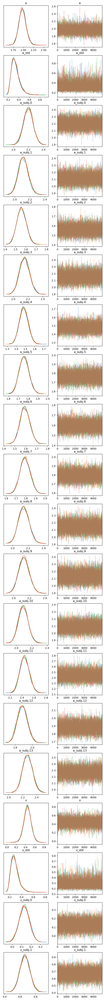

In [4]:
tmp_infdata = m0_infdata
plt.rc('font', size=16)

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 70])

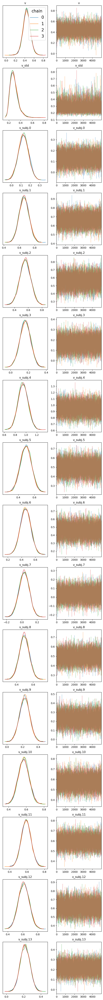

In [5]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 70]
)

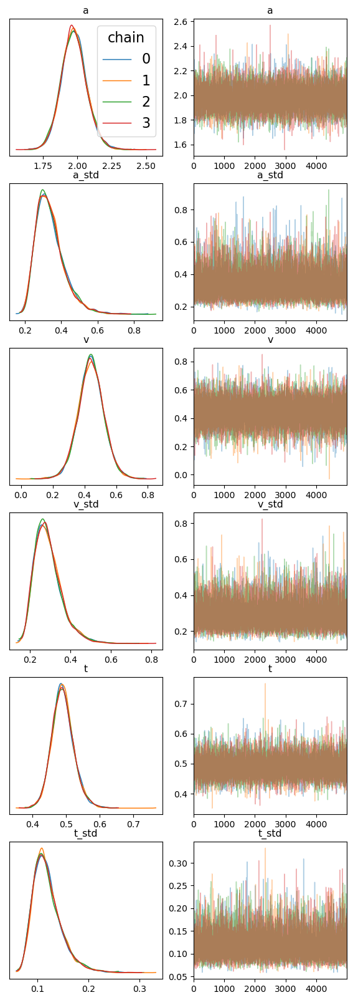

In [6]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 20]
)

#### $\hat{R}$ and ESS

In [7]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
a_subj.1,0.0007,0.0005,9362.9923,11146.5634,1.0007
a_subj.13,0.0007,0.0005,9427.5013,12101.8288,1.0007
t_subj.0,0.0003,0.0002,10616.9907,10178.4367,1.0006
a_subj.12,0.0006,0.0004,9998.5546,13086.6877,1.0006
t_subj.13,0.0003,0.0002,9017.6369,12678.2949,1.0005
t_subj.12,0.0001,0.0001,10723.8369,13061.9596,1.0005
t_subj.10,0.0002,0.0001,9949.1554,11627.7933,1.0005
t_subj.6,0.0001,0.0001,9902.0905,12040.2314,1.0005
a_subj.10,0.0006,0.0005,9741.6959,12208.0920,1.0004
t_subj.3,0.0003,0.0002,8774.3594,11246.2228,1.0004


In [8]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/48)
    a          float64 1.0
    a_std      float64 1.0
    a_subj.0   float64 1.0
    a_subj.1   float64 1.001
    a_subj.2   float64 1.0
    a_subj.3   float64 1.0
    ...         ...
    t_subj.8   float64 1.0
    t_subj.9   float64 1.0
    t_subj.10  float64 1.0
    t_subj.11  float64 1.0
    t_subj.12  float64 1.001
    t_subj.13  float64 1.001>

In [9]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/48)
    a          float64 1.588e+04
    a_std      float64 1.026e+04
    a_subj.0   float64 1.063e+04
    a_subj.1   float64 9.363e+03
    a_subj.2   float64 9.635e+03
    a_subj.3   float64 9.129e+03
    ...         ...
    t_subj.8   float64 1.006e+04
    t_subj.9   float64 1.127e+04
    t_subj.10  float64 9.949e+03
    t_subj.11  float64 8.567e+03
    t_subj.12  float64 1.072e+04
    t_subj.13  float64 9.018e+03>

### Diagnosis of Model 1

#### Trace plot

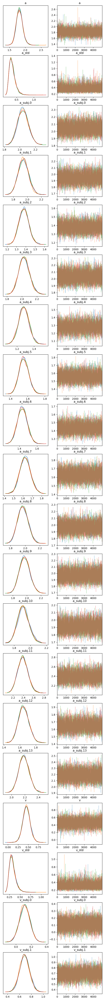

In [10]:
tmp_infdata = m1_infdata

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 70])

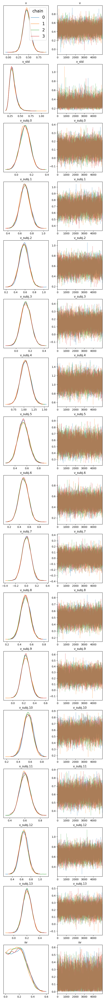

In [11]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 70]
)

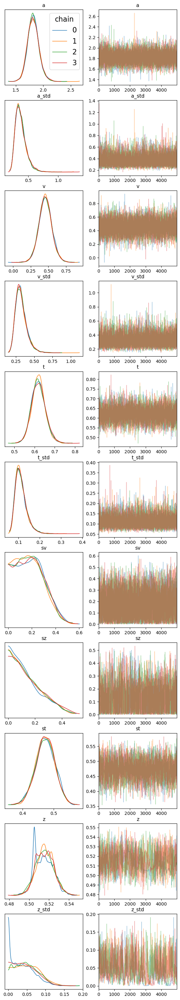

In [12]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

#### $\hat{R}$ and ESS

In [13]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_std,0.0027,0.0019,79.2361,121.3974,1.0513
z_subj.10,0.0017,0.0012,92.2132,1357.6492,1.0374
z_subj.1,0.0009,0.0007,214.4135,3541.5471,1.0210
z,0.0005,0.0003,346.1532,1494.6253,1.0196
z_subj.12,0.0006,0.0004,420.1687,3343.2970,1.0169
z_subj.8,0.0007,0.0005,322.8745,3527.8657,1.0168
z_subj.2,0.0006,0.0004,538.7726,3327.8136,1.0160
z_subj.9,0.0005,0.0003,940.1582,2171.5533,1.0145
z_subj.5,0.0005,0.0004,800.7271,2276.4475,1.0133
z_subj.4,0.0005,0.0004,779.6894,4214.4530,1.0122


In [14]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/67)
    a          float64 1.0
    a_std      float64 1.001
    a_subj.0   float64 1.001
    a_subj.1   float64 1.001
    a_subj.2   float64 1.001
    a_subj.3   float64 1.001
    ...         ...
    z_subj.8   float64 1.017
    z_subj.9   float64 1.015
    z_subj.10  float64 1.037
    z_subj.11  float64 1.009
    z_subj.12  float64 1.017
    z_subj.13  float64 1.01>

In [15]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/67)
    a          float64 1.039e+04
    a_std      float64 8.578e+03
    a_subj.0   float64 4.847e+03
    a_subj.1   float64 4.189e+03
    a_subj.2   float64 4.332e+03
    a_subj.3   float64 6.841e+03
    ...         ...
    z_subj.8   float64 322.9
    z_subj.9   float64 940.2
    z_subj.10  float64 92.21
    z_subj.11  float64 771.2
    z_subj.12  float64 420.2
    z_subj.13  float64 736.1>

### Diagnosis of Model 2

#### Trace plot

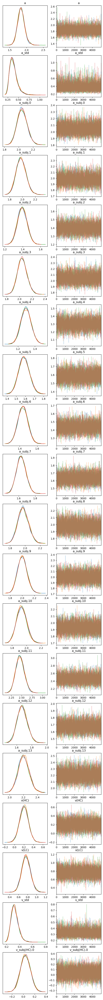

In [16]:
tmp_infdata = m2_infdata

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 70])

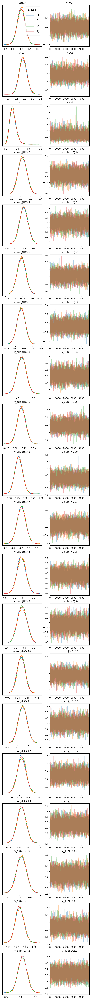

In [17]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 80]
)

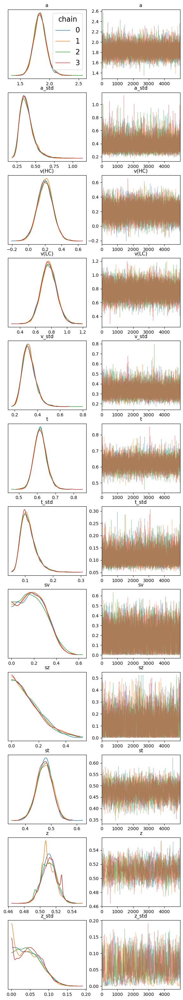

In [18]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

#### $\hat{R}$ and ESS

In [19]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_std,0.0016,0.0012,286.3163,237.7356,1.0286
z_subj.10,0.0007,0.0005,555.9742,532.9274,1.0166
z_subj.6,0.0004,0.0003,1088.6795,951.1604,1.0104
z_subj.9,0.0005,0.0004,863.8327,438.3387,1.0101
z_subj.7,0.0004,0.0003,1181.1222,4569.6562,1.0097
z,0.0004,0.0003,619.1078,714.0254,1.0090
z_subj.5,0.0005,0.0004,847.5444,442.6492,1.0086
z_subj.12,0.0004,0.0003,1055.0849,3573.6991,1.0066
z_subj.0,0.0004,0.0003,1261.1328,5393.1678,1.0066
z_subj.1,0.0005,0.0003,1064.0983,1869.2584,1.0064


In [20]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:        ()
Data variables: (12/82)
    a              float64 1.001
    a_std          float64 1.0
    a_subj.0       float64 1.001
    a_subj.1       float64 1.001
    a_subj.2       float64 1.0
    a_subj.3       float64 1.0
    ...             ...
    z_subj.8       float64 1.006
    z_subj.9       float64 1.01
    z_subj.10      float64 1.017
    z_subj.11      float64 1.006
    z_subj.12      float64 1.007
    z_subj.13      float64 1.004>

In [21]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:        ()
Data variables: (12/82)
    a              float64 1.053e+04
    a_std          float64 9.599e+03
    a_subj.0       float64 5.544e+03
    a_subj.1       float64 4.46e+03
    a_subj.2       float64 5.124e+03
    a_subj.3       float64 6.213e+03
    ...             ...
    z_subj.8       float64 1.133e+03
    z_subj.9       float64 863.8
    z_subj.10      float64 556.0
    z_subj.11      float64 1.317e+03
    z_subj.12      float64 1.055e+03
    z_subj.13      float64 1.313e+03>

### Diagnosis of Model 3

#### Trace plot

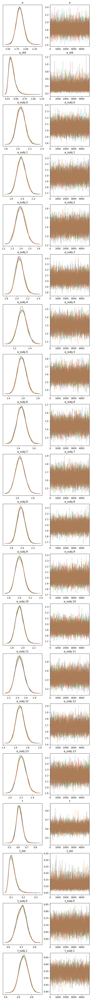

In [22]:
tmp_infdata = m3_infdata

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 80])

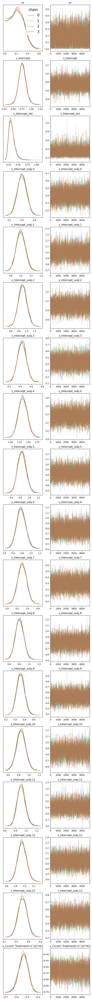

In [23]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 80]
)

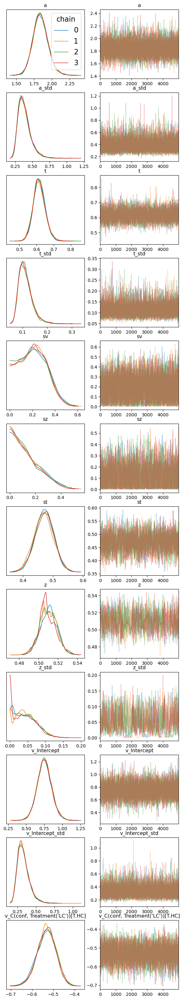

In [24]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

#### $\hat{R}$ and ESS

In [25]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_subj.5,0.0005,0.0003,1023.3599,2021.3376,1.0129
z_subj.9,0.0004,0.0003,1084.4583,2102.0688,1.0096
z_subj.6,0.0004,0.0003,1235.2185,2232.3897,1.0094
z_std,0.0018,0.0012,211.9374,102.0050,1.0084
z_subj.7,0.0003,0.0002,1425.2647,2709.3507,1.0064
z_subj.0,0.0003,0.0002,1458.4987,2839.4730,1.0052
z_subj.10,0.0007,0.0005,543.0214,1225.3230,1.0049
z_subj.11,0.0003,0.0002,1633.8084,3683.2418,1.0048
z,0.0003,0.0002,730.1900,1634.4699,1.0043
z_subj.3,0.0003,0.0002,1621.4315,4212.0873,1.0043


In [26]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                           ()
Data variables: (12/68)
    a                                 float64 1.0
    a_std                             float64 1.0
    a_subj.0                          float64 1.001
    a_subj.1                          float64 1.001
    a_subj.2                          float64 1.001
    a_subj.3                          float64 1.001
    ...                                ...
    v_Intercept_subj.9                float64 1.0
    v_Intercept_subj.10               float64 1.001
    v_Intercept_subj.11               float64 1.001
    v_Intercept_subj.12               float64 1.0
    v_Intercept_subj.13               float64 1.001
    v_C(conf, Treatment('LC'))[T.HC]  float64 1.001>

In [27]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                           ()
Data variables: (12/68)
    a                                 float64 1.076e+04
    a_std                             float64 9.031e+03
    a_subj.0                          float64 5.546e+03
    a_subj.1                          float64 4.147e+03
    a_subj.2                          float64 4.33e+03
    a_subj.3                          float64 5.973e+03
    ...                                ...
    v_Intercept_subj.9                float64 4.979e+03
    v_Intercept_subj.10               float64 2.172e+03
    v_Intercept_subj.11               float64 3.052e+03
    v_Intercept_subj.12               float64 4.233e+03
    v_Intercept_subj.13               float64 4.435e+03
    v_C(conf, Treatment('LC'))[T.HC]  float64 2.705e+03>

### Diagnosis of Model 4

#### Trace plot

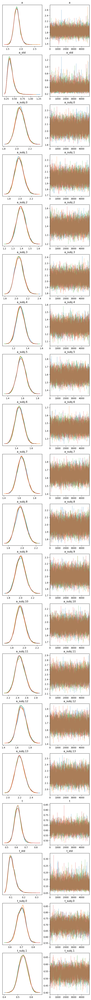

In [28]:
# plot traces for all parameters
axes = az.plot_trace(m4_infdata, compact = False, figsize = [7, 80])

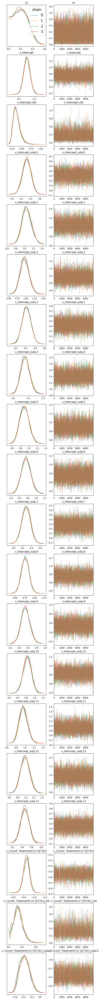

In [29]:
# select parameter v as a example
axes = az.plot_trace(
    m4_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 80]
)

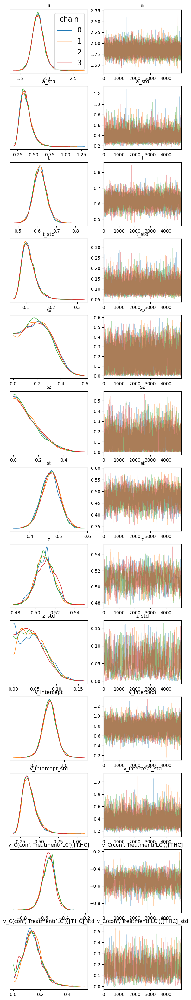

In [30]:
# select group level parameters
axes = az.plot_trace(
    m4_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

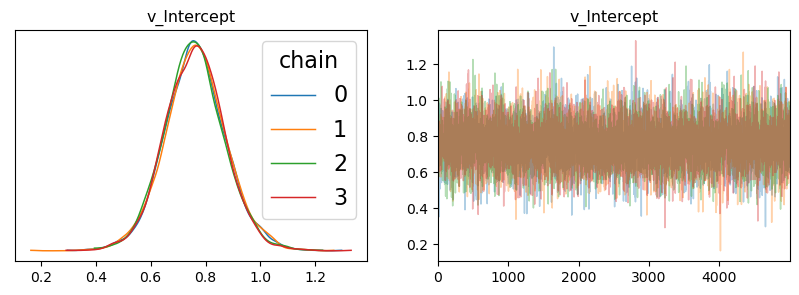

In [31]:
# plot example for main text
axes = az.plot_trace(m4_infdata, var_names=["v_Intercept"], compact = False, legend=True, figsize = [10, 3])

In [33]:
axes.ravel()[0].figure.savefig("fig6a.pdf")

#### $\hat{R}$ and ESS

In [34]:
summary_tmp = az.summary(m4_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_std,0.0015,0.0010,288.7938,186.1858,1.0131
z,0.0004,0.0003,591.7768,1104.2424,1.0109
"v_C(conf, Treatment('LC'))[T.HC]_std",0.0022,0.0015,818.0575,478.8674,1.0097
z_subj.13,0.0003,0.0002,1390.5568,4158.0897,1.0078
z_subj.3,0.0004,0.0003,1408.1738,4847.9206,1.0075
z_subj.8,0.0004,0.0003,1384.8352,2667.8497,1.0066
z_subj.7,0.0004,0.0003,1138.0935,5519.5289,1.0062
t_subj.6,0.0006,0.0004,2236.9672,4173.7820,1.0061
st,0.0008,0.0006,1451.8200,3031.8223,1.0061
z_subj.2,0.0004,0.0003,1426.6899,2691.6767,1.0058


In [35]:
# only calculate R hat
az.rhat(m4_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                                   ()
Data variables: (12/83)
    a                                         float64 1.0
    a_std                                     float64 1.0
    a_subj.0                                  float64 1.001
    a_subj.1                                  float64 1.0
    a_subj.2                                  float64 1.002
    a_subj.3                                  float64 1.0
    ...                                        ...
    v_C(conf, Treatment('LC'))[T.HC]_subj.8   float64 1.001
    v_C(conf, Treatment('LC'))[T.HC]_subj.9   float64 1.002
    v_C(conf, Treatment('LC'))[T.HC]_subj.10  float64 1.002
    v_C(conf, Treatment('LC'))[T.HC]_subj.11  float64 1.004
    v_C(conf, Treatment('LC'))[T.HC]_subj.12  float64 1.002
    v_C(conf, Treatment('LC'))[T.HC]_subj.13  float64 1.002>

In [36]:
# only calculate ESS
az.ess(m4_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                                   ()
Data variables: (12/83)
    a                                         float64 1.142e+04
    a_std                                     float64 8.965e+03
    a_subj.0                                  float64 5.715e+03
    a_subj.1                                  float64 4.995e+03
    a_subj.2                                  float64 3.996e+03
    a_subj.3                                  float64 6.018e+03
    ...                                        ...
    v_C(conf, Treatment('LC'))[T.HC]_subj.8   float64 2.675e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.9   float64 4.318e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.10  float64 3.938e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.11  float64 2.321e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.12  float64 3.444e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.13  float64 2.918e+03>

Since `z_subj.10` and `z_std` both have $\hat{R}$ > 1.01 and `z_std` have ESS bulk < 400, we double-check these two parameters with a trace plot.

- In terms of the posterior distribution, 'z_subj.10' and 'z_std' differ in the consistency of convergence of the four chains and their hdi (highest density interval).
- Since the 'z_std' obeys the truncate distribution, its mean and mode are clustered around 0
- However, from the trace plot, it is clear that 'z_std' has non-converge feature in chain 2 (the long regions of monotonicity like a line parallel to the x-axis).
    - (see 2.4 Diagnosing Numerical Inference in Martin, O.A., et. cl (2021) Bayseian Modeling and Computation in Python).

However, in general, the $\hat{R}$ of the two parameters is close to 1.01, and more broadly speaking, less than 1.1. And the distribution of the chains is still stable and consistent, we think this result is acceptable.

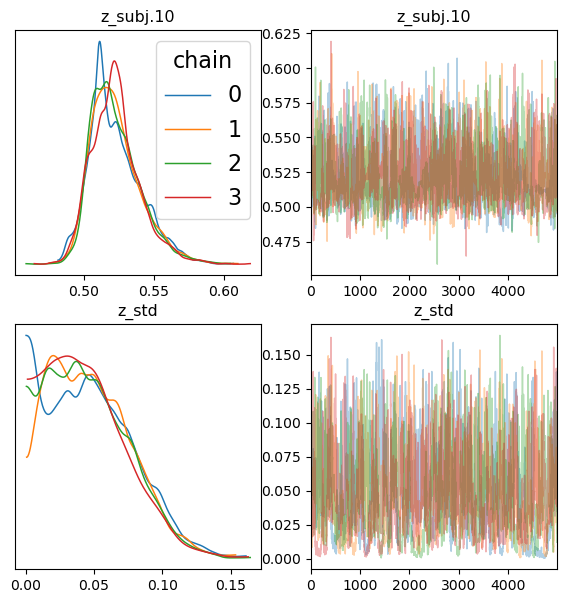

In [37]:
# select `z_subj.10` and `z_std`
axes = az.plot_trace(
    m4_infdata, 
    var_names=['z_subj.10', 'z_std'], 
    compact = False, 
    legend=True, 
    figsize = [7, 7]
)

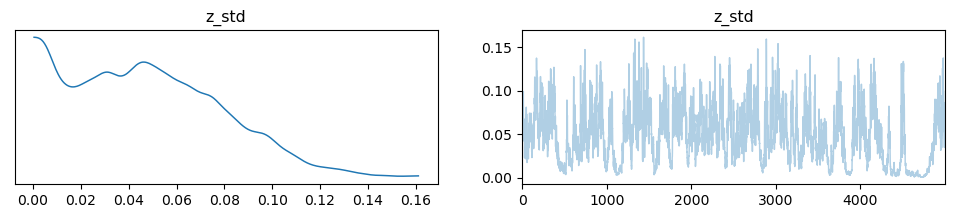

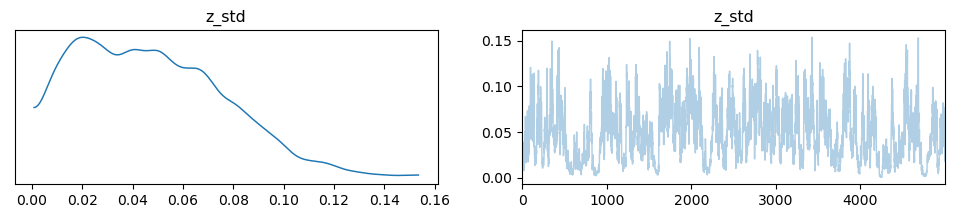

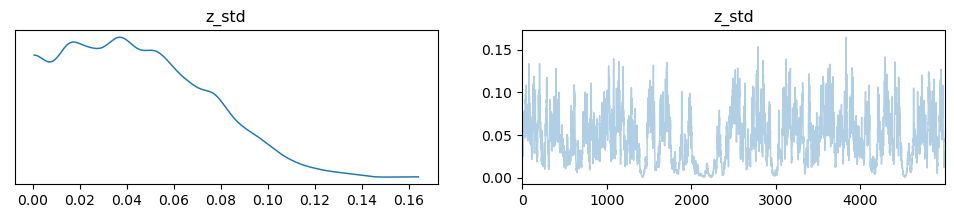

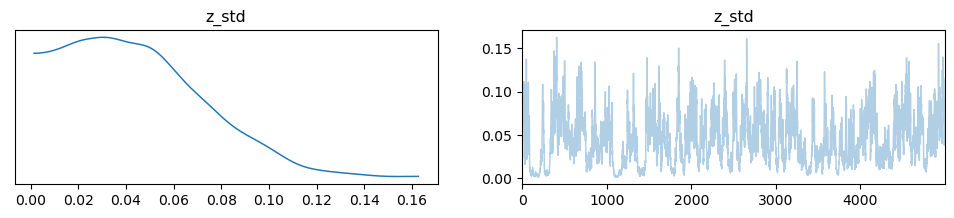

In [38]:
for i in range(4):
    
    az.plot_trace(
        m4_infdata, 
        var_names=['z_std'], 
        coords = {'chain': [i]}, 
        compact = False, 
        combined = False
    )

## Model comparison and selection

### DIC

Here we record the DIC of each model in the models and sort by DIC.

In [39]:
dic_dict = {
  "m0":m0.dic,
  "m1":m1.dic,
  "m2":m2.dic,
  "m3":m3.dic,
  "m4":m4.dic
}

comp_dic = pd.DataFrame.from_dict(dic_dict, orient='index', columns=['DIC'])
comp_dic['model'] = comp_dic.index
comp_dic = comp_dic[['model', 'DIC']]
comp_dic.sort_values(by=['DIC'], ascending = True)

,model,DIC
m2,m2,10654.319486
m4,m4,10655.724819
m3,m3,10661.112889
m1,m1,10837.398107
m0,m0,10973.867116


### PSIS-LOO-CV

Take few hours to calculate the pointwise log-likelihood. 

In [40]:
%%time
m0_infdata = m0.to_infdata(loglike = True, save_name = "model_fitted/m0")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood took 74.122 seconds
Start converting to InferenceData...
CPU times: user 1min 31s, sys: 7.97 s, total: 1min 39s
Wall time: 1min 52s


In [41]:
%%time
m1_infdata = m1.to_infdata(loglike = True, save_name = "model_fitted/m1")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood took 125.581 seconds
Start converting to InferenceData...
CPU times: user 1min 32s, sys: 6 s, total: 1min 38s
Wall time: 2min 43s


In [42]:
%%time
m2_infdata = m2.to_infdata(loglike = True, save_name = "model_fitted/m2")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood took 143.474 seconds
Start converting to InferenceData...
CPU times: user 1min 36s, sys: 5.67 s, total: 1min 42s
Wall time: 3min 1s


In [43]:
%%time
m3_infdata = m3.to_infdata(loglike = True, save_name = "model_fitted/m3")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood took 1810.343 seconds
Start converting to InferenceData...
CPU times: user 1min 43s, sys: 8.3 s, total: 1min 52s
Wall time: 30min 56s


In [44]:
%%time
m4_infdata = m4.to_infdata(loglike = True, save_name = "model_fitted/m4")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood took 1796.850 seconds
Start converting to InferenceData...
CPU times: user 1min 40s, sys: 6.96 s, total: 1min 47s
Wall time: 30min 41s


Warining here is caused by large number as input of `exp()`, solution is [here](https://stackoverflow.com/questions/40726490/overflow-error-in-pythons-numpy-exp-function).

In [45]:
compare_dict = {
  "m0":m0_infdata,
  "m1":m1_infdata,
  "m2":m2_infdata,
  "m3":m3_infdata,
  "m4":m4_infdata
}

In [46]:
comp_loo = az.compare(compare_dict, ic='loo', scale="deviance")
comp_loo

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invalid value encountered in true_divide
  sigma = -k_post / b_post
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invali

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1069: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)


/opt/conda/lib/python3.8/site-packages/numpy/core/_methods.py:48: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
m4,0,15848.044584,2519.347628,0.00000,0.2,2281.184291,0.000000,True,deviance
m3,1,15869.456224,2520.184743,21.41164,0.2,2286.699186,74.737595,True,deviance
m0,2,NaN,NaN,NaN,0.2,NaN,NaN,True,deviance
m1,3,NaN,NaN,NaN,0.2,NaN,NaN,True,deviance
m2,4,NaN,NaN,NaN,0.2,NaN,NaN,True,deviance


####  WAIC

In [47]:
comp_waic = az.compare(compare_dict, ic='waic', scale="deviance")
comp_waic

,rank,elpd_waic,p_waic,elpd_diff,weight,se,dse,warning,scale
m4,0,23892.037588,6541.344130,0.000000,5.144840e-01,6735.686600,0.000000,True,deviance
m3,1,24204.689573,6687.801417,312.651985,3.469460e-11,7086.182788,569.026230,True,deviance
m2,2,24835.344635,7018.498535,943.307047,2.860346e-01,7399.691052,840.148375,True,deviance
m1,3,25558.990980,7278.752930,1666.953392,4.083449e-11,7551.391956,1073.579984,True,deviance
m0,4,76742.780438,32855.226562,52850.742851,1.994813e-01,23956.057374,24793.362794,True,deviance


### PSIS issues
**Warnings**: Now that we found $\hat{k} >  0.7$, which means importance sampling (PSIS) is not able to provide useful estimate for that component/observation. Highly influential observations have high $\hat{k}$ values. Very high $\hat{k}$ values often indicate model misspecification, outliers or mistakes in data processing.

Also, `p_loo`is large than *p*, which is number of parameters of the model. Large `p_loo` means the model is badly misspecified according to Aki Vehtari's [Q & A](https://avehtari.github.io/modelselection/CV-FAQ.html#18_What_is_the_interpretation_of_p_loo). For all models, the *N*, number of obersvations, is 3988, and the number of parameters varies from 48 to 83. Thus, `p_loo` is much larger than numbers of parameters for all models.

As we can from below, this was primarily because of a few outliers. As HDDM allow for 5 percent of outliers in modelling, it is not surprising that these outliers stronly influenced the model performance. Here, we remove the outliers from all models and check the results again.

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1069: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)


CPU times: user 1min 8s, sys: 1.06 s, total: 1min 9s
Wall time: 1min 9s


<AxesSubplot: title={'center': 'm3 - m4'}, ylabel='ELPD difference'>

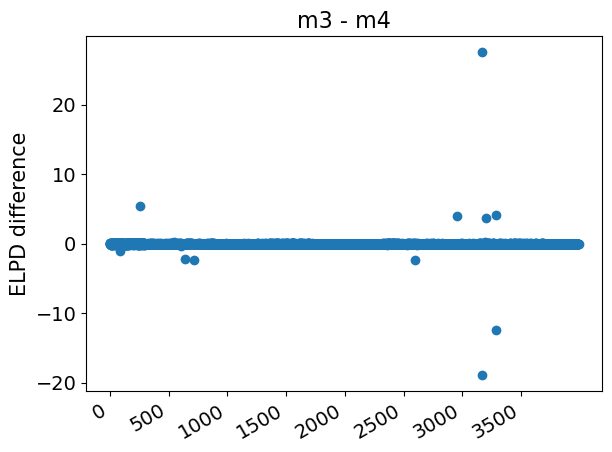

In [64]:
%%time
az.plot_elpd({"m3": m3_infdata, "m4": m4_infdata}, xlabels=True)

Below we visulaize the `k_hat` of each data point.

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)


CPU times: user 11.4 s, sys: 144 ms, total: 11.5 s
Wall time: 11.5 s


<AxesSubplot: xlabel='Data Point', ylabel='Shape parameter k'>

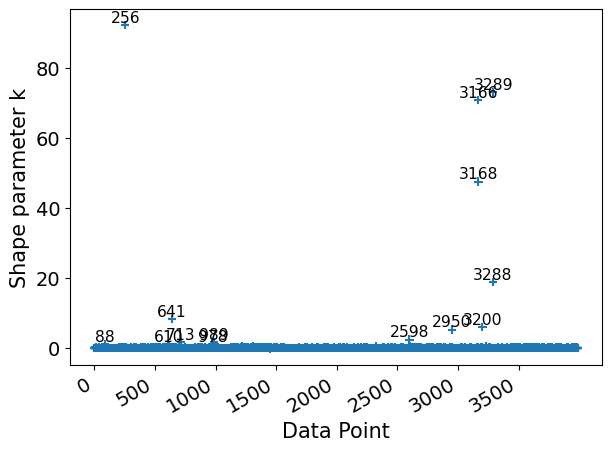

In [65]:
%%time
khats = az.loo(m4_infdata, pointwise=True).pareto_k

az.plot_khat(khats, xlabels=True, threshold=0.7)

Here we used a very simple soluation: removing the outliers and re-calculate the `loo` and `waic`.

In [66]:
%%time
loo_m0 = az.loo(m0_infdata, pointwise=True)
loo_m1 = az.loo(m1_infdata, pointwise=True)
loo_m2 = az.loo(m2_infdata, pointwise=True)
loo_m3 = az.loo(m3_infdata, pointwise=True)
loo_m4 = az.loo(m4_infdata, pointwise=True)

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invalid value encountered in true_divide
  sigma = -k_post / b_post
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invali

CPU times: user 56 s, sys: 404 ms, total: 56.4 s
Wall time: 56.4 s


In [70]:
outliers0 = loo_m0.pareto_k.where(loo_m0.pareto_k >= 0.7, drop= True).obs_id.values
outliers1 = loo_m1.pareto_k.where(loo_m1.pareto_k >= 0.7, drop= True).obs_id.values
outliers2 = loo_m2.pareto_k.where(loo_m2.pareto_k >= 0.7, drop= True).obs_id.values
outliers3 = loo_m3.pareto_k.where(loo_m3.pareto_k >= 0.7, drop= True).obs_id.values
outliers4 = loo_m4.pareto_k.where(loo_m4.pareto_k >= 0.7, drop= True).obs_id.values

# create a index array to remove outliers
outliers = np.unique(np.concatenate((outliers0, outliers1, outliers2, outliers3, outliers4), axis=0))
new_indx = data_cavanagh.index.values[~np.isin(data_cavanagh.index.values, outliers)]

In [71]:
%%time
m0_infdata = m0_infdata.isel(obs_id=new_indx)
m1_infdata = m1_infdata.isel(obs_id=new_indx)
m2_infdata = m2_infdata.isel(obs_id=new_indx)
m3_infdata = m3_infdata.isel(obs_id=new_indx)
m4_infdata = m4_infdata.isel(obs_id=new_indx)

CPU times: user 2min 6s, sys: 4.79 s, total: 2min 11s
Wall time: 2min 11s


In [72]:
compare_dict2 = {
  "m0":m0_infdata,
  "m1":m1_infdata,
  "m2":m2_infdata,
  "m3":m3_infdata,
  "m4":m4_infdata
}

In [73]:
comp_loo2 = az.compare(compare_dict2, ic='loo', scale="deviance")
comp_loo2

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invalid value encountered in true_divide
  sigma = -k_post / b_post
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invalid value encountered in true_divide
  sigma = -k_post / b_post


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
m4,0,10741.815417,53.783092,0.000000,0.2,124.222386,0.000000,False,deviance
m2,1,10742.861425,58.964879,1.046008,0.2,124.080713,5.982290,False,deviance
m3,2,10745.888427,46.116561,4.073010,0.2,124.172039,4.771798,False,deviance
m0,3,NaN,NaN,NaN,0.2,NaN,NaN,False,deviance
m1,4,NaN,NaN,NaN,0.2,NaN,NaN,False,deviance


In [74]:
comp_waic2 = az.compare(compare_dict2, ic='waic', scale="deviance")
comp_waic2

,rank,elpd_waic,p_waic,elpd_diff,weight,se,dse,warning,scale
m4,0,10741.640988,53.695878,0.000000,2.077790e-12,124.218389,0.000000,False,deviance
m2,1,10742.657183,58.862755,1.016194,5.659531e-01,124.075873,5.982366,False,deviance
m3,2,10745.692339,46.018517,4.051350,2.674425e-01,124.167511,4.771424,False,deviance
m1,3,10923.353661,45.486771,181.712672,2.509488e-12,121.368885,28.225753,True,deviance
m0,4,27913.508206,8503.059570,17171.867218,1.666044e-01,12412.580616,12405.994784,True,deviance


warning: using `az.loo_pit` requires same shape for  y_hat and log_weights, which is not the case if the PPC samples is not the same as the sample of MCMC.

In [ ]:
# az.loo_pit(idata=InfData['m0'], y="rt") 

## Posterior predictive check

First, let's spend some time generating posterior predictions. Note that we set `n_ppc` is 500 means we generate 500 samples for each draws in each parameters. 

In [48]:
%%time
m0_infdata = m0.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m0")
m1_infdata = m1.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m1")
m2_infdata = m2.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m2")
m3_infdata = m3.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m3")
m4_infdata = m4.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m4")

The time of calculation of loglikelihood took 0.000 seconds
Start generating posterior prediction...
The time of generating PPC took 96.117 seconds
Start converting to InferenceData...
The time of calculation of loglikelihood took 0.000 seconds
Start generating posterior prediction...
The time of generating PPC took 297.219 seconds
Start converting to InferenceData...
The time of calculation of loglikelihood took 0.000 seconds
Start generating posterior prediction...
The time of generating PPC took 567.302 seconds
Start converting to InferenceData...
The time of calculation of loglikelihood took 0.000 seconds
Start generating posterior prediction...
The time of generating PPC took 3255.117 seconds
Start converting to InferenceData...
The time of calculation of loglikelihood took 0.000 seconds
Start generating posterior prediction...
The time of generating PPC took 3278.369 seconds
Start converting to InferenceData...
CPU times: user 7min 53s, sys: 43.7 s, total: 8min 37s
Wall time: 2h 

Then, we can plot the ppc by setting different coordinates. 

- Here we demonstrate plotting both the individual leve, `subj_idx` is 3, 11
- and the experimental condition level, `conf` is LC and HC. 

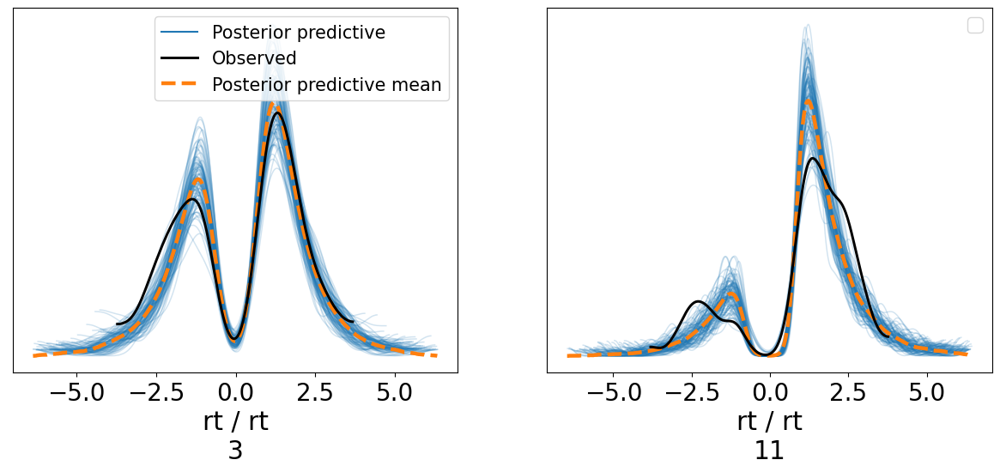

In [49]:
# reset coordinates
m0_infdata = m0_infdata.assign_coords(
  obs_id=m0_infdata.observed_data.coords['subj_idx'].values, 
  groups="observed_vars")

# plot ppc for subj_idx (obs_id) is 0,1,2 and 3
axes = az.plot_ppc(
    m0_infdata, 
    var_names= 'rt', 
    coords={'obs_id': [3,11]}, 
    num_pp_samples=100,
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [50]:
axes.ravel()[0].figure.savefig("fig7a1.pdf")

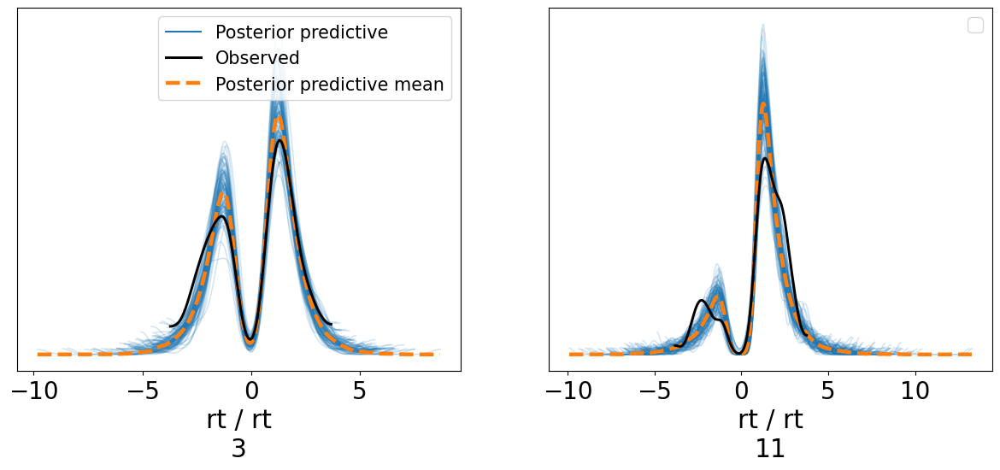

In [51]:
# reset coordinates
m4_infdata = m4_infdata.assign_coords(
  obs_id=m4_infdata.observed_data.coords['subj_idx'].values, 
  groups="observed_vars")

# plot ppc for subj_idx (obs_id) is 0,1,2 and 3
axes = az.plot_ppc(
    m4_infdata, 
    var_names= 'rt', 
    coords={'obs_id': [3, 11]}, 
    num_pp_samples=100, 
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [52]:
axes.ravel()[0].figure.savefig("fig7a2.pdf")

It is found that model 4 generate more similar predictions to observed data, especially for subject 11. 

Then, let us plot ppc on different conditions. 

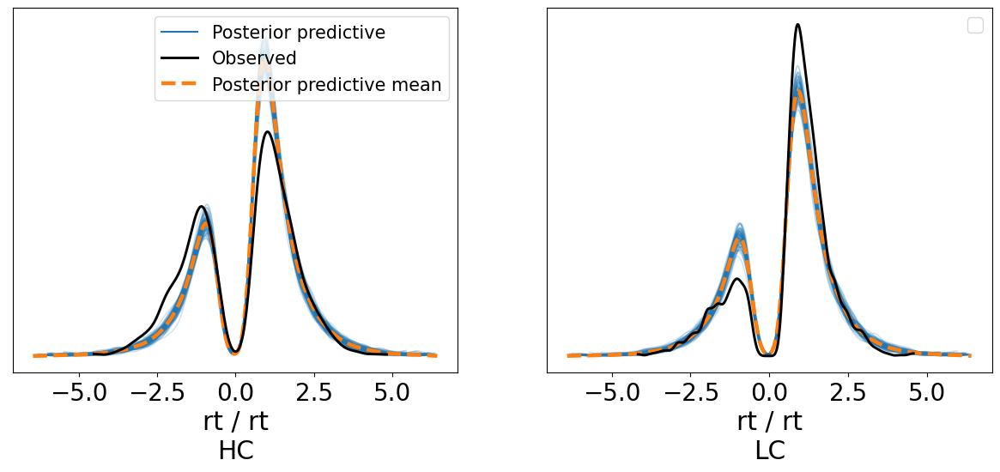

In [53]:
# reset coordinates
m0_infdata = m0_infdata.assign_coords(
  obs_id=m0_infdata.observed_data.variables['conf'].values, 
  groups="observed_vars")


# plot ppc by conditions
axes = az.plot_ppc(
    m0_infdata, 
    var_names= 'rt', 
    coords={'obs_id': ["LC", "HC"]}, 
    num_pp_samples=100, 
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [54]:
axes.ravel()[0].figure.savefig("fig7b1.pdf")

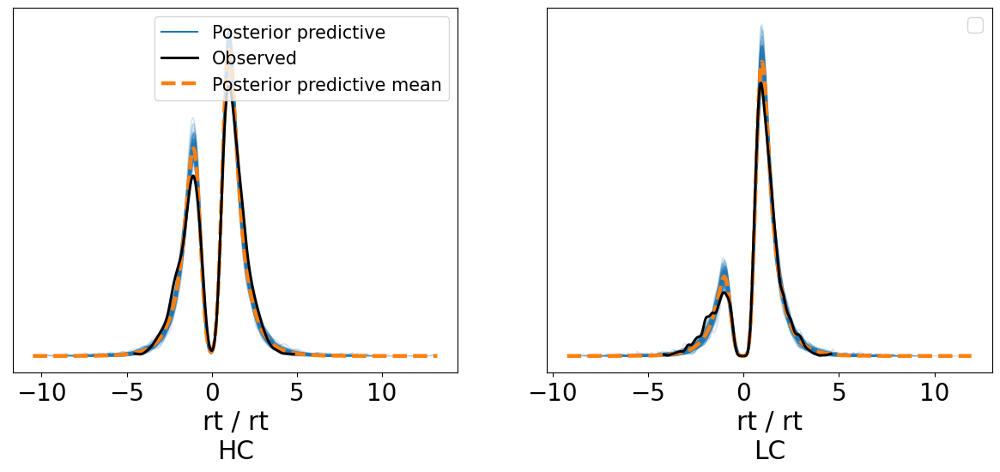

In [55]:
# reset coordinates
m4_infdata = m4_infdata.assign_coords(
  obs_id=m4_infdata.observed_data.variables['conf'].values, 
  groups="observed_vars")


# plot ppc by conditions
axes = az.plot_ppc(
    m4_infdata, 
    var_names= 'rt', 
    coords={'obs_id': ["LC", "HC"]}, 
    num_pp_samples=100, 
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [56]:
axes.ravel()[0].figure.savefig("fig7b2.pdf")

Model 4 get better predictions for both conflict condition (LC vs. HC), given that model 0 did not consider the impact from conflict condition. 

## Statistical Inference

Here we onlyu examplified how to us ROPE + HDI method. 

- Assume that we are interested in the effect of conflit level on drift rate `v` and we used [-0.2, 0.2] as the ROPE. 
- Then we can used visualize the ROPE and HDI with `az.plot_posterior()`.

(-0.9, 0.3)

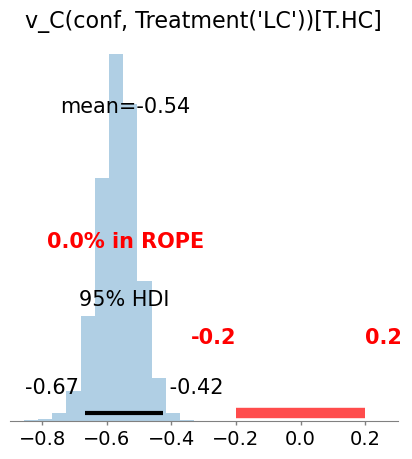

In [57]:
# using regex to select var_names that start with "a_theta" and do not contain either "subj" or "std"
axes = az.plot_posterior(
    m4_infdata,
    var_names=("v_C(conf, Treatment('LC'))[T.HC]"),
    kind = 'hist',
    hdi_prob = 0.95,
    rope = [-0.2, 0.2], # assume this is our ROPE
    textsize=14, 
    rope_color = 'r',
    figsize = (5,5)
)
axes.set_xlim(-0.9,0.3)

In [58]:
axes.figure.savefig("fig8a.pdf")

It is easy to find that the drift rate in HC is lower than it in LC. 

Then we plot the posteriors distribution of drift rates in both condition to reaffirm this results. 

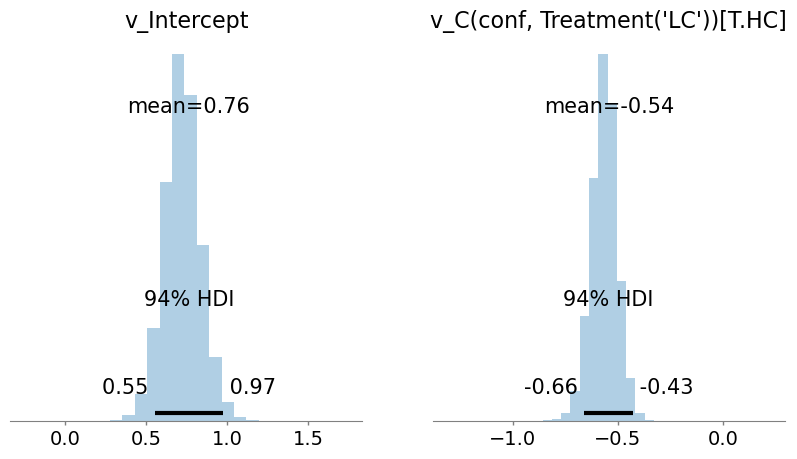

In [59]:
# plot posterior histgram by conditions, 
# v_Intercept represent v in LC 
# and v_C(conf, Treatment('LC'))[T.HC] represent v in HC. 
axes = az.plot_posterior(
    m4_infdata, 
    var_names=("^v(?!.*(subj|std))"), 
    filter_vars='regex', 
    kind='hist',
    figsize = (10,5)
)

In [60]:
m4_infdata.posterior["v_HC"] = (
    ("chain", "draw"),
    m4_infdata.posterior["v_Intercept"].values + \
    m4_infdata.posterior["v_C(conf, Treatment('LC'))[T.HC]"].values)
m4_infdata.posterior["v_LC"] = (
    ("chain", "draw"),
    m4_infdata.posterior["v_Intercept"].values)

Compare posterior using plot_forest. See [`az.plot_forest`](https://python.arviz.org/en/latest/api/generated/arviz.plot_forest.html#arviz.plot_forest) for more.

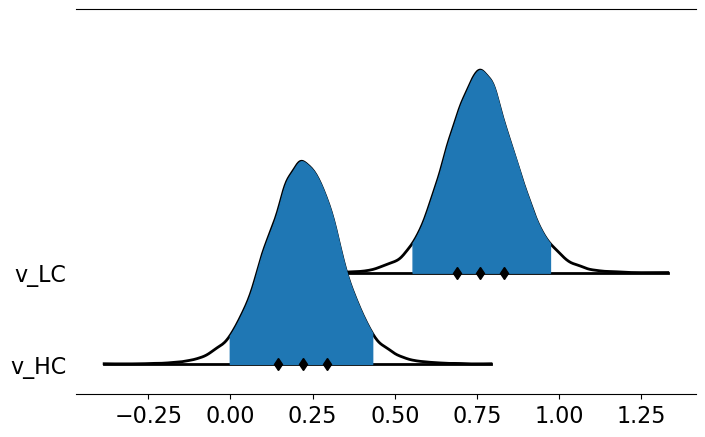

In [61]:
 # plot posterior forest distriution by conditions
axes = az.plot_forest(
    m4_infdata,
    kind='ridgeplot',
    var_names=("v_LC", "v_HC"), 
    linewidth=2,
    ridgeplot_overlap=3,
    ridgeplot_truncate=False,
    ridgeplot_quantiles=[.25, .5, .75],
    combined=True,
    figsize=(8, 5)
 )

Similarly, violin plot can also be used:

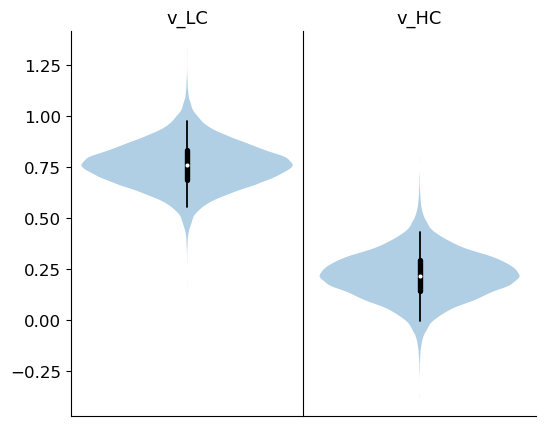

In [62]:
import seaborn as sns
# plot posterior violin plot by conditions
axes = az.plot_violin(
    m4_infdata, 
    var_names=("v_LC", "v_HC"), 
    figsize=(6, 5),
    textsize=12
)

sns.despine()

In [63]:
axes.ravel()[0].figure.savefig("fig8b.pdf")